In [1]:
import pandas as pd
#pd.set_option('display.max_rows', None)
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib import path
import os
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
import numpy as np
import netCDF4 as nc
np.set_printoptions(threshold=100000)
from shapely.geometry import Polygon, Point, MultiPoint
from shapely.ops import cascaded_union
from datetime import datetime, timedelta
import time
import warnings
import datetime
import math
from scipy.ndimage.interpolation import shift
import shapely.wkt
from scipy.stats import pearsonr,spearmanr,kendalltau
from scipy.optimize import curve_fit 

warnings.filterwarnings('ignore')
import seaborn as sns
sns.set(font_scale=1.4) 
from my_functions import sat_vap_press, vap_press, hot_dry_windy, haines
from os.path import exists

from sklearn.linear_model import Ridge, LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance

from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_log_error
from sklearn.feature_selection import RFE
from sklearn.model_selection import TimeSeriesSplit, cross_val_score, cross_validate, GridSearchCV

# Helper Functions

In [2]:
def shift_ndays(df_to_shift,ndays,name_col_to_shift, name_shifted_col, time_col):
    df_shifted = resample_daily(df_to_shift, time_col)
    for ii in range(len(name_shifted_col)):
        df_shifted[name_shifted_col[ii]] = df_shifted[name_col_to_shift[ii]].shift(ndays)
    return df_shifted

In [3]:
def plot_correlations(df_all, fig_title,correlation_type):
    #make the correlation matrix
    corrMatrix = df_all.corr(method=correlation_type)
    
    #plot it
    fig,ax=plt.subplots(figsize=(25,25))
    sns.heatmap(corrMatrix, annot=True,vmin=-1, vmax=1, cmap='seismic', annot_kws={'fontsize':23})
    plt.title(fig_title, fontsize=20)
    plt.show()

In [4]:
def plot_importances(forest, varnames,plot_title):
    tree_indices = np.arange(0, len(forest.feature_importances_)) + 0.5
    importances = forest.feature_importances_
    std = np.std([tree.feature_importances_ for tree in forest.estimators_], axis=0)
    fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
    ax1.barh(tree_indices, forest.feature_importances_, height=0.7,xerr = std)
    ax1.set_yticks(tree_indices)
    ax1.set_yticklabels(varnames)
    ax1.set_ylim((0, len(forest.feature_importances_)))
    fig.tight_layout()
    plt.title(plot_title)
    plt.show()

In [5]:
def resample_daily(df_nondaily, time_name):
    df_nondaily['datetime'] = pd.to_datetime(df_nondaily[time_name])
    df_nondaily = df_nondaily.set_index(['datetime'])
    df_daily = df_nondaily.resample('D').asfreq()
    df_daily = df_daily.reset_index()
    return df_daily

In [6]:
def REC(y_pred, y_test):
    #percent_error = np.abs((y_pred-y_test)/y_test)*100
    percent_error = np.abs((y_pred-y_test)) #this is absolute error
    #thresholds = np.linspace(0,300, 61) #5% increments
    thresholds = np.arange(0,20, 0.1)
    #percent_error = np.abs(y_pred-y_test)
    #thresholds = np.linspace(0, 0.5e-6, 61) #5% increments
    acc = np.zeros(thresholds.shape)
    for ii in range(len(thresholds)):
        n_correct = len(percent_error[percent_error<=thresholds[ii]])
        acc[ii] = n_correct*100/len(y_test)
    return thresholds, acc

def AUC(acc):
    return(np.sum(acc*0.1)) #left hand approximation, assuming bins are 5 wide

In [7]:
# Medium post on error metrics https://towardsdatascience.com/time-series-forecast-error-metrics-you-should-know-cc88b8c67f27
def RMSE(y_pred,y_test):
    return np.sqrt(np.mean(((y_pred)-(y_test))**2))

def MAD(y_pred,y_test): #aka mean error
    return np.mean(np.abs(y_pred-y_test))

def MeAD(y_pred,y_test): #aka median error
    return np.nanmedian(np.abs(y_pred-y_test))

def mean_percent_error(y_pred,y_test):
    return(np.mean(np.abs(100*(y_pred-y_test)/y_test)))

def median_percent_error(y_pred,y_test):
    return(np.nanmedian(np.abs(100*(y_pred-y_test)/y_test)))

def fractional_error(y_pred, y_test):
    num=np.sum(np.abs(y_pred-y_test))
    denom=np.sum((y_pred+y_test)/2)
    return(num/denom)

def mdrae(y_test, y_pred, bnchmrk):
    return np.nanmedian(np.abs(y_test - y_pred)/np.abs(y_test - bnchmrk))

In [8]:
def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):
    fig,ax=plt.subplots(figsize=(10,10))
    sns.scatterplot(data =df_plot, x=x_plot,y=y_plot,hue=point_hue,
                    style=point_style,size=point_size,sizes=point_size_range,ax=ax,cmap='vlag')
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
    plt.title(plot_title)
    plt.show()

In [9]:
def combine_years(base_file_name, years): # for when all of one year is in a dataframe
    df_all = pd.DataFrame()
    for yr in years:
        filename = base_file_name.replace('YYYY', str(yr))
        df = pd.read_csv(filename)
        df_all = pd.concat([df_all, df], axis=0).reset_index(drop=True)
    return df_all

In [10]:
def combine_per_fire_csv(ids, prefix, str_check): #for when a variable is split by fire, takes a list of irwinids
    df_all = pd.DataFrame()
    for i_d in ids:
        for fname in os.listdir(prefix):
            if fname.startswith(i_d) & (str_check in fname):
                df_fire = pd.read_csv(prefix+fname)
                df_all = pd.concat([df_all, df_fire], axis=0).reset_index(drop=True)
    return df_all

In [11]:
def add_to_features(feats, data_to_add): #feats has the multi index of irwinID, day
    multiindex = data_to_add.set_index(['irwinID', 'day'])
    feats = pd.merge(feats, multiindex, how='inner', on=['irwinID', 'day']).drop(columns='Unnamed: 0')
    return feats

In [12]:
def generate_feature_vector(years, is_weighted):
    rave = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_RAVE_Unweighted_12Z_day_start.csv', years)
    smops = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_SMOPS_'+is_weighted+'_12Z_day_start.csv', years)
    hdw = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HDW_'+is_weighted+'_12Z_day_start.csv', years)
    hwp = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HWP_'+is_weighted+'_12Z_day_start.csv', years)
    imerg = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_IMERG_FWI_'+is_weighted+'_12Z_day_start.csv', years)
    pws = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_PWS_'+is_weighted+'_12Z_day_start.csv', years)
    loading = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_LOADING_'+is_weighted+'_12Z_day_start.csv', years)

    ncar = combine_per_fire_csv(np.unique(rave['irwinID'].values),   
                            './fire_features_ncar/', is_weighted)
    esi = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_esi/', is_weighted)
    chi = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_chi/', is_weighted)
    resources = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_resources/', '')
    pft = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_pft/', is_weighted)
    
    
    #put all of the features together
    features = rave[['irwinID','day']].set_index(['irwinID', 'day'])
    features = add_to_features(features, rave)
    features = add_to_features(features, smops)
    features = add_to_features(features, hdw)
    features = add_to_features(features, hwp)
    features = add_to_features(features, imerg)
    features = add_to_features(features, pws)
    features = add_to_features(features, loading)
    features = add_to_features(features, ncar)
    features = add_to_features(features, esi)
    features = add_to_features(features, pft)
    features = add_to_features(features, chi)
    features = add_to_features(features, resources)
    return features


In [13]:
def find_outliers(df, col_name):
    quantiles = df[col_name].quantile(q=[.25, .5, .75])
    iqr = quantiles[0.75]-quantiles[0.25]
    lower_fence = quantiles[0.50]-(1.5*iqr)
    upper_fence = quantiles[0.50]+(1.5*iqr)
                       
    df[col_name+'_is_outlier'] = np.where((df[col_name]<=lower_fence)| (df[col_name]>=upper_fence), True,False)
    return df

In [14]:
def get_relative_features(df, names): #to today/yesterday, flip it later
    for name in names:
        df['rel_'+name] = df[name]/df[name+'_1']
    return df

# Quantify the error in persistence

In [15]:
features_weighted_2020 = generate_feature_vector([2020], 'Weighted')

# drop fires that last one day
features_weighted_2020_reindex = features_weighted_2020.reset_index()
features_weighted_2020_ge = features_weighted_2020_reindex[features_weighted_2020_reindex.groupby('irwinID')['day'].transform('size').ge(2)].reset_index(drop=True)
print(len(np.unique(features_weighted_2020_ge['irwinID'])), len(features_weighted_2020_ge))

205 2431


In [16]:
#do the shifts for all the incidents, weighted and unweighted
events = np.unique(features_weighted_2020_ge['irwinID']) #all the incidents

features_to_shift = features_weighted_2020_ge.columns.values
features_shifted = []

for ii in range(len(features_to_shift)):
    features_shifted.append(features_to_shift[ii]+'_1')
    

features_with_shifts_weighted = pd.DataFrame()
for jj in range(len(events)):
    df_fire_weighted = features_weighted_2020_ge[features_weighted_2020_ge['irwinID']==events[jj]]
    df_fire_shifted_weighted = shift_ndays(df_fire_weighted, 1, features_to_shift, features_shifted, 'day')

    features_with_shifts_weighted = pd.concat([features_with_shifts_weighted, df_fire_shifted_weighted], axis=0).reset_index(drop=True)
#get the scaling factor
features_with_shifts_weighted['Scaling_Factor'] = features_with_shifts_weighted['FRP_MEAN']/features_with_shifts_weighted['FRP_MEAN_1']

#get the log of the scaling factor
features_with_shifts_weighted['Log_Scaling_Factor']= np.log10(features_with_shifts_weighted['Scaling_Factor'])

#get the outliers
features_with_shifts_weighted = find_outliers(features_with_shifts_weighted, 'Log_Scaling_Factor')
print(len(features_with_shifts_weighted[features_with_shifts_weighted['Log_Scaling_Factor_is_outlier']==False]))

3206


In [17]:
#drop outliers and nans
features_no_outliers_weighted = features_with_shifts_weighted[features_with_shifts_weighted['Log_Scaling_Factor_is_outlier']==False]
features_no_outliers_weighted = features_no_outliers_weighted.replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
features_no_outliers_weighted= features_no_outliers_weighted.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0

features_no_outliers_weighted['persistence'] = np.ones(len(features_no_outliers_weighted))
print(len(features_no_outliers_weighted))

1690


AUC: 1815.0059171597634
RMSE: 3.757346707078372
MAD: 1.8056915474266635
MeAD: 0.7412217731851427


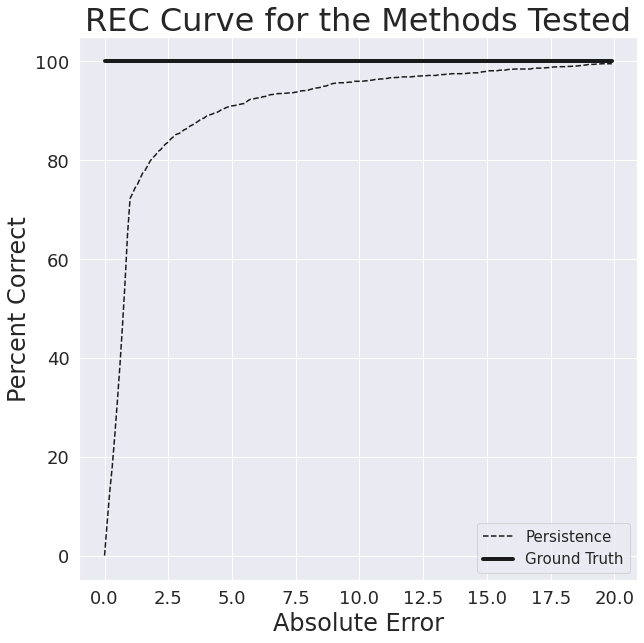

In [18]:
#now does persistence work as a method?
print('AUC: '+ str(AUC(REC(features_no_outliers_weighted['persistence'], features_no_outliers_weighted['Scaling_Factor'])[1])))
print('RMSE: '+ str(RMSE(features_no_outliers_weighted['persistence'], features_no_outliers_weighted['Scaling_Factor'])))
print('MAD: '+ str(MAD(features_no_outliers_weighted['persistence'], features_no_outliers_weighted['Scaling_Factor'])))
print('MeAD: '+ str(MeAD(features_no_outliers_weighted['persistence'], features_no_outliers_weighted['Scaling_Factor'])))


#REC CURVES
thresholds_persistence, accuracy_persistence = REC(features_no_outliers_weighted['persistence'], features_no_outliers_weighted['Scaling_Factor'])
thresh_sf, accuracies_sf = REC(features_no_outliers_weighted['Scaling_Factor'].values, features_no_outliers_weighted['Scaling_Factor'].values)

plt.figure(figsize=(10,10))
plt.plot(thresholds_persistence, accuracy_persistence,'k--',  label = 'Persistence')
plt.plot(thresh_sf, accuracies_sf, 'k-', linewidth=4, label='Ground Truth')

plt.legend(fontsize=15)
plt.title('REC Curve for the Methods Tested', fontsize=32)
plt.ylabel('Percent Correct', fontsize=24)
plt.xlabel('Absolute Error', fontsize=24)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(True)
plt.show()

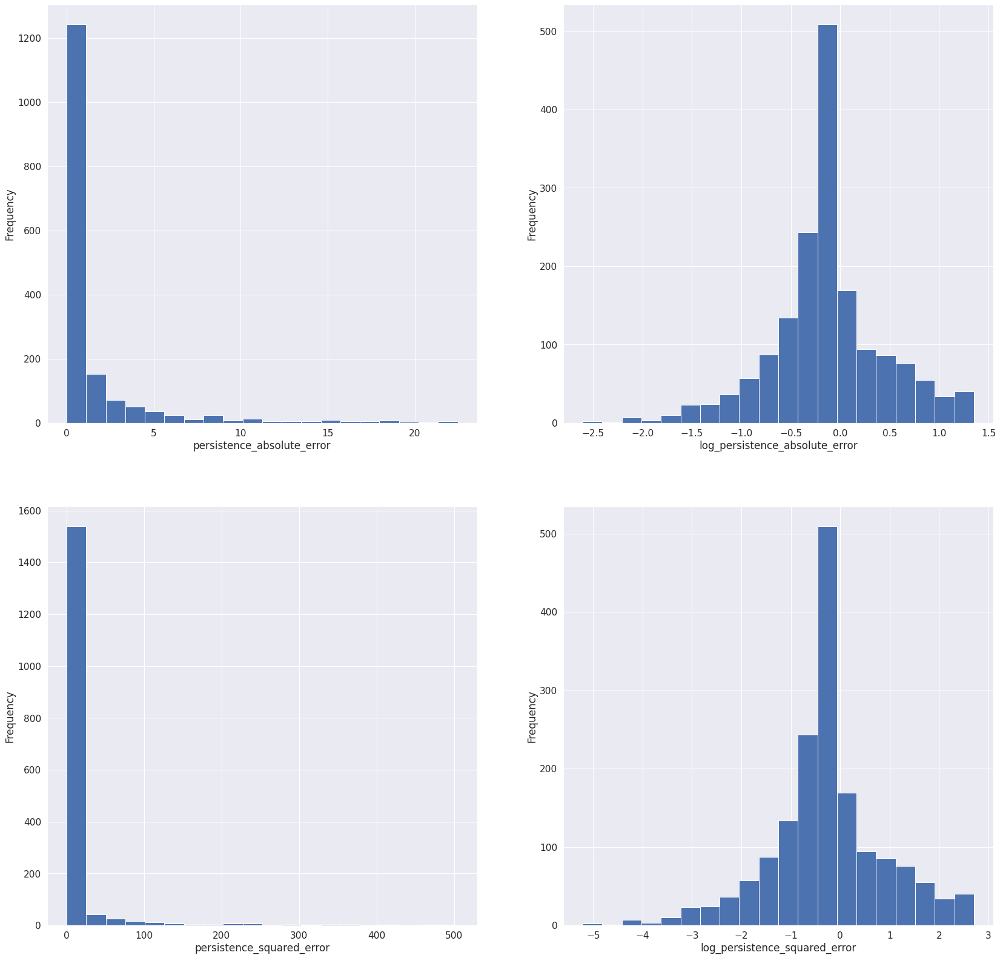

In [19]:
# histogram of errors
methods_test=['persistence_absolute_error', 'log_persistence_absolute_error','persistence_squared_error', 'log_persistence_squared_error']
features_no_outliers_weighted['persistence_absolute_error'] = np.abs(features_no_outliers_weighted['persistence']-features_no_outliers_weighted['Scaling_Factor'])
features_no_outliers_weighted['persistence_squared_error'] = (features_no_outliers_weighted['persistence']-features_no_outliers_weighted['Scaling_Factor'])**2

features_no_outliers_weighted['log_persistence_absolute_error'] = np.log10(features_no_outliers_weighted['persistence_absolute_error'])
features_no_outliers_weighted['log_persistence_squared_error'] = np.log10(features_no_outliers_weighted['persistence_squared_error'])

numrows_plot = int(np.ceil(len(methods_test)/2))
fig, axs = plt.subplots(numrows_plot,2, figsize=(28,28))
for ii in range(len(methods_test)):
    row=int(np.floor(ii/2))
    col = np.mod(ii,2)
    ax0 = features_no_outliers_weighted[methods_test[ii]].plot.hist(ax=axs[row,col], bins = 20)
    ax0.set(xlabel=methods_test[ii])

plt.show()

In [22]:
# what would the quantiles of the scaling factor look like?
quantiles = features_no_outliers_weighted['Scaling_Factor'].quantile(q=[.1, .2, .3, .4, .5, .6,.7, .8, .9])
print(quantiles)

0.1    0.141683
0.2    0.268359
0.3    0.420841
0.4    0.629969
0.5    0.907681
0.6    1.245129
0.7    1.804243
0.8    2.820937
0.9    5.501390
Name: Scaling_Factor, dtype: float64


# How do we want to drop one day fires

In [ ]:
polys = gpd.read_file('/data2/lthapa/ML_daily/fire_polygons/ClippedFires2019_VIIRS_daily_12Z_Day_Start.geojson')
polys_reindex = polys.set_index(['irwinID', 'Local Day'])

polys_ge_two_days = polys[polys.groupby('irwinID')['Local Day'].transform('size').ge(2)].reset_index(drop=True)
print(polys_ge_two_days)

polys_ge_two_days.to_file('/data2/lthapa/ML_daily/fire_polygons/ClippedFires2019_VIIRS_daily_12Z_Day_Start_1day_dropped.geojson')
#print(polys_ge_two_days.set_index(['irwinID', 'Local Day']))
#print(len(np.unique(polys_ge_two_days['irwinID'])))

In [ ]:
polys = gpd.read_file('/data2/lthapa/ML_daily/fire_polygons/ClippedFires2020_VIIRS_daily_12Z_Day_Start.geojson')
polys_reindex = polys.set_index(['irwinID', 'Local Day'])

polys_ge_two_days = polys[polys.groupby('irwinID')['Local Day'].transform('size').ge(2)].reset_index(drop=True)
print(polys_ge_two_days)

polys_ge_two_days.to_file('/data2/lthapa/ML_daily/fire_polygons/ClippedFires2020_VIIRS_daily_12Z_Day_Start_1day_dropped.geojson')

#print(polys_ge_two_days.set_index(['irwinID', 'Local Day']))
#print(len(np.unique(polys_ge_two_days['irwinID'])))

# Look at correlations between scaled features and the scaling factor
4/27/2023

In [125]:
features_weighted_2020 = generate_feature_vector([2020], 'Weighted')
features_unweighted_2020 = generate_feature_vector([2020], 'Unweighted')


In [126]:
# drop fires that last one day
features_weighted_2020_reindex = features_weighted_2020.reset_index()
features_weighted_2020_ge = features_weighted_2020_reindex[features_weighted_2020_reindex.groupby('irwinID')['day'].transform('size').ge(2)].reset_index(drop=True)
print(len(np.unique(features_weighted_2020_ge['irwinID'])), len(features_weighted_2020_ge))


# drop fires that last one day
features_unweighted_2020_reindex = features_unweighted_2020.reset_index()
features_unweighted_2020_ge = features_unweighted_2020_reindex[features_unweighted_2020_reindex.groupby('irwinID')['day'].transform('size').ge(2)].reset_index(drop=True)
print(len(np.unique(features_unweighted_2020_ge['irwinID'])), len(features_unweighted_2020_ge))


205 2431
205 2431


In [127]:
#do the shifts for all the incidents, weighted and unweighted
events = np.unique(features_unweighted_2020_ge['irwinID']) #all the incidents

features_to_shift = features_unweighted_2020_ge.columns.values
features_shifted = []

for ii in range(len(features_to_shift)):
    features_shifted.append(features_to_shift[ii]+'_1')
    

features_with_shifts_weighted = pd.DataFrame()
features_with_shifts_unweighted = pd.DataFrame()
for jj in range(len(events)):
    df_fire_weighted = features_weighted_2020_ge[features_weighted_2020_ge['irwinID']==events[jj]]
    df_fire_unweighted = features_unweighted_2020_ge[features_unweighted_2020_ge['irwinID']==events[jj]]

    df_fire_shifted_weighted = shift_ndays(df_fire_weighted, 1, features_to_shift, features_shifted, 'day')
    df_fire_shifted_unweighted = shift_ndays(df_fire_unweighted, 1, features_to_shift, features_shifted, 'day')

    features_with_shifts_weighted = pd.concat([features_with_shifts_weighted, df_fire_shifted_weighted], axis=0).reset_index(drop=True)
    features_with_shifts_unweighted = pd.concat([features_with_shifts_unweighted, df_fire_shifted_unweighted], axis=0).reset_index(drop=True)

#get the scaling factor
features_with_shifts_weighted['Scaling_Factor'] = features_with_shifts_weighted['FRP_MEAN']/features_with_shifts_weighted['FRP_MEAN_1']
features_with_shifts_unweighted['Scaling_Factor'] = features_with_shifts_unweighted['FRP_MEAN']/features_with_shifts_unweighted['FRP_MEAN_1']

#get the log of the scaling factor
features_with_shifts_weighted['Log_Scaling_Factor']= np.log10(features_with_shifts_weighted['Scaling_Factor'])
features_with_shifts_unweighted['Log_Scaling_Factor']= np.log10(features_with_shifts_unweighted['Scaling_Factor'])

#get the outliers
features_with_shifts_weighted = find_outliers(features_with_shifts_weighted, 'Log_Scaling_Factor')
print(len(features_with_shifts_weighted[features_with_shifts_weighted['Log_Scaling_Factor_is_outlier']==False]))

features_with_shifts_unweighted = find_outliers(features_with_shifts_unweighted, 'Log_Scaling_Factor')
print(len(features_with_shifts_unweighted[features_with_shifts_unweighted['Log_Scaling_Factor_is_outlier']==False]))

3206
3206


In [248]:
features_relative =['hd0w0', 'hd1w0','hd2w0', 'hd3w0', 'hwp', #weather
                    'IMERG.FINAL.v6_FWI','IMERG.FINAL.v6_ISI', 'IMERG.FINAL.v6_BUI', 'IMERG.FINAL.v6_DSR', #weather
                    'IMERG.FINAL.v6_DC', 'IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','Blended_SM', #moisture
                    'FMCG2D', 'FMCGLH2D', #moisture
                    'Extreme_N', 'VeryHigh_N','High_N', 'Moderate_N', 'Low_N', #fuel  
                   'PWS',  'ESI', #ecosystem
                    'PFT', 'chi' #stability
                   ]
features_weighted_relative = get_relative_features(features_with_shifts_weighted, features_relative)
features_unweighted_relative = get_relative_features(features_with_shifts_unweighted, features_relative)

### Weather (4/28)

In [270]:
features_unweighted_plot = features_unweighted_relative[(features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False)&
                                                        (features_unweighted_relative['rel_hwp']<100)]
                                                        #(features_unweighted_relative['rel_PFT']<10)]

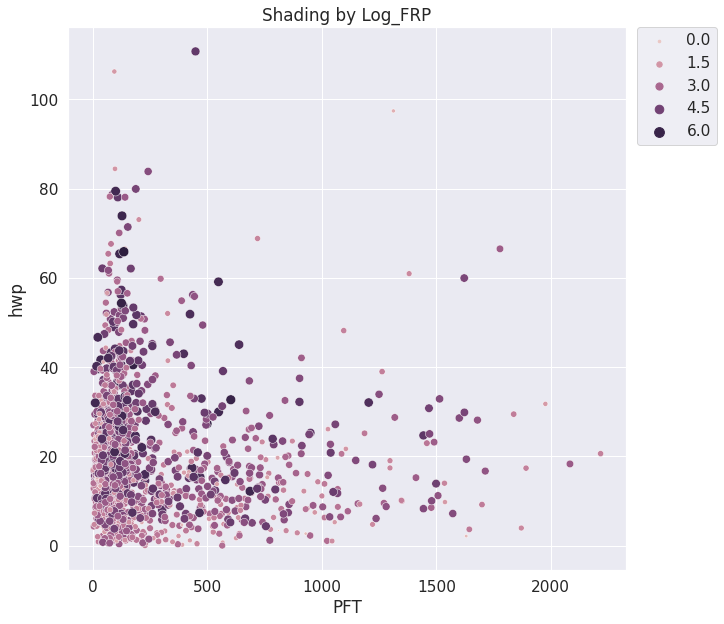

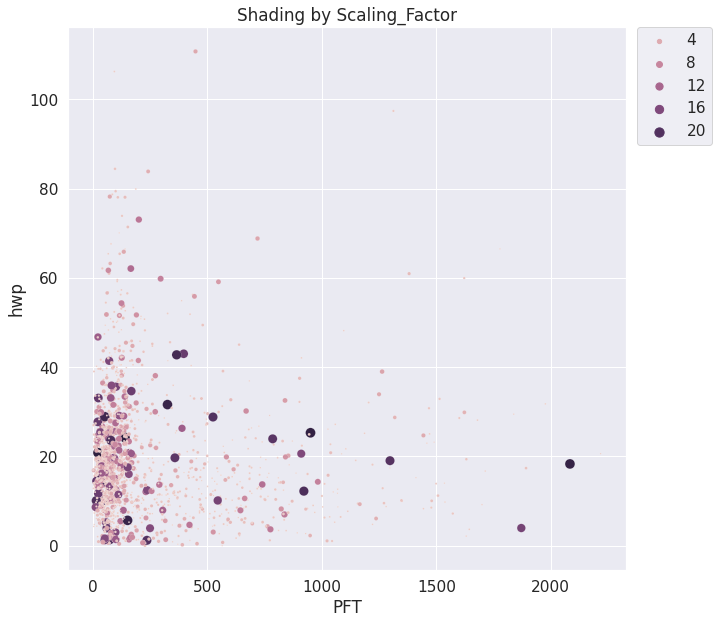

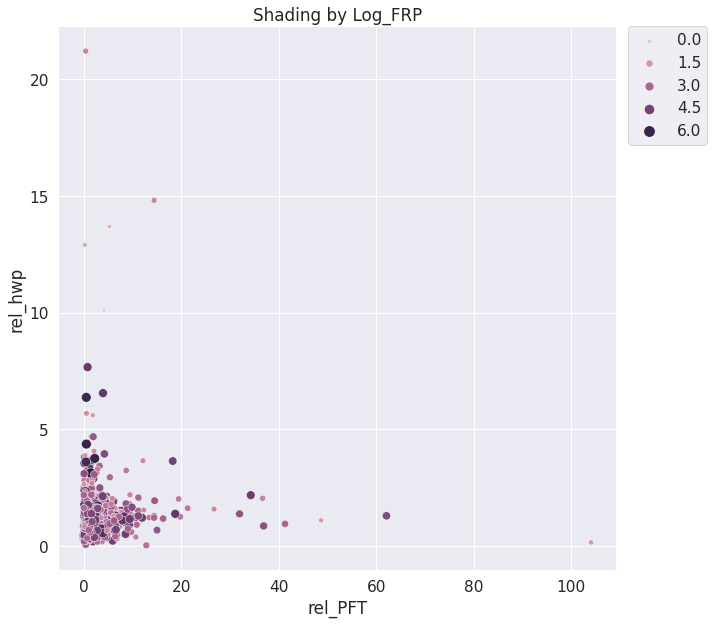

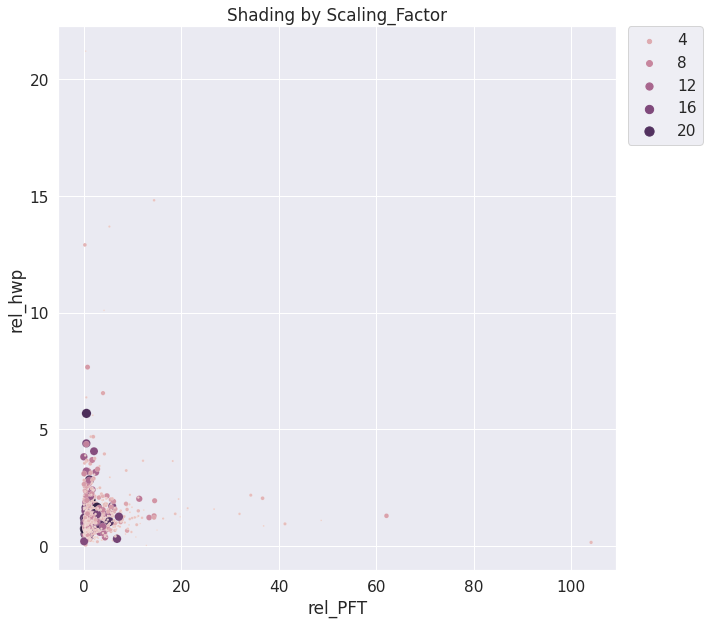

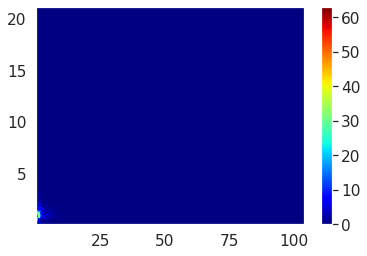

In [303]:
features_unweighted_plot['Log_FRP'] = np.log10(features_unweighted_plot['FRP_MEAN']).replace([np.inf, -np.inf], np.nan)
features_unweighted_plot['log_rel_hwp'] = np.log10(features_unweighted_plot['rel_hwp']).replace([np.inf, -np.inf], np.nan)
features_unweighted_plot['log_rel_PFT'] = np.log10(features_unweighted_plot['rel_PFT']).replace([np.inf, -np.inf], np.nan)

scatter_plot(features_unweighted_plot,'PFT','hwp','Log_FRP', None, 'Log_FRP',(2,100),'Shading by Log_FRP')
scatter_plot(features_unweighted_plot,'PFT','hwp','Scaling_Factor', None, 'Scaling_Factor',(2,100),'Shading by Scaling_Factor')

scatter_plot(features_unweighted_plot,'rel_PFT','rel_hwp', 'Log_FRP', None, 'Log_FRP',(2,100),'Shading by Log_FRP')
scatter_plot(features_unweighted_plot,'rel_PFT','rel_hwp', 'Scaling_Factor', None, 'Scaling_Factor',(2,100),'Shading by Scaling_Factor')

plt.hist2d(features_unweighted_plot['rel_PFT'], features_unweighted_plot['rel_hwp'], bins=[200,200], cmap='jet')
plt.colorbar()
plt.show()

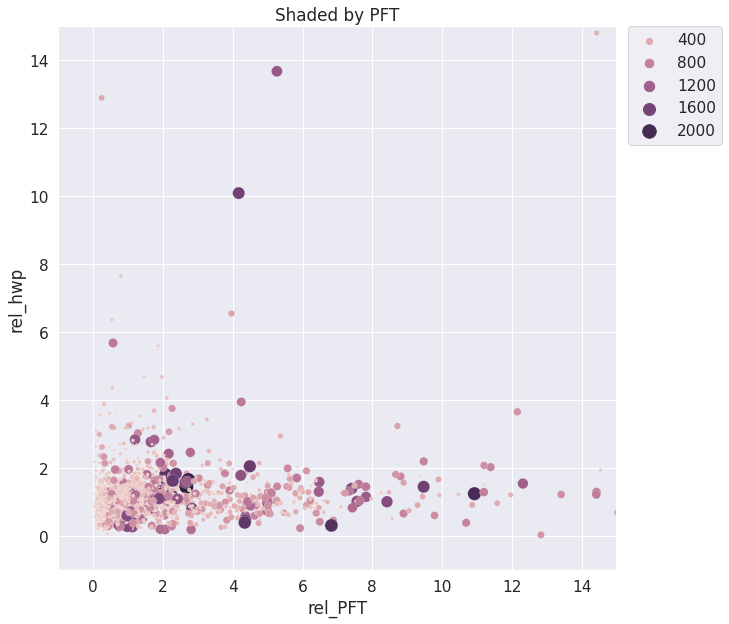

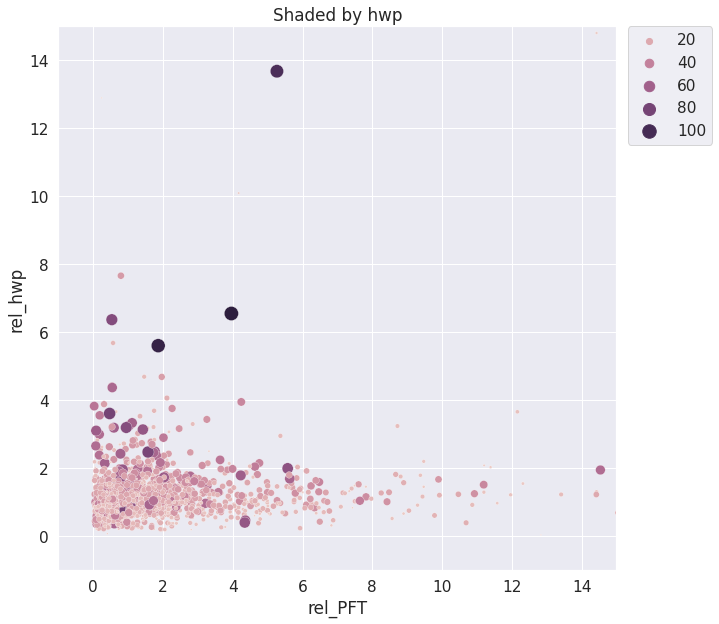

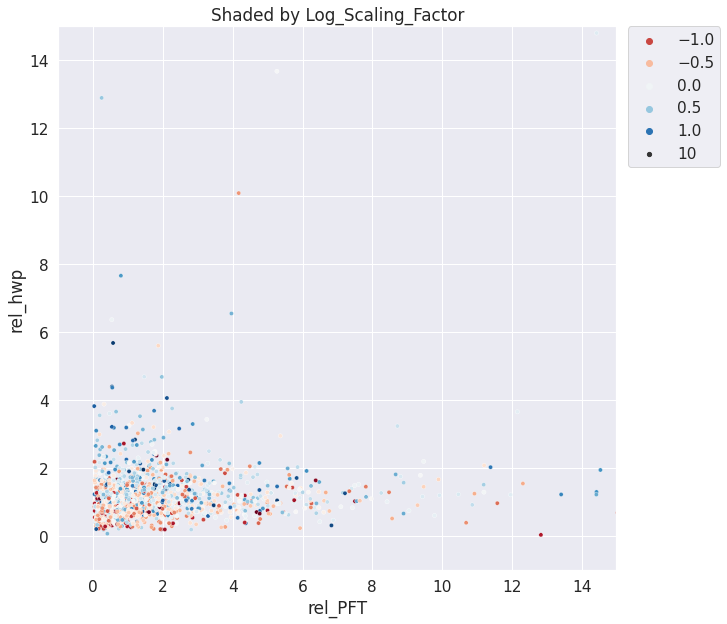

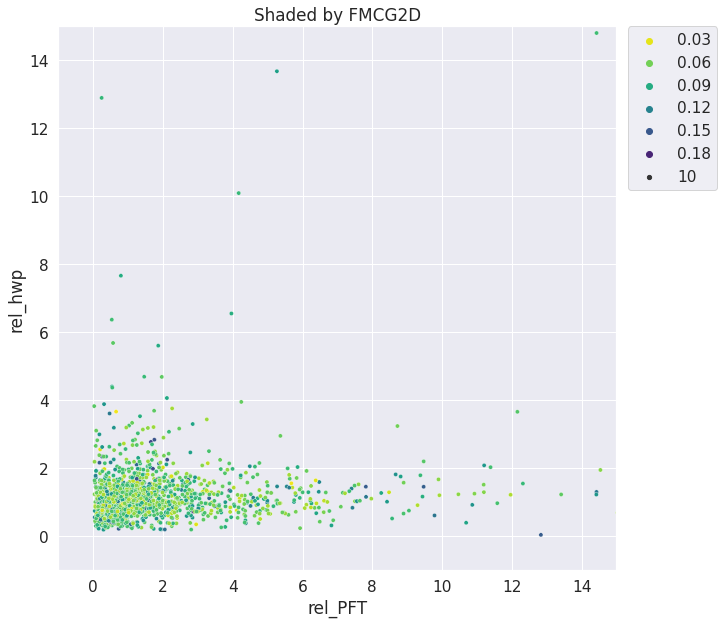

In [324]:
fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =features_unweighted_plot, x='rel_PFT',y='rel_hwp',hue='PFT',
                    style=None,size='PFT',sizes=(2,200),ax=ax,cmap='vlag')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Shaded by PFT')
plt.xlim(-1, 15) #this does cut some out
plt.ylim(-1, 15) #this does cut some out
plt.show()

fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =features_unweighted_plot, x='rel_PFT',y='rel_hwp',hue='hwp',
                    style=None,size='hwp',sizes=(2,200),ax=ax,cmap='vlag')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Shaded by hwp')
plt.xlim(-1, 15) #this does cut some out
plt.ylim(-1, 15) #this does cut some out
plt.show()

normalize = mcolors.TwoSlopeNorm(vcenter=0, vmin=-1, vmax=1)
colormap = cm.RdBu
fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =features_unweighted_plot, x='rel_PFT',y='rel_hwp',hue='Log_Scaling_Factor', norm=normalize,
                    style=None,size=(10),ax=ax,palette=colormap)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Shaded by Log_Scaling_Factor')
plt.xlim(-1, 15) #this does cut some out
plt.ylim(-1, 15) #this does cut some out
plt.show()





fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =features_unweighted_plot, x='rel_PFT',y='rel_hwp',hue='FMCG2D',
                    style=None,size=10,ax=ax,palette='viridis_r')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Shaded by FMCG2D')
plt.xlim(-1, 15) #this does cut some out
plt.ylim(-1, 15) #this does cut some out
plt.show()

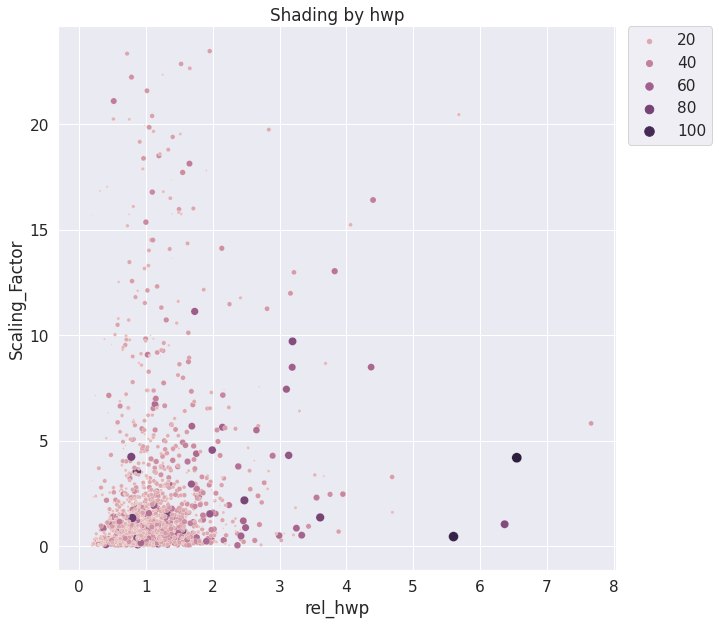

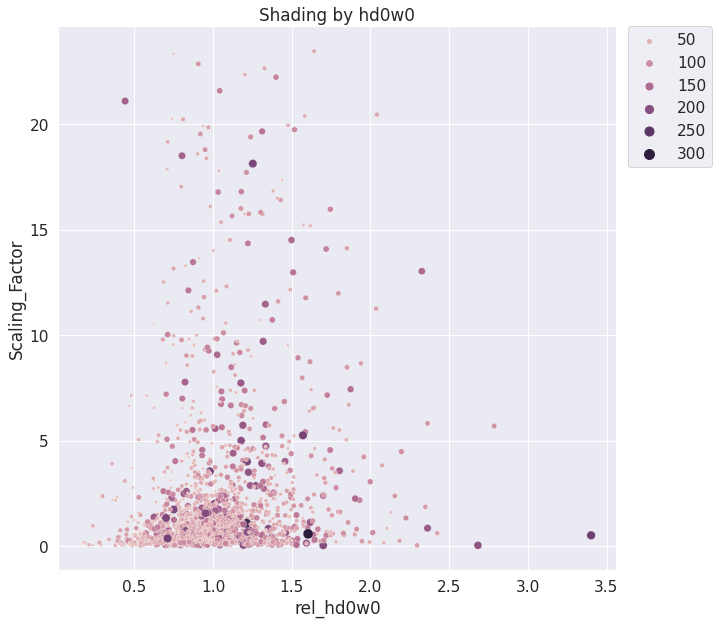

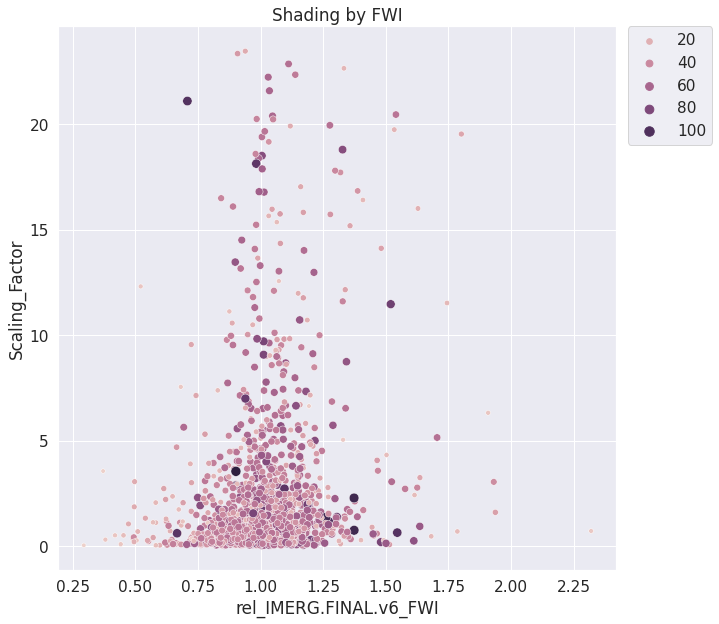

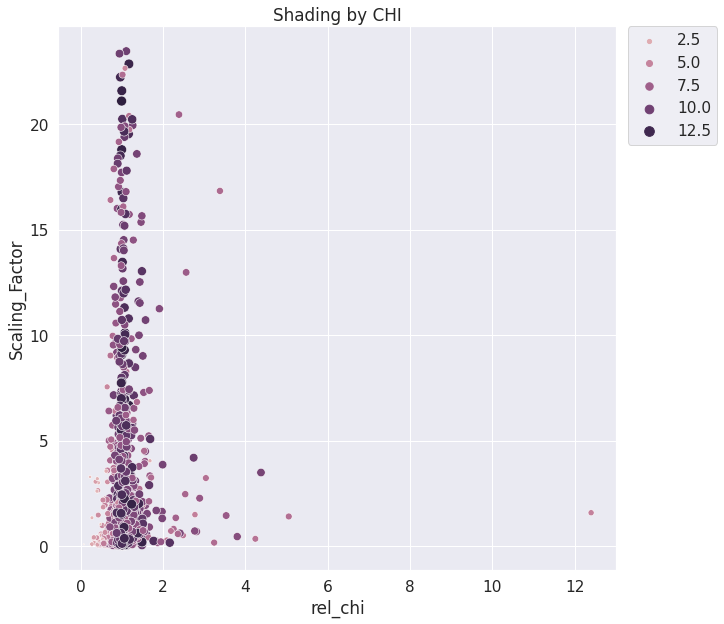

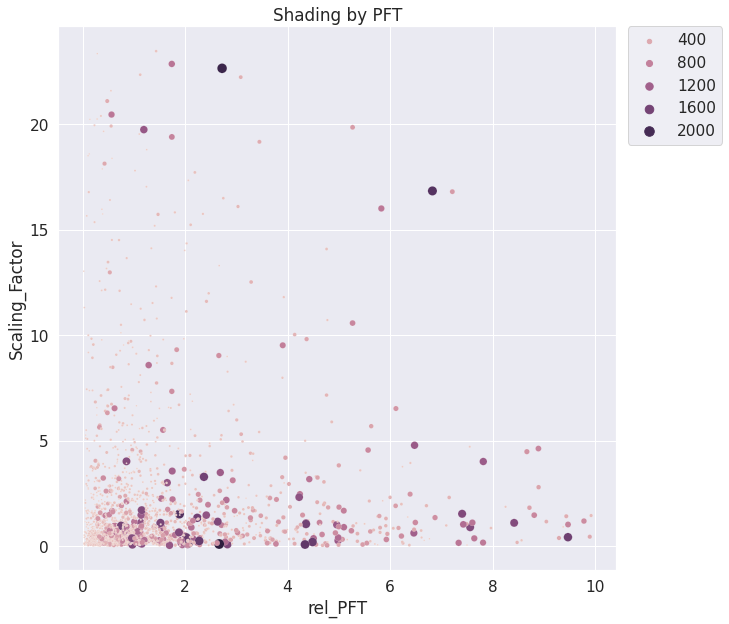

...

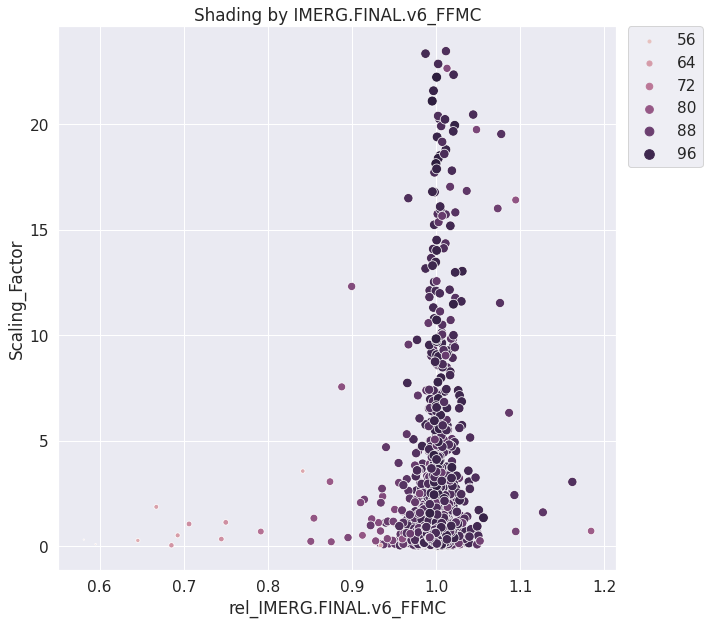

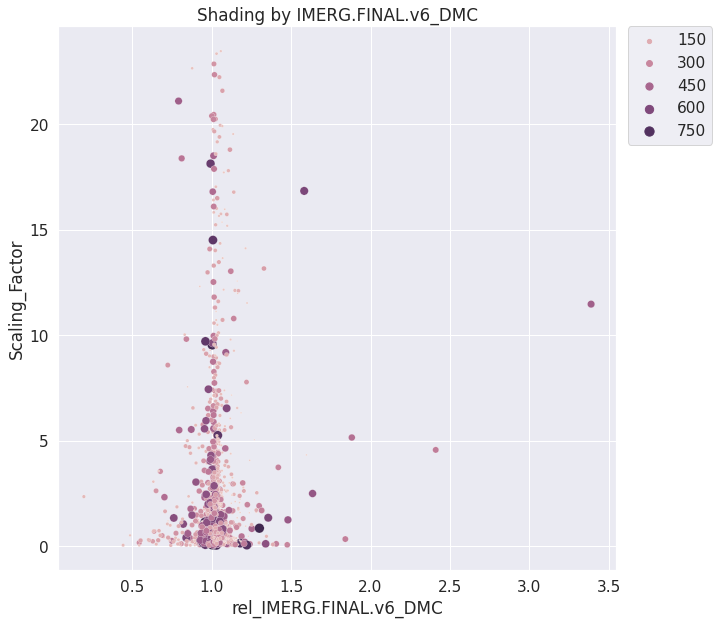

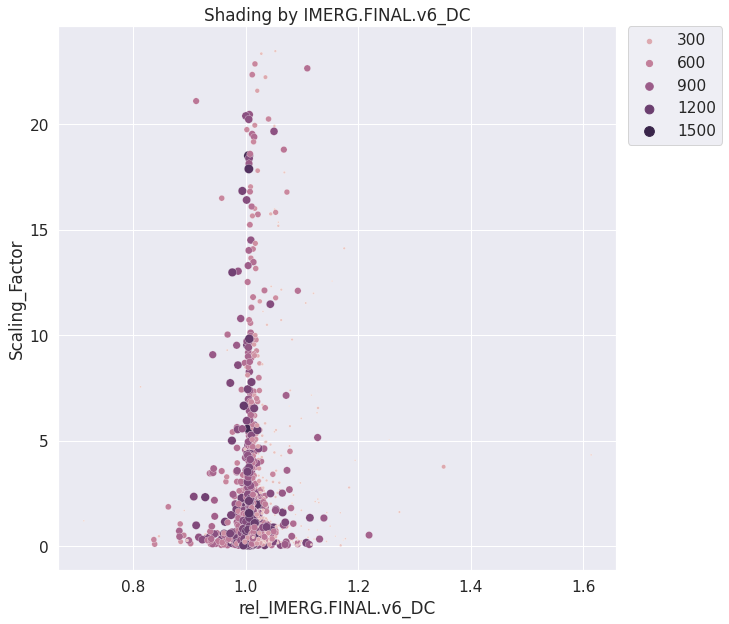

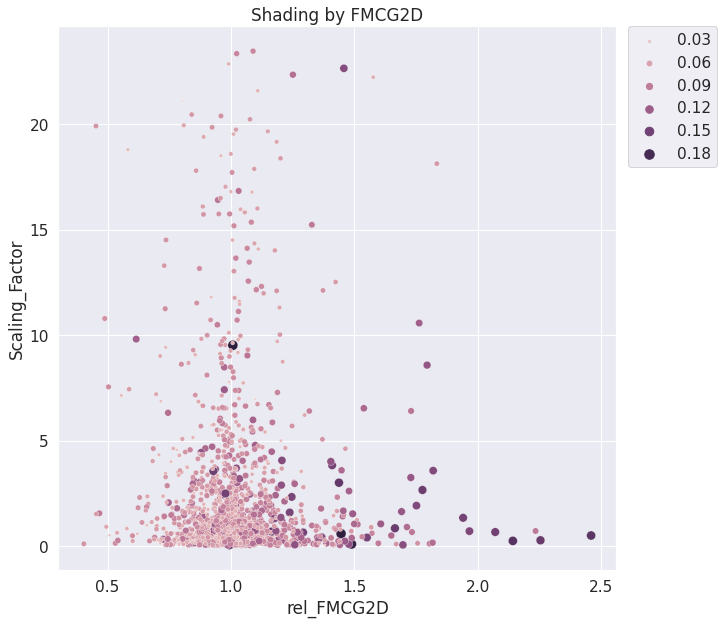

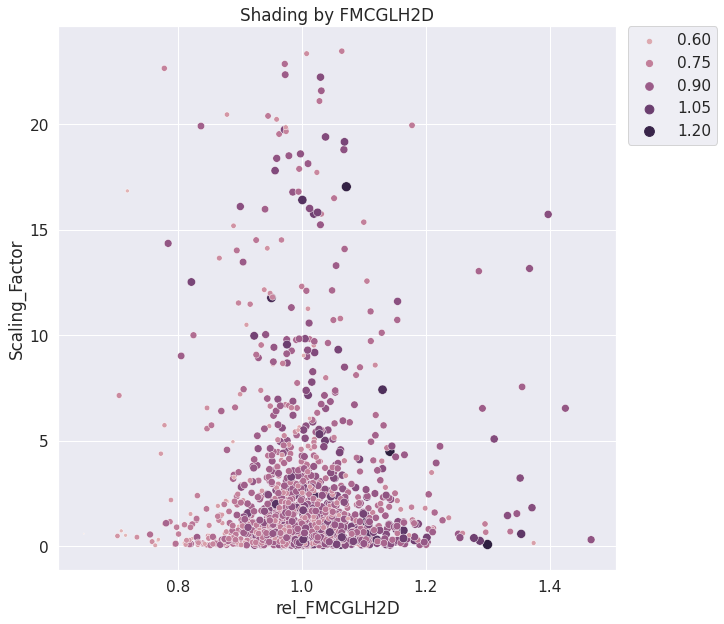

In [246]:
#plot everything vs scaling factor

#weather
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'hwp', None, 'hwp',(2,100),'Shading by hwp')
scatter_plot(features_unweighted_plot,'rel_hd0w0','Scaling_Factor', 'hd0w0', None, 'hd0w0',(2,100),'Shading by hd0w0')
scatter_plot(features_unweighted_plot,'rel_IMERG.FINAL.v6_FWI','Scaling_Factor', 'IMERG.FINAL.v6_FWI', None, 'IMERG.FINAL.v6_FWI',(20,100),'Shading by FWI')

#stability
scatter_plot(features_unweighted_plot,'rel_chi','Scaling_Factor', 'chi', None, 'chi',(2,100),'Shading by CHI')
scatter_plot(features_unweighted_plot,'rel_PFT','Scaling_Factor', 'PFT', None, 'PFT',(2,100),'Shading by PFT')

#fuel
scatter_plot(features_unweighted_plot,'rel_Low_N','Scaling_Factor', 'Low_N', None, 'Low_N',(2,100),'Shading by Low_N')
scatter_plot(features_unweighted_plot,'rel_Moderate_N','Scaling_Factor', 'Moderate_N', None, 'Moderate_N',(2,100),'Shading by Moderate_N')
scatter_plot(features_unweighted_plot,'rel_High_N','Scaling_Factor', 'High_N', None, 'High_N',(2,100),'Shading by High_N')
scatter_plot(features_unweighted_plot,'rel_VeryHigh_N','Scaling_Factor', 'VeryHigh_N', None, 'VeryHigh_N',(2,100),'Shading by VeryHigh_N')
scatter_plot(features_unweighted_plot,'rel_Extreme_N','Scaling_Factor', 'Extreme_N', None, 'Extreme_N',(2,100),'Shading by Extreme_N')

#ecosystem
scatter_plot(features_unweighted_plot,'rel_PWS','Scaling_Factor', 'PWS', None, 'PWS',(2,100),'Shading by PWS')
scatter_plot(features_unweighted_plot,'rel_ESI','Scaling_Factor', 'ESI', None, 'ESI',(2,100),'Shading by ESI')

#moisture
scatter_plot(features_unweighted_plot,'rel_Blended_SM','Scaling_Factor', 'Blended_SM', None, 'Blended_SM',(2,100),'Shading by Blended_SM')
scatter_plot(features_unweighted_plot,'rel_IMERG.FINAL.v6_FFMC','Scaling_Factor', 'IMERG.FINAL.v6_FFMC', None, 'IMERG.FINAL.v6_FFMC',(2,100),'Shading by IMERG.FINAL.v6_FFMC')
scatter_plot(features_unweighted_plot,'rel_IMERG.FINAL.v6_DMC','Scaling_Factor', 'IMERG.FINAL.v6_DMC', None, 'IMERG.FINAL.v6_DMC',(2,100),'Shading by IMERG.FINAL.v6_DMC')
scatter_plot(features_unweighted_plot,'rel_IMERG.FINAL.v6_DC','Scaling_Factor', 'IMERG.FINAL.v6_DC', None, 'IMERG.FINAL.v6_DC',(2,100),'Shading by IMERG.FINAL.v6_DC')
scatter_plot(features_unweighted_plot,'rel_FMCG2D','Scaling_Factor', 'FMCG2D', None, 'FMCG2D',(2,100),'Shading by FMCG2D')
scatter_plot(features_unweighted_plot,'rel_FMCGLH2D','Scaling_Factor', 'FMCGLH2D', None, 'FMCGLH2D',(2,100),'Shading by FMCGLH2D')


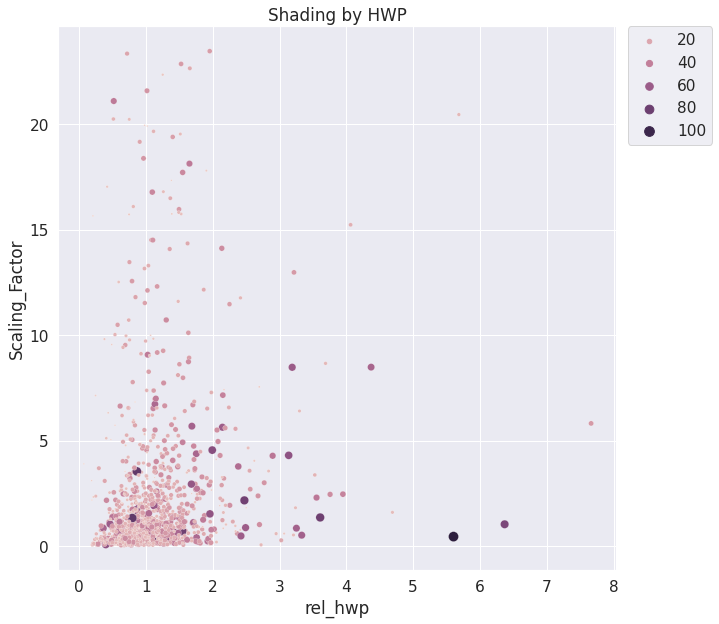

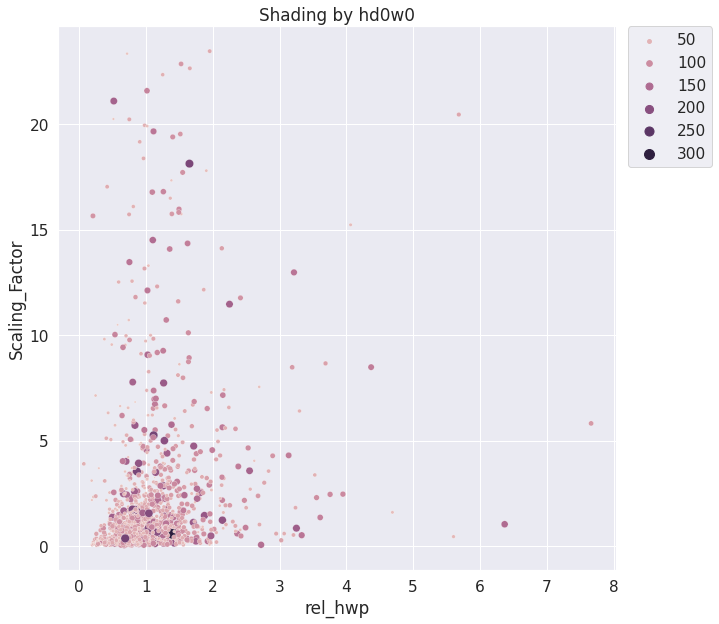

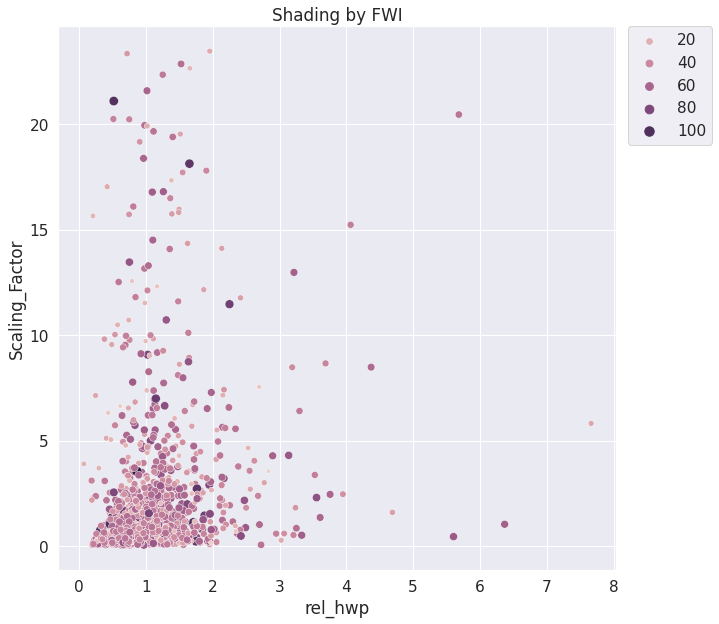

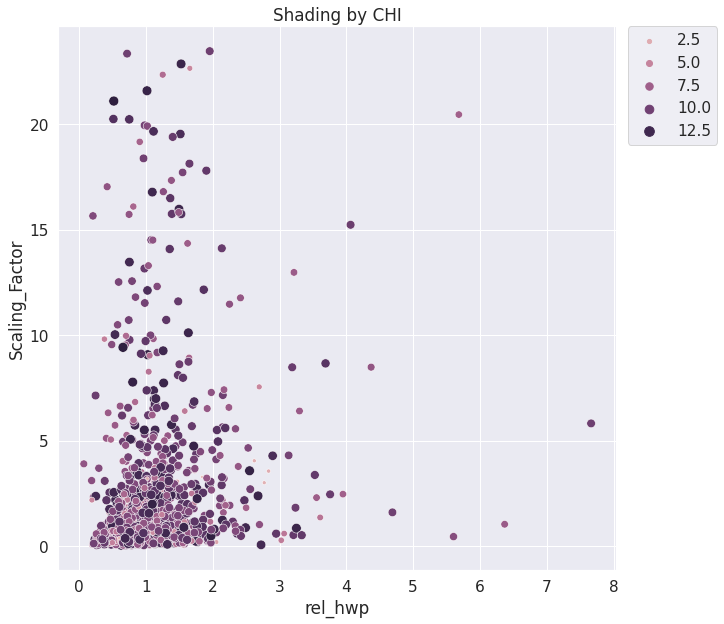

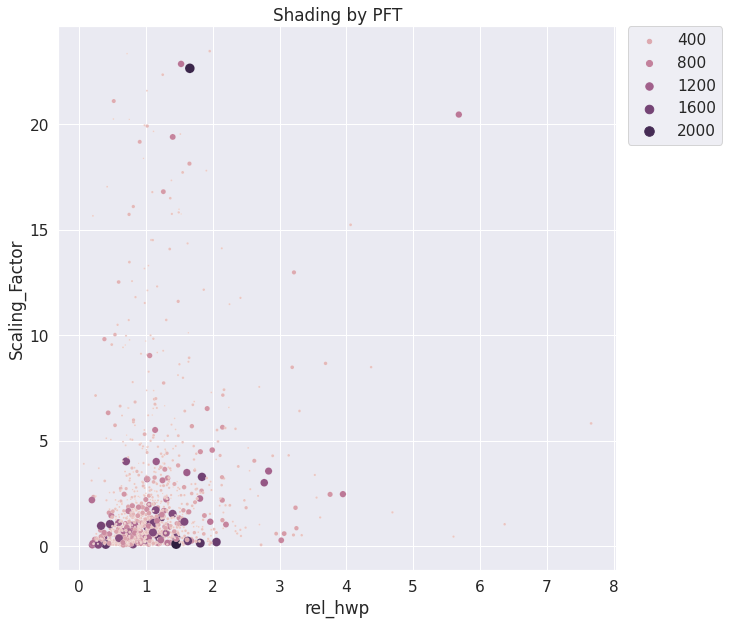

...

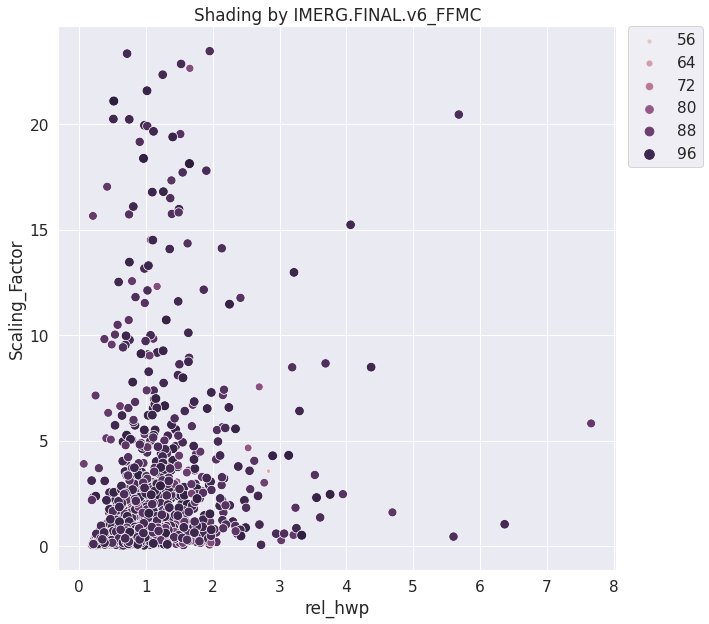

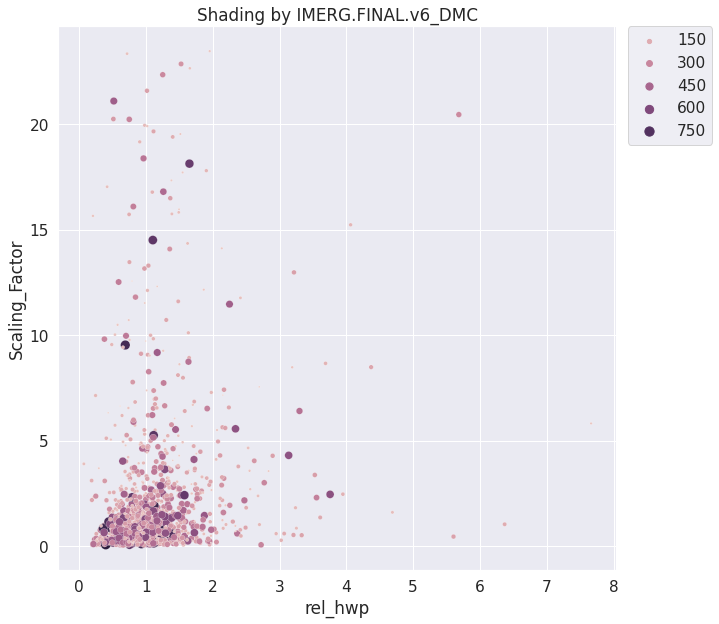

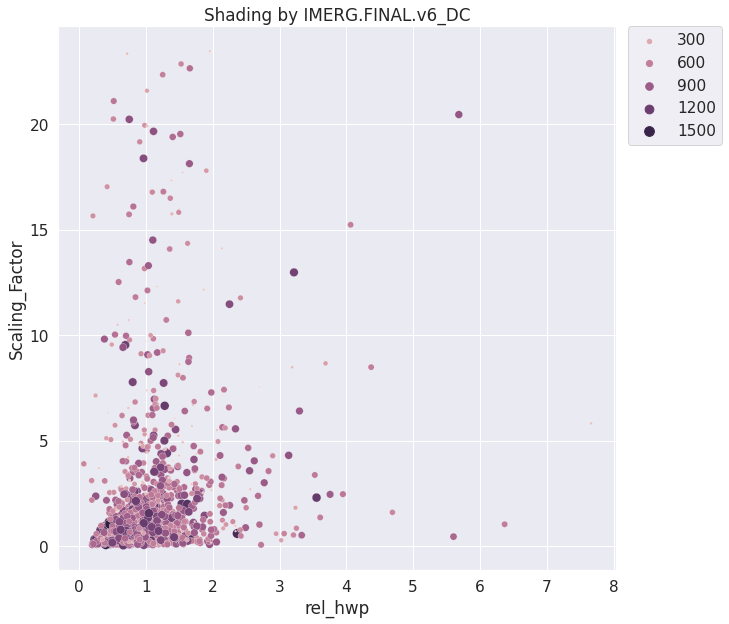

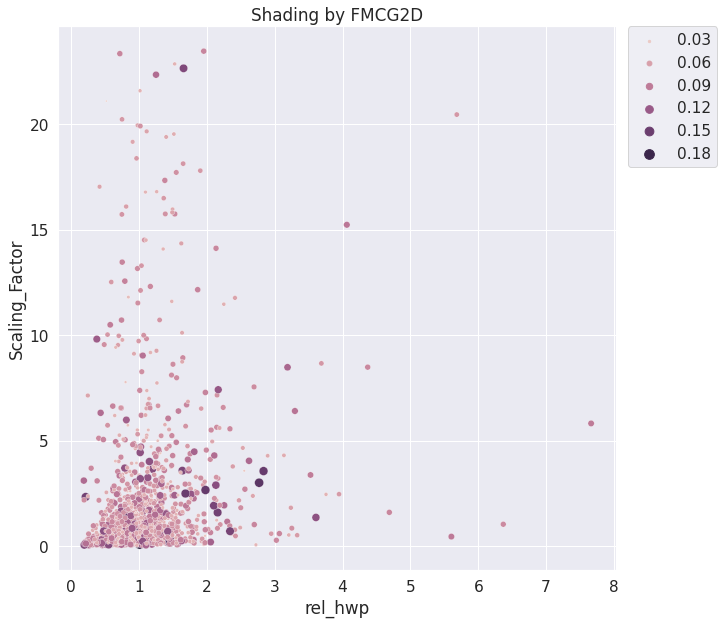

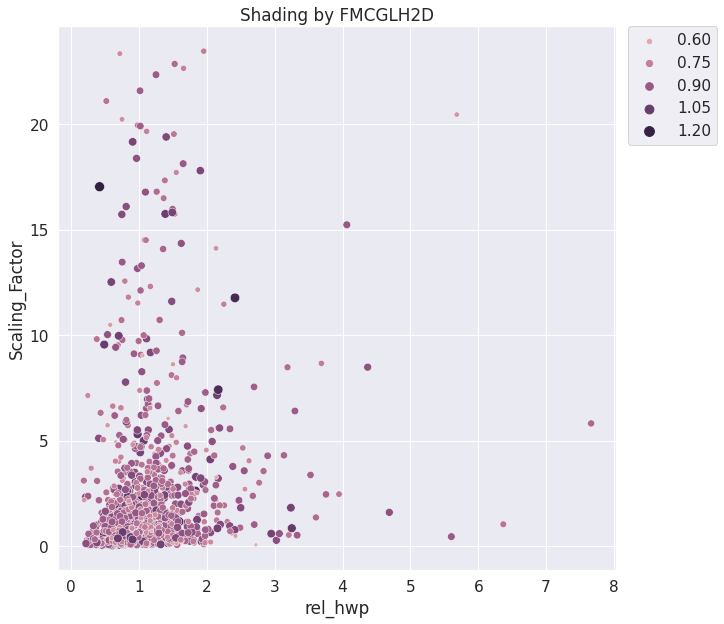

In [224]:
#weather
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'hwp', None, 'hwp',(2,100),'Shading by HWP')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'hd0w0', None, 'hd0w0',(2,100),'Shading by hd0w0')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'IMERG.FINAL.v6_FWI', None, 'IMERG.FINAL.v6_FWI',(20,100),'Shading by FWI')

#stability
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'chi', None, 'chi',(2,100),'Shading by CHI')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'PFT', None, 'PFT',(2,100),'Shading by PFT')

#fuel
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'Low_N', None, 'Low_N',(2,100),'Shading by Low_N')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'Moderate_N', None, 'Moderate_N',(2,100),'Shading by Moderate_N')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'High_N', None, 'High_N',(2,100),'Shading by High_N')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'VeryHigh_N', None, 'VeryHigh_N',(2,100),'Shading by VeryHigh_N')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'Extreme_N', None, 'Extreme_N',(2,100),'Shading by Extreme_N')

#ecosystem
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'PWS', None, 'PWS',(2,100),'Shading by PWS')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'ESI', None, 'ESI',(2,100),'Shading by ESI')

#moisture
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'Blended_SM', None, 'Blended_SM',(2,100),'Shading by Blended_SM')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'IMERG.FINAL.v6_FFMC', None, 'IMERG.FINAL.v6_FFMC',(2,100),'Shading by IMERG.FINAL.v6_FFMC')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'IMERG.FINAL.v6_DMC', None, 'IMERG.FINAL.v6_DMC',(2,100),'Shading by IMERG.FINAL.v6_DMC')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'IMERG.FINAL.v6_DC', None, 'IMERG.FINAL.v6_DC',(2,100),'Shading by IMERG.FINAL.v6_DC')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'FMCG2D', None, 'FMCG2D',(2,100),'Shading by FMCG2D')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'FMCGLH2D', None, 'FMCGLH2D',(2,100),'Shading by FMCGLH2D')


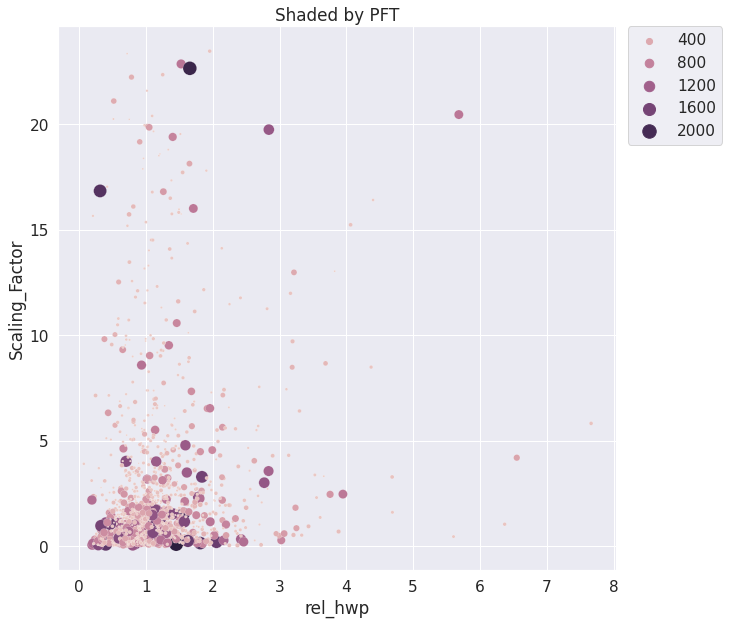

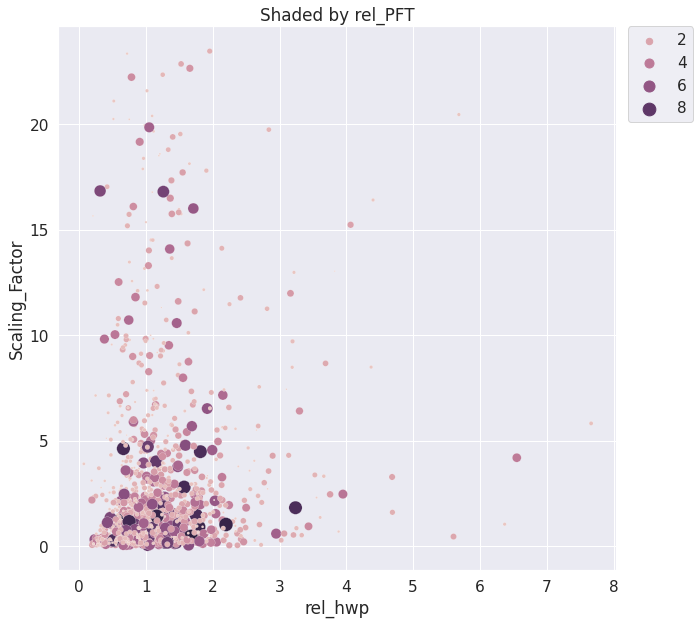

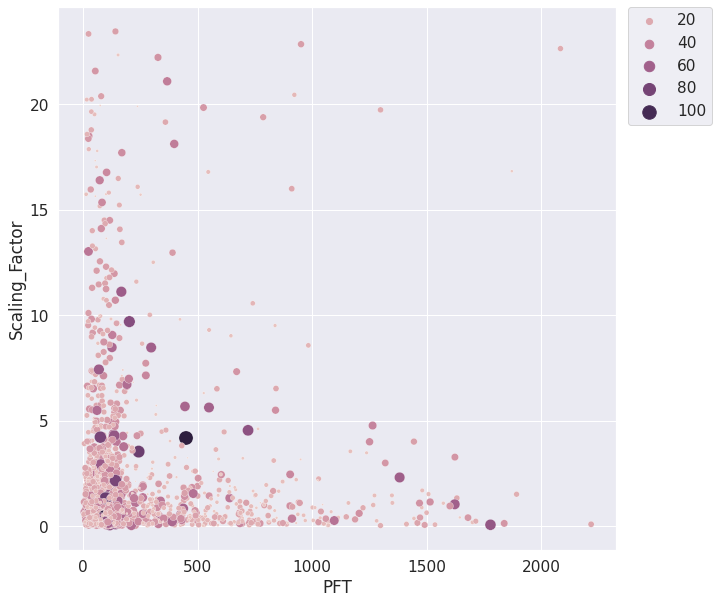

In [247]:
#weather-stability
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'PFT', None, 'PFT',(2,200),'Shaded by PFT')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'rel_PFT', None, 'rel_PFT',(2,200),'Shaded by rel_PFT')

scatter_plot(features_unweighted_plot,'PFT','Scaling_Factor', 'hwp', None, 'hwp',(2,200),'')


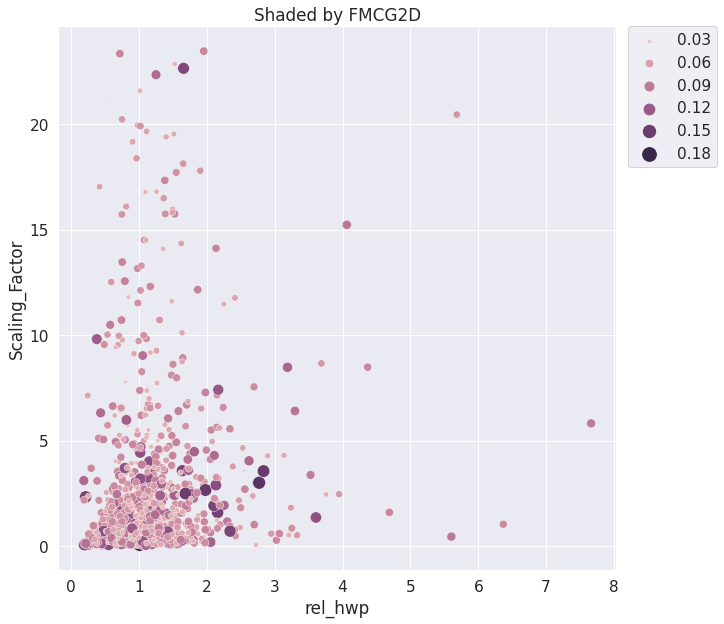

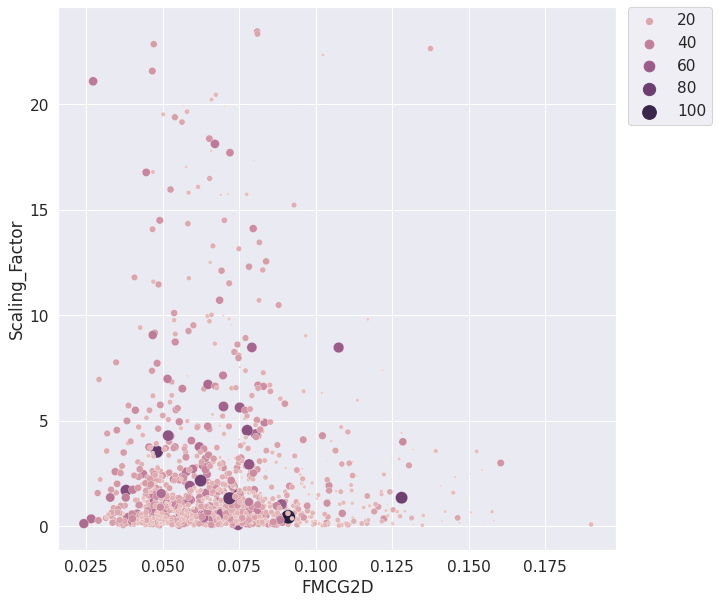

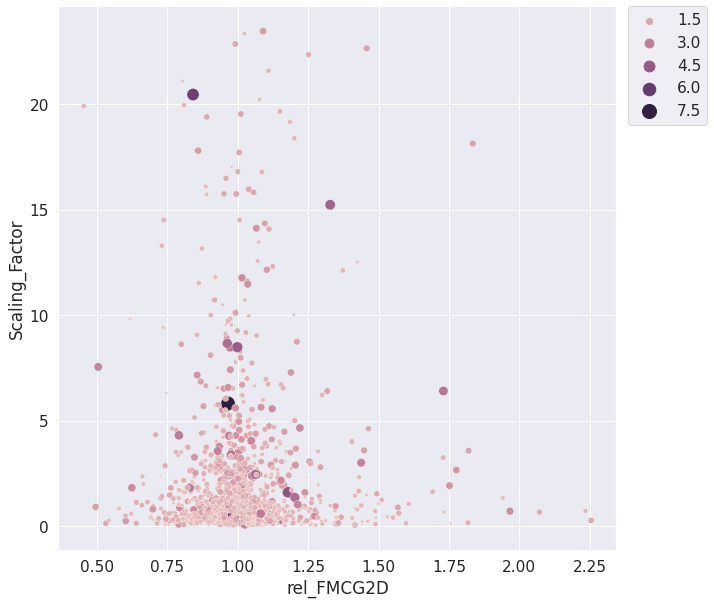

In [229]:
#weather-moisture
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor', 'FMCG2D', None, 'FMCG2D',(2,200),'Shaded by FMCG2D')
scatter_plot(features_unweighted_plot,'FMCG2D','Scaling_Factor', 'hwp', None, 'hwp',(2,200),'')
scatter_plot(features_unweighted_plot,'rel_FMCG2D','Scaling_Factor', 'rel_hwp', None, 'rel_hwp',(2,200),'')


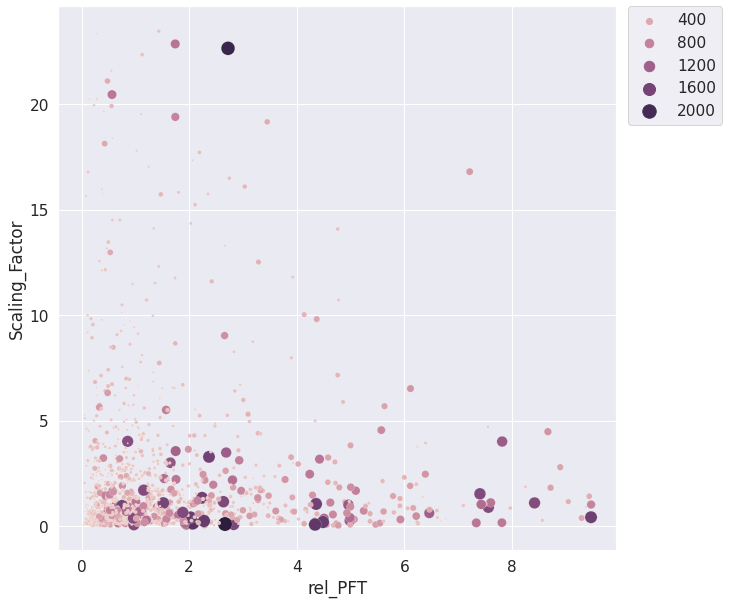

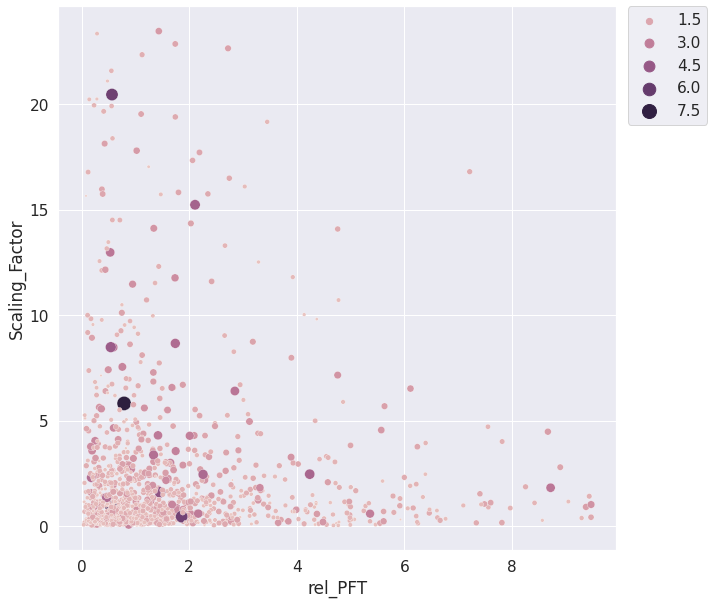

In [191]:
scatter_plot(features_unweighted_plot,'rel_PFT','Scaling_Factor', 'PFT', None, 'PFT',(2,200),'')
scatter_plot(features_unweighted_plot,'rel_PFT','Scaling_Factor', 'rel_hwp', None, 'rel_hwp',(2,200),'')


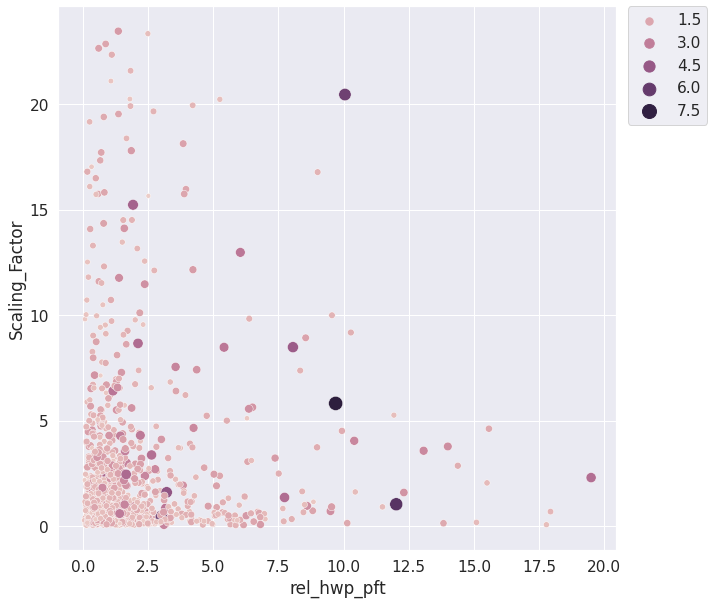

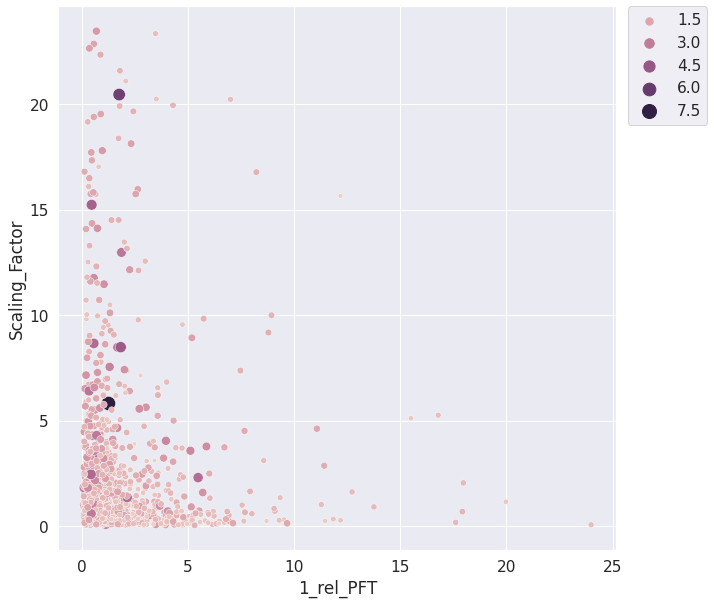

In [189]:
# hwp and PFT  as features
features_unweighted_plot['1_rel_PFT'] = 1/features_unweighted_plot['rel_PFT']
features_unweighted_plot['rel_hwp_pft'] = features_unweighted_plot['rel_hwp']*features_unweighted_plot['1_rel_PFT']
features_unweighted_plot = features_unweighted_plot[features_unweighted_plot['rel_hwp_pft']<20]

scatter_plot(features_unweighted_plot,'rel_hwp_pft','Scaling_Factor','rel_hwp', None, 'rel_hwp',(20,200),'')
scatter_plot(features_unweighted_plot,'1_rel_PFT','Scaling_Factor', 'rel_hwp', None, 'rel_hwp',(20,200),'')


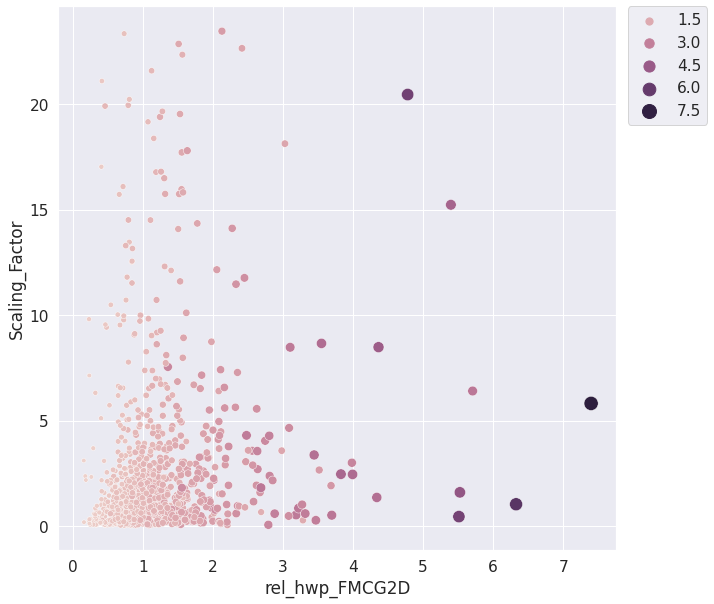

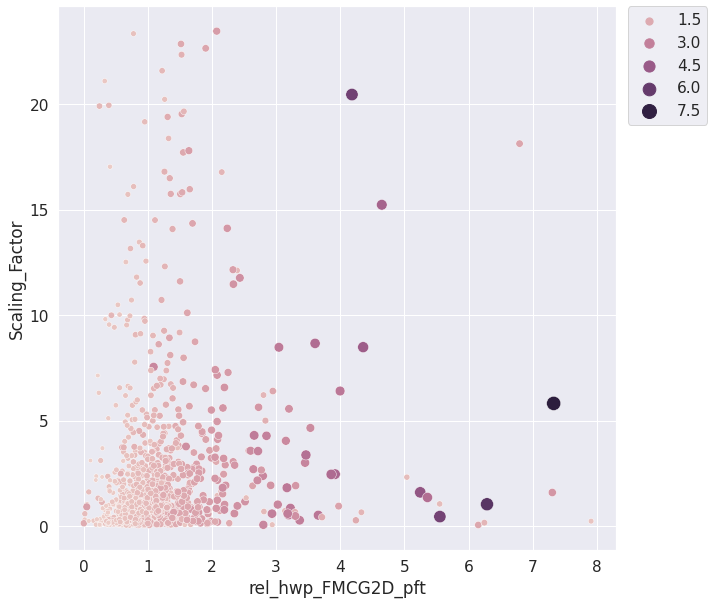

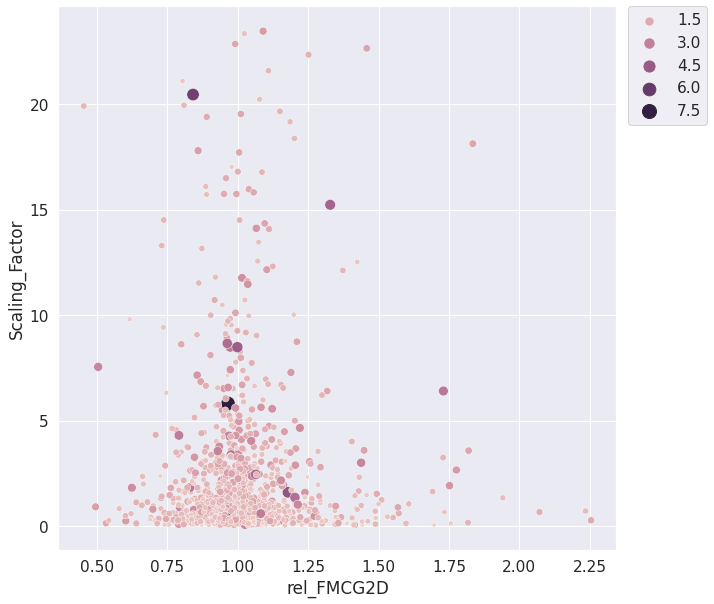

### Moisture (4/28)

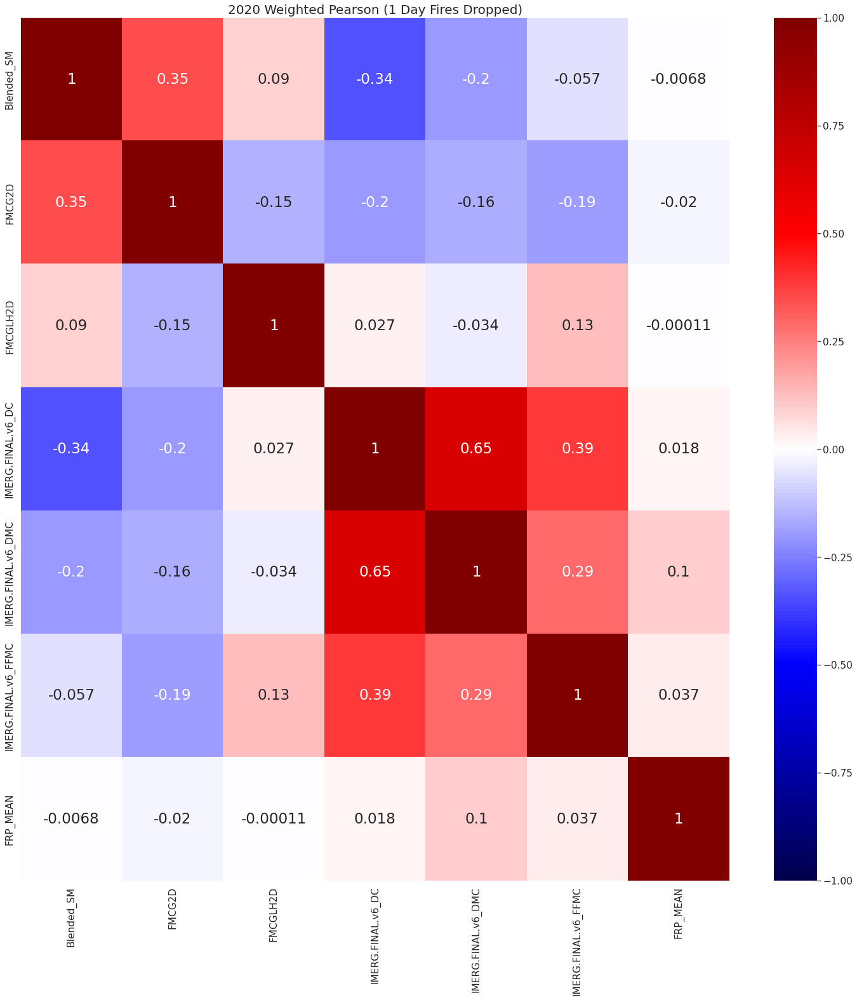

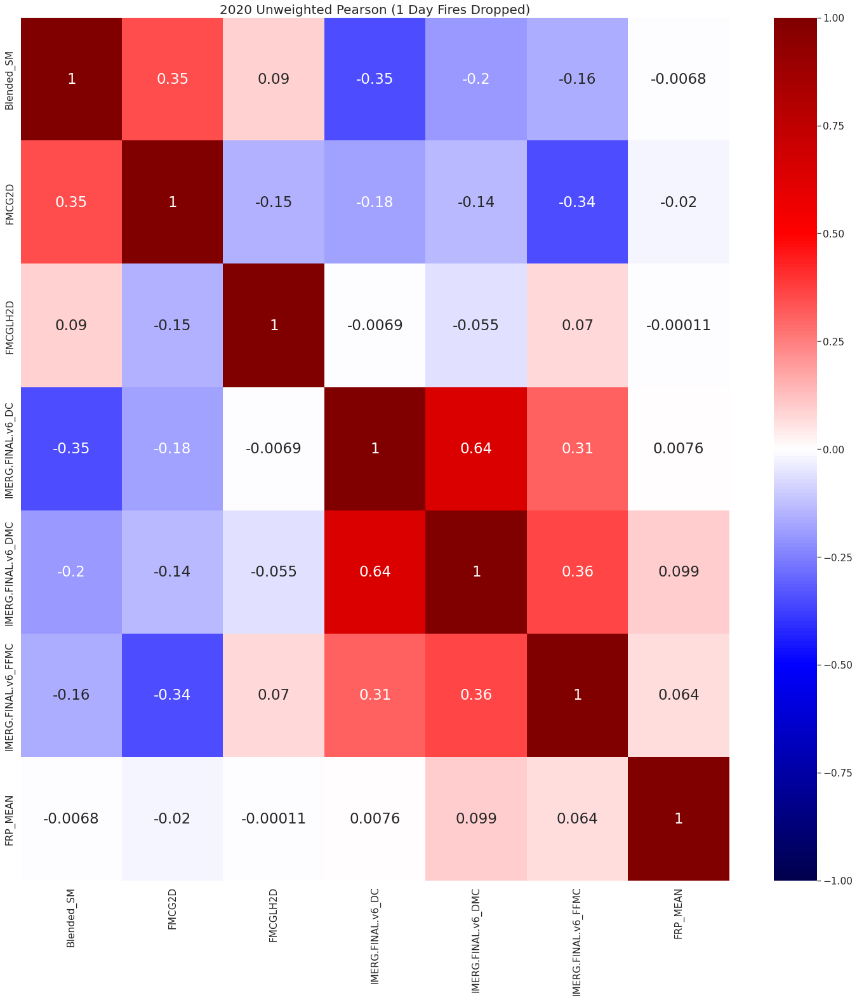

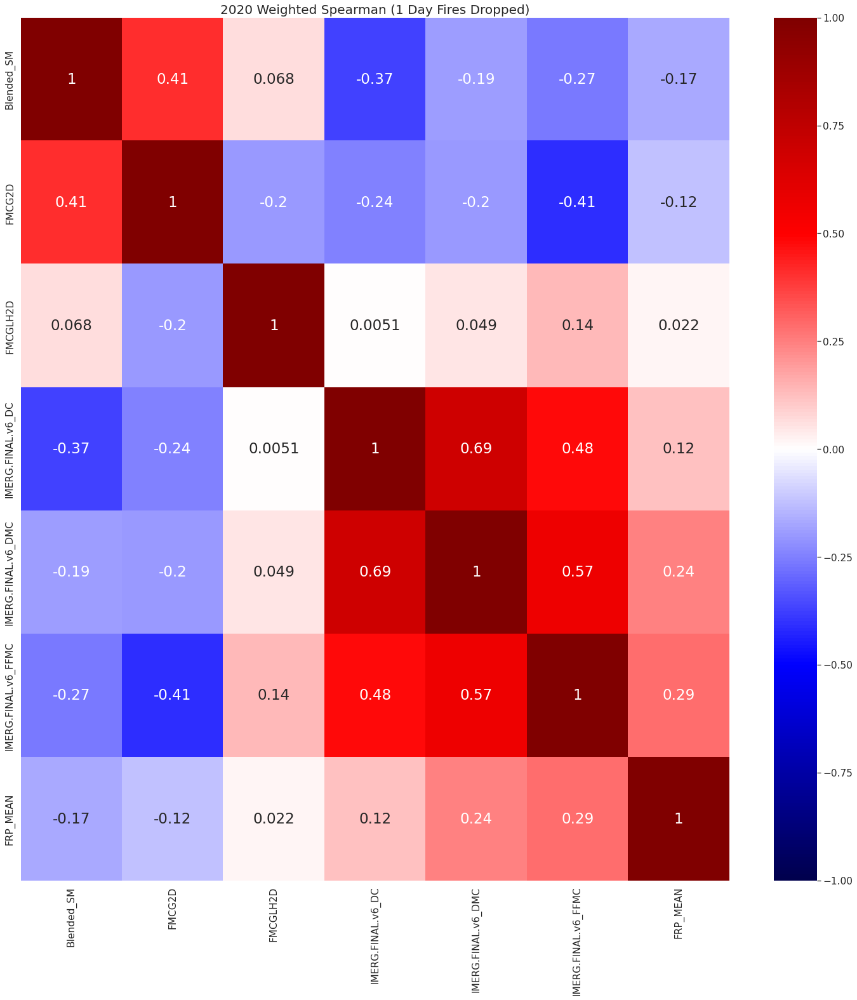

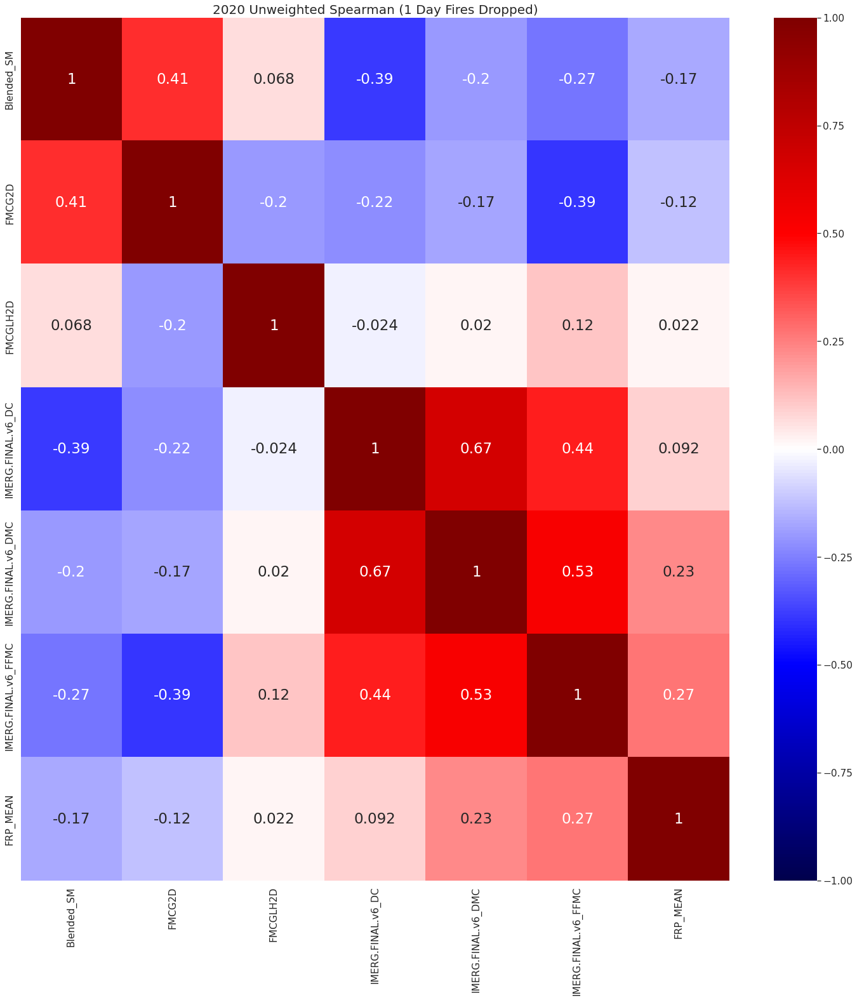

In [50]:
#correlation plots
plot_correlations(features_with_shifts_weighted[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','FRP_MEAN']], \
                  '2020 Weighted Pearson (1 Day Fires Dropped)','pearson')
plot_correlations(features_with_shifts_unweighted[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','FRP_MEAN']], \
                  '2020 Unweighted Pearson (1 Day Fires Dropped)','pearson')

plot_correlations(features_with_shifts_weighted[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','FRP_MEAN']], \
                  '2020 Weighted Spearman (1 Day Fires Dropped)','spearman')
plot_correlations(features_with_shifts_unweighted[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','FRP_MEAN']], \
                  '2020 Unweighted Spearman (1 Day Fires Dropped)','spearman')

No handles with labels found to put in legend.


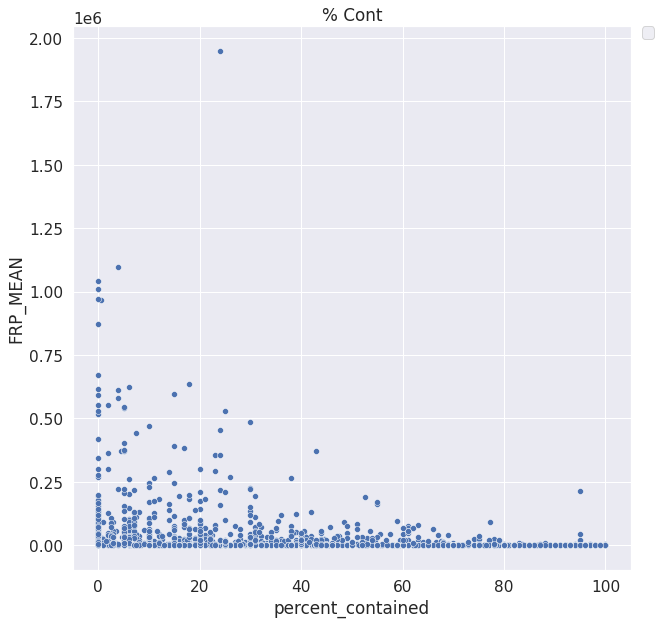

No handles with labels found to put in legend.


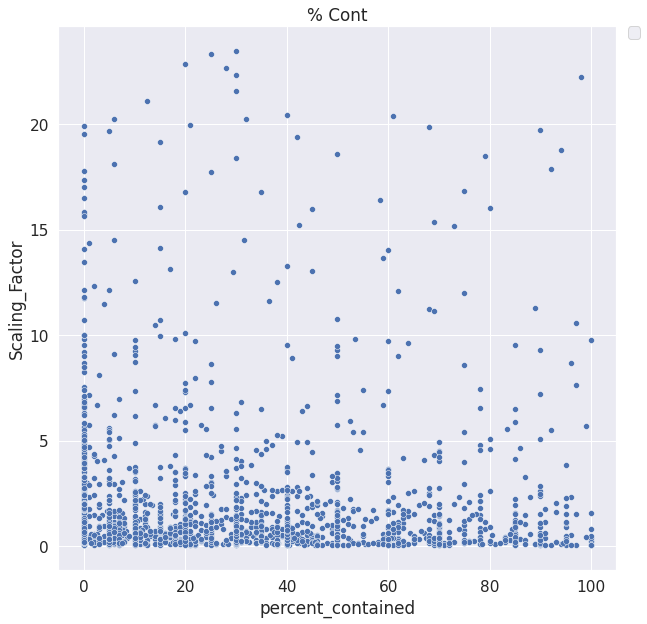

In [58]:
scatter_plot(features_unweighted_relative[features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False],'percent_contained','FRP_MEAN',None, None, None, None,'% Cont')
scatter_plot(features_unweighted_relative[features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False],'percent_contained','Scaling_Factor',None, None, None, None,'% Cont')


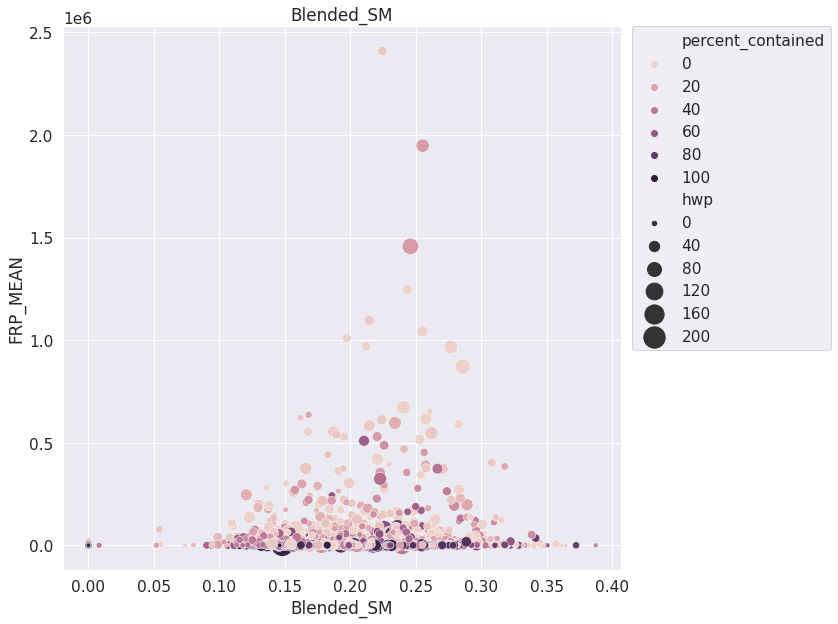

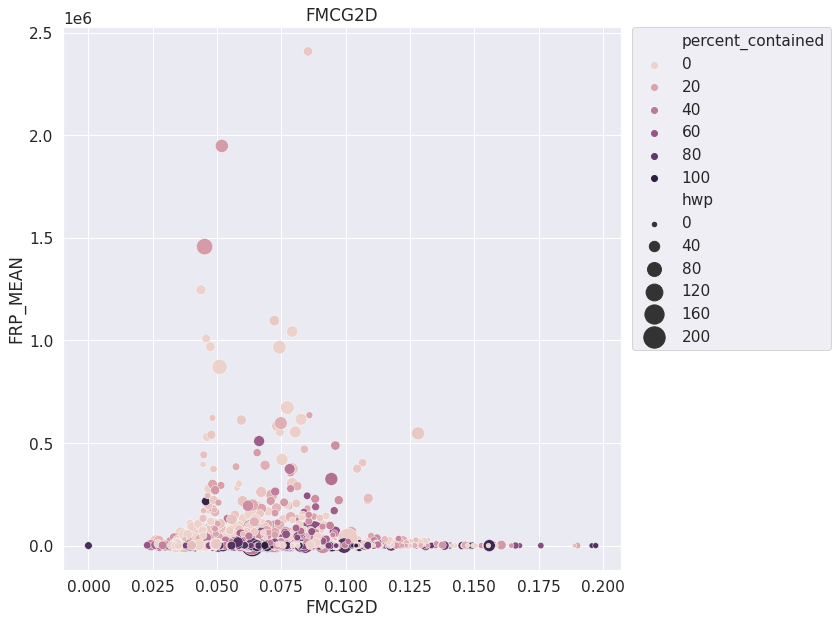

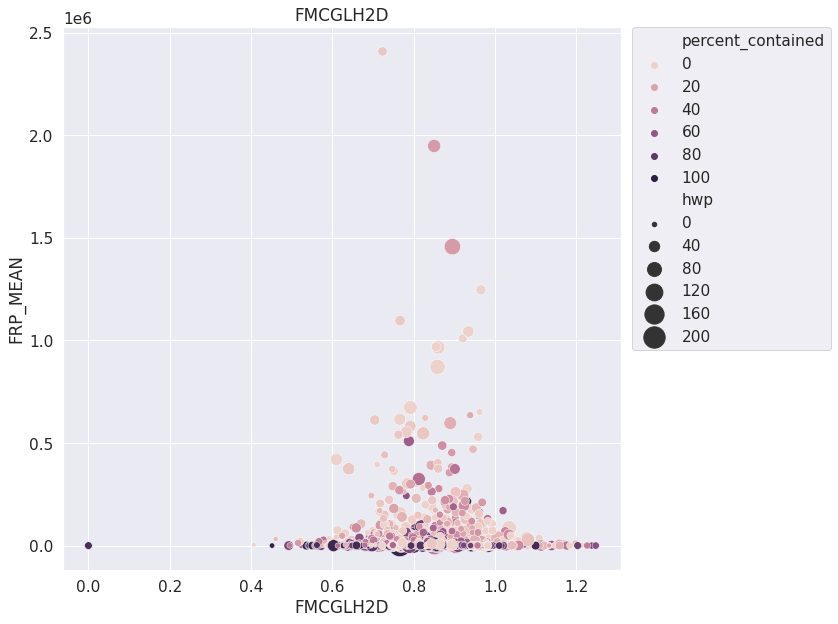

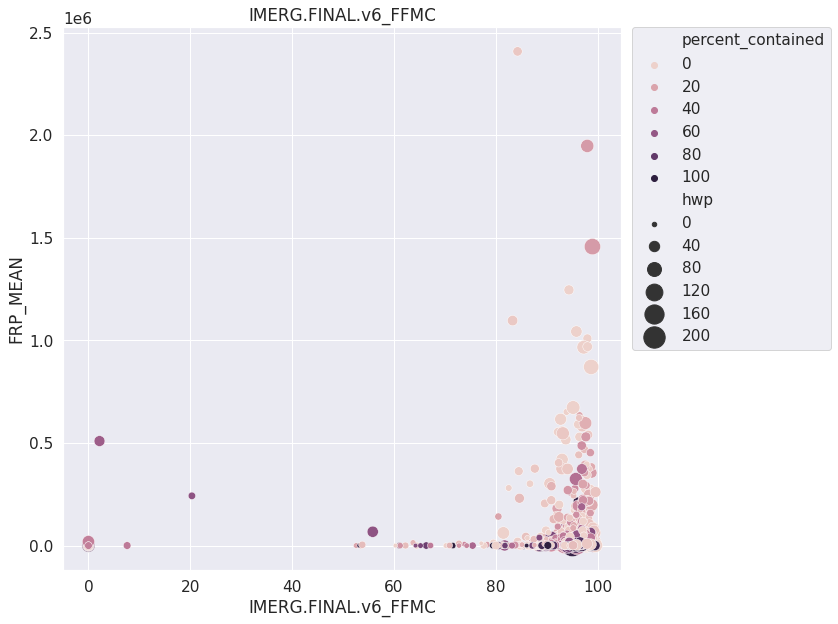

In [44]:
# scatter plots
# def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):
scatter_plot(features_weighted_2020_ge,'Blended_SM','FRP_MEAN','percent_contained', None, 'hwp', (20,500),'Blended_SM')
scatter_plot(features_weighted_2020_ge,'FMCG2D','FRP_MEAN','percent_contained', None, 'hwp', (20,500),'FMCG2D')
scatter_plot(features_weighted_2020_ge,'FMCGLH2D','FRP_MEAN','percent_contained', None, 'hwp', (20,500),'FMCGLH2D')
scatter_plot(features_weighted_2020_ge,'IMERG.FINAL.v6_FFMC','FRP_MEAN','percent_contained', None, 'hwp', (20,500),'IMERG.FINAL.v6_FFMC')

#scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):


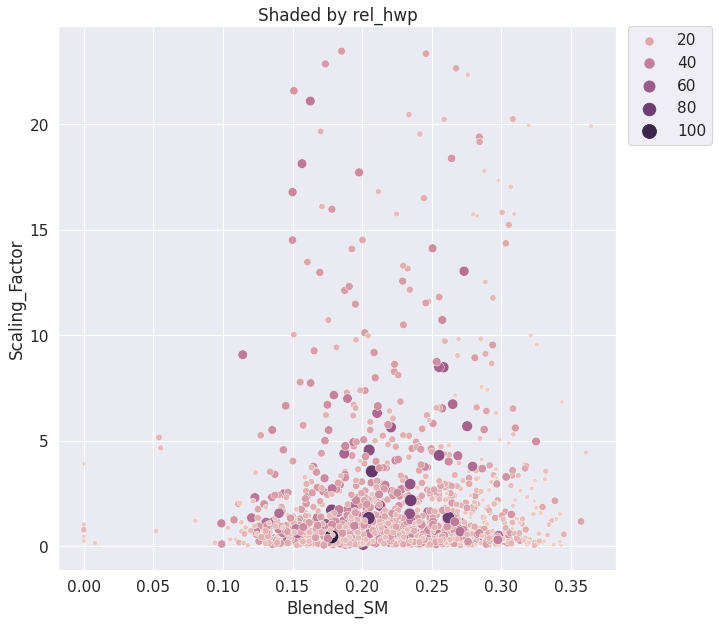

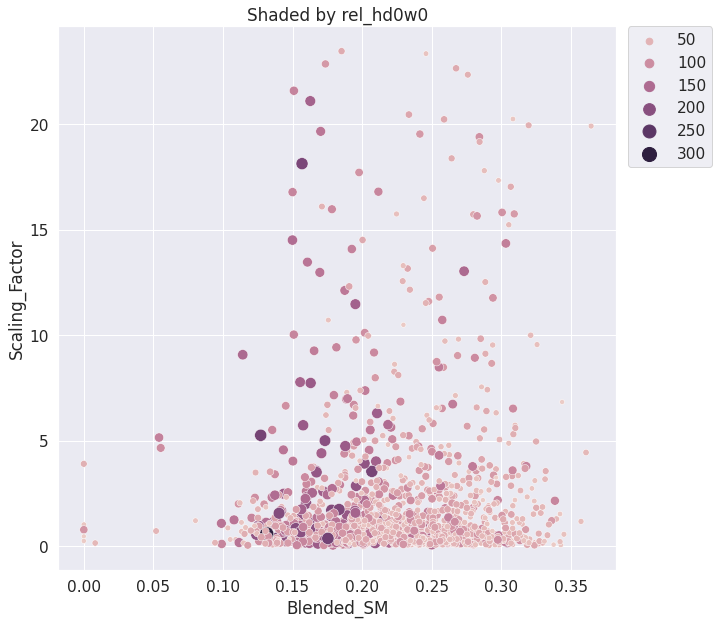

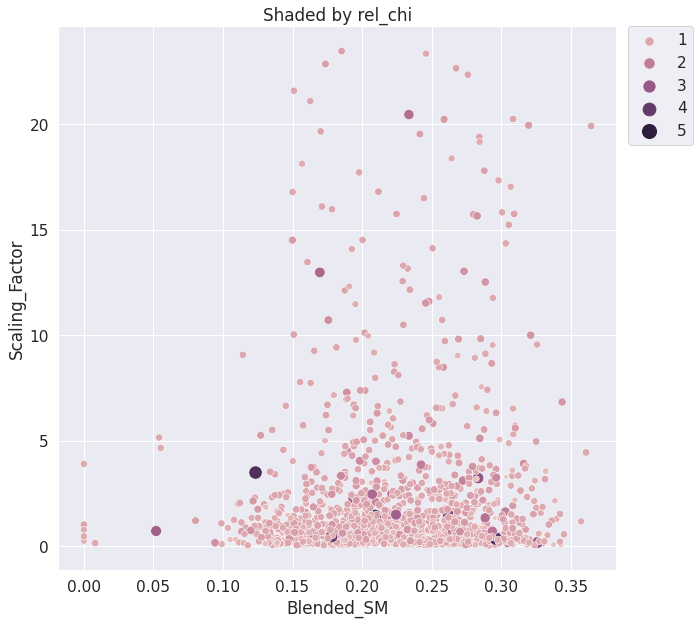

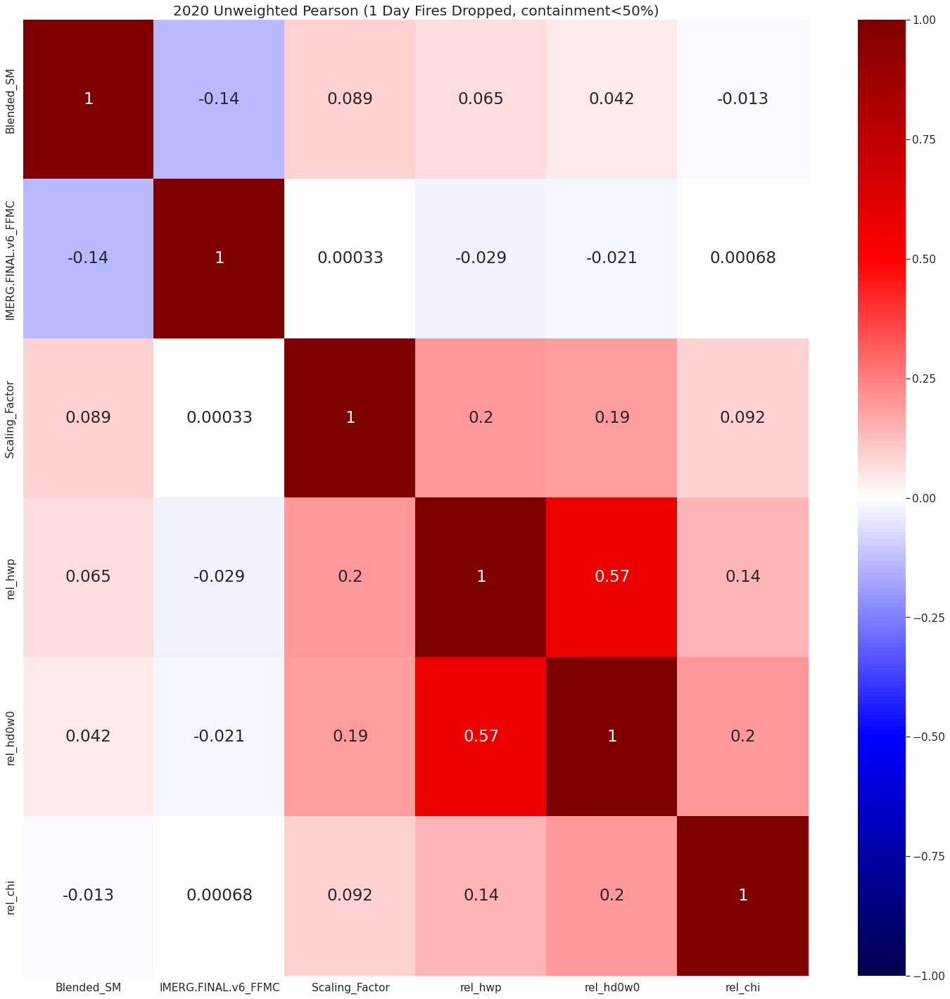

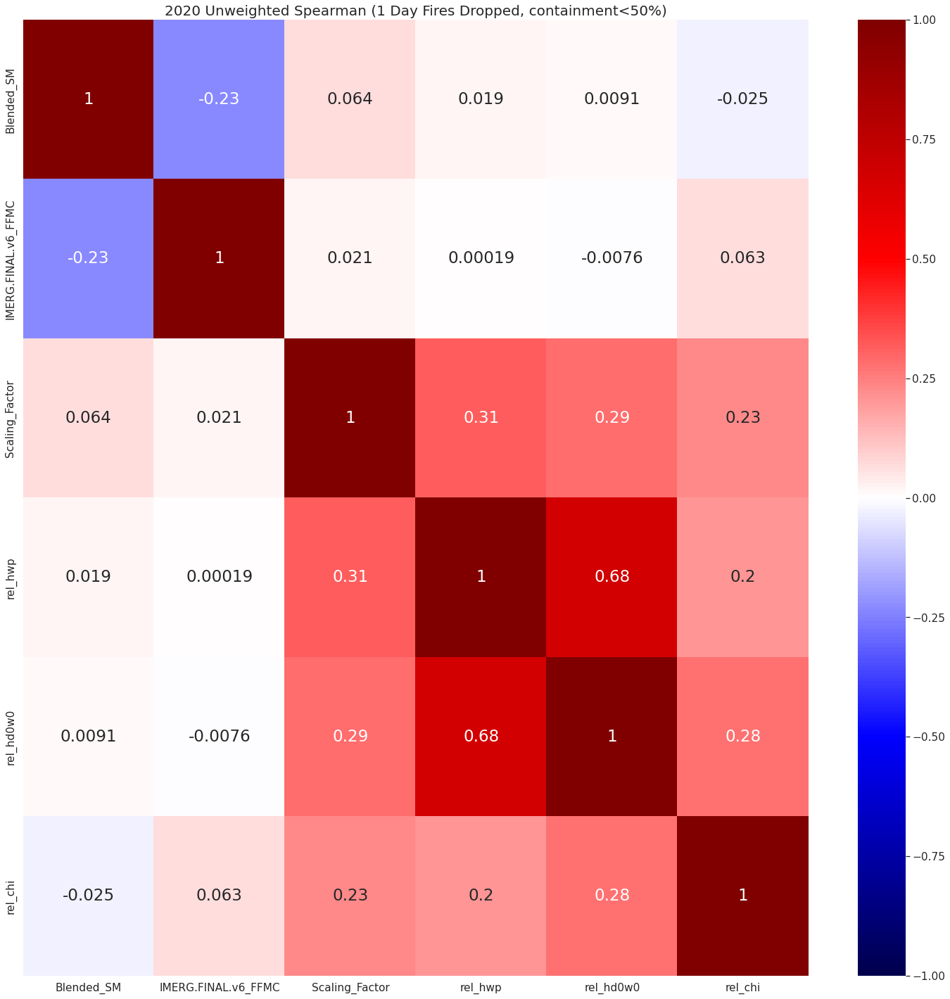

In [123]:
features_unweighted_plot = features_unweighted_relative[(features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False)&
                                                        (features_unweighted_relative['rel_hwp']<10)&
                                                        (features_unweighted_relative['rel_chi']<10)&
                                                        (features_unweighted_relative['percent_contained']<50)]

scatter_plot(features_unweighted_plot,'Blended_SM','Scaling_Factor','hwp', None, 'hwp', (20,200),'Shaded by rel_hwp')
scatter_plot(features_unweighted_plot,'Blended_SM','Scaling_Factor','hd0w0', None, 'hd0w0', (20,200),'Shaded by rel_hd0w0')
scatter_plot(features_unweighted_plot,'Blended_SM','Scaling_Factor','rel_chi', None, 'rel_chi', (20,200),'Shaded by rel_chi')


#scatter_plot(features_unweighted_relative[features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False],'IMERG.FINAL.v6_FFMC','Scaling_Factor',None, None, None, None,'FFMC')
#scatter_plot(features_unweighted_relative[features_unweighted_relative['Log_Scaling_Factor_is_outlier']==False],'rel_hwp','Scaling_Factor',None, None, None, None,'FFMC')

plot_correlations(features_unweighted_plot[['Blended_SM','IMERG.FINAL.v6_FFMC',
                                            'Scaling_Factor', 'rel_hwp', 'rel_hd0w0','rel_chi']], \
                  '2020 Unweighted Pearson (1 Day Fires Dropped, containment<50%)','pearson')

plot_correlations(features_unweighted_plot[['Blended_SM','IMERG.FINAL.v6_FFMC',
                                            'Scaling_Factor', 'rel_hwp', 'rel_hd0w0','rel_chi']], \
                  '2020 Unweighted Spearman (1 Day Fires Dropped, containment<50%)','spearman')

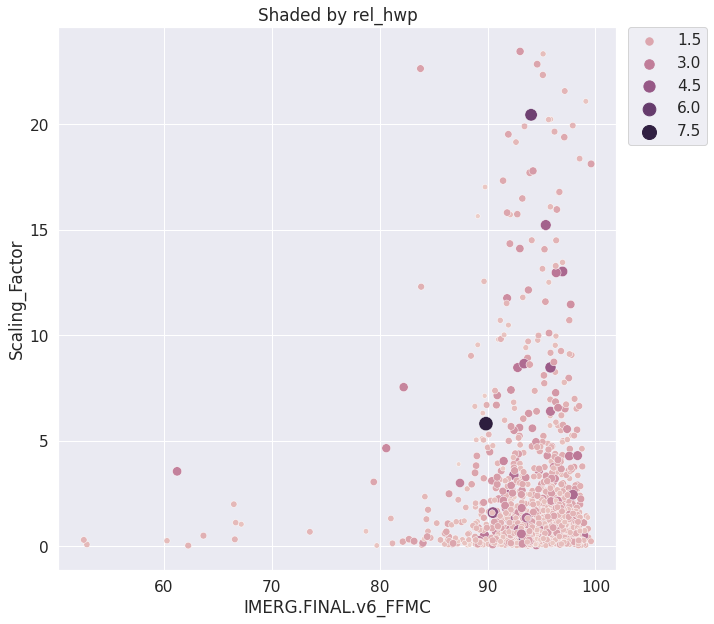

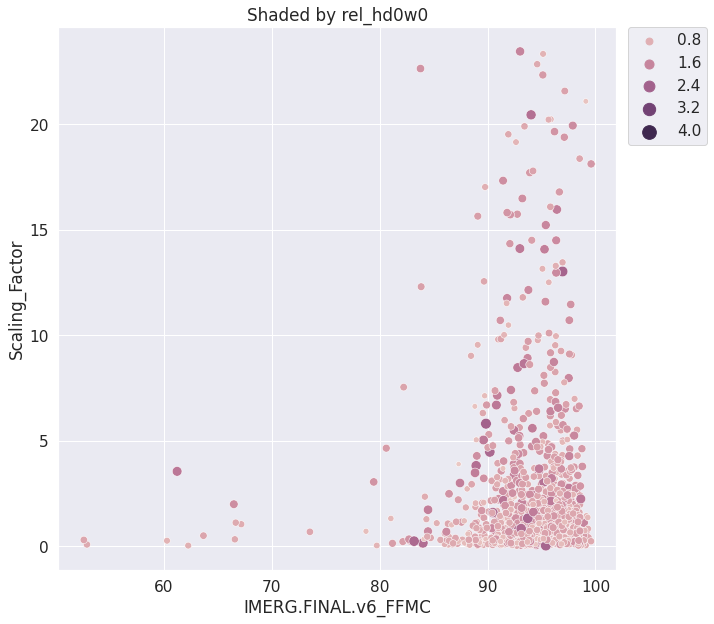

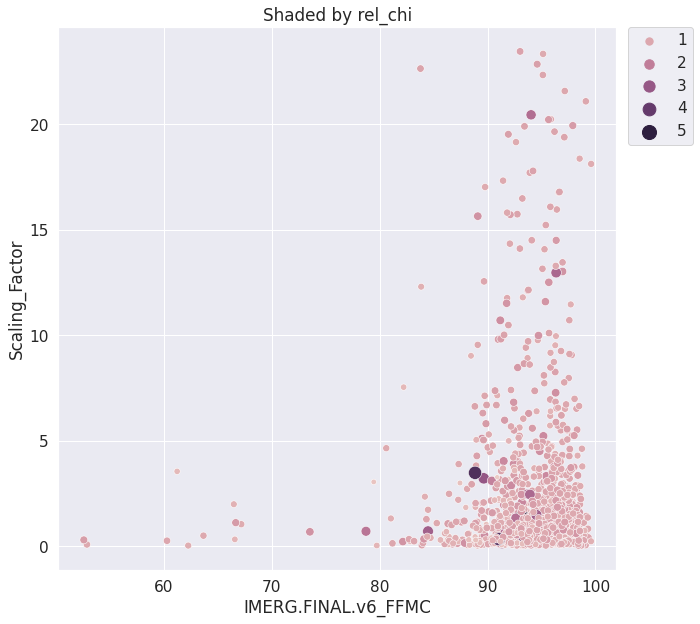

In [105]:
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_FFMC','Scaling_Factor','rel_hwp', None, 'rel_hwp', (20,200),'Shaded by rel_hwp')
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_FFMC','Scaling_Factor','rel_hd0w0', None, 'rel_hd0w0', (20,200),'Shaded by rel_hd0w0')
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_FFMC','Scaling_Factor','rel_chi', None, 'rel_chi', (20,200),'Shaded by rel_chi')


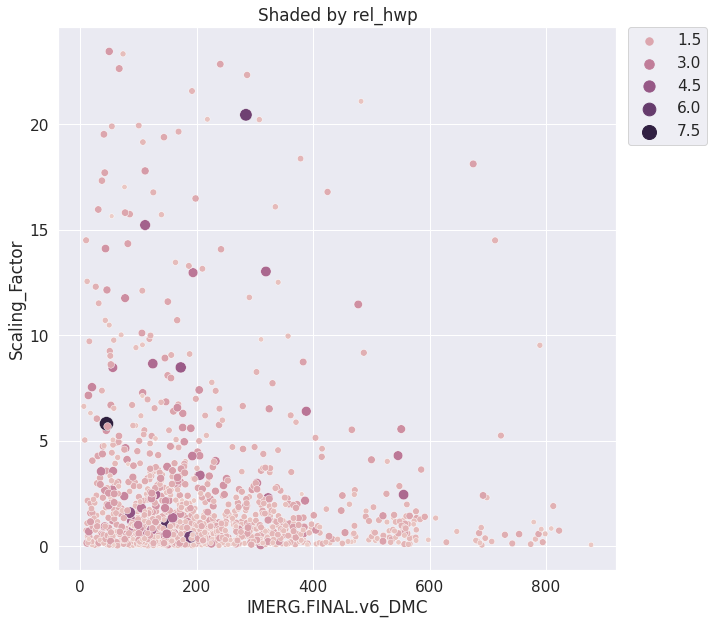

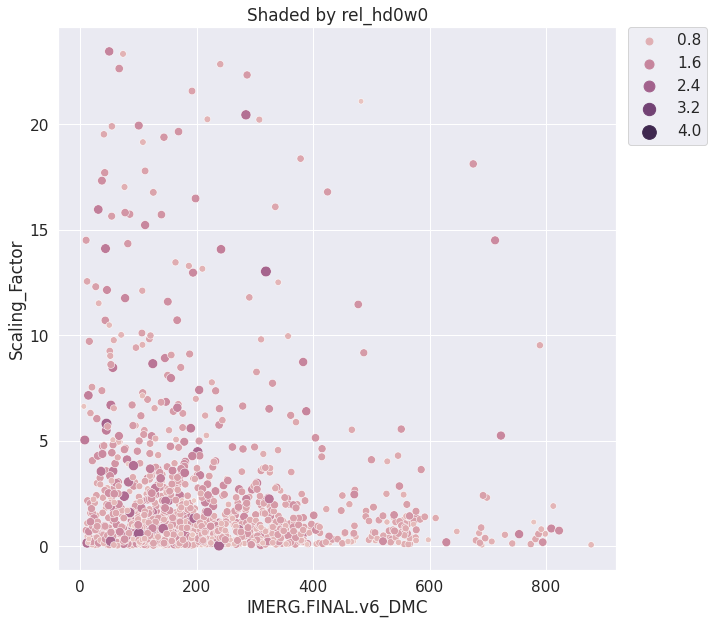

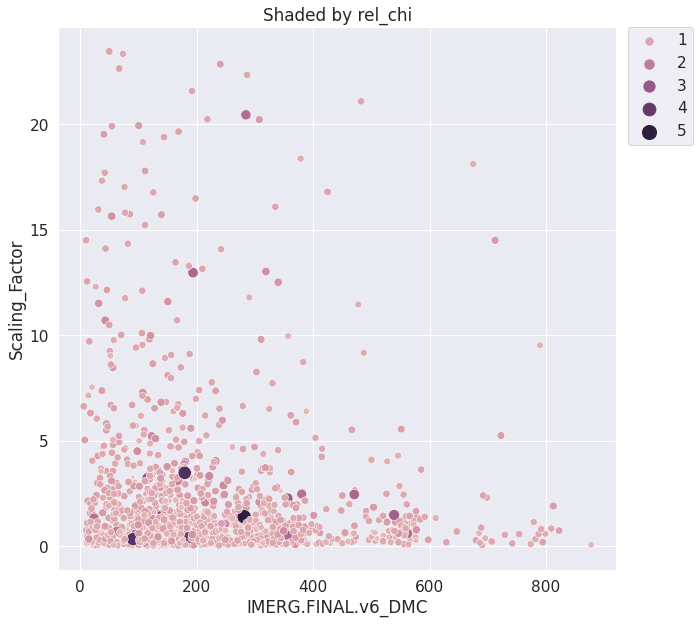

In [124]:
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_DMC','Scaling_Factor','rel_hwp', None, 'rel_hwp', (20,200),'Shaded by rel_hwp')
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_DMC','Scaling_Factor','rel_hd0w0', None, 'rel_hd0w0', (20,200),'Shaded by rel_hd0w0')
scatter_plot(features_unweighted_plot,'IMERG.FINAL.v6_DMC','Scaling_Factor','rel_chi', None, 'rel_chi', (20,200),'Shaded by rel_chi')


No handles with labels found to put in legend.


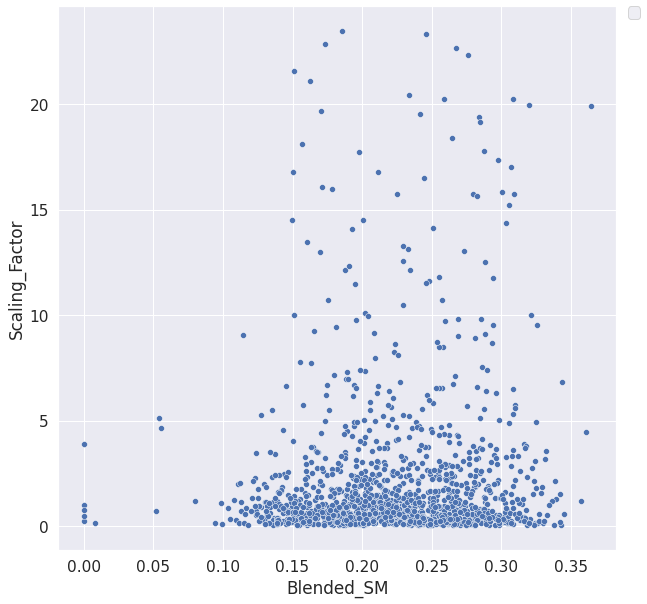

No handles with labels found to put in legend.


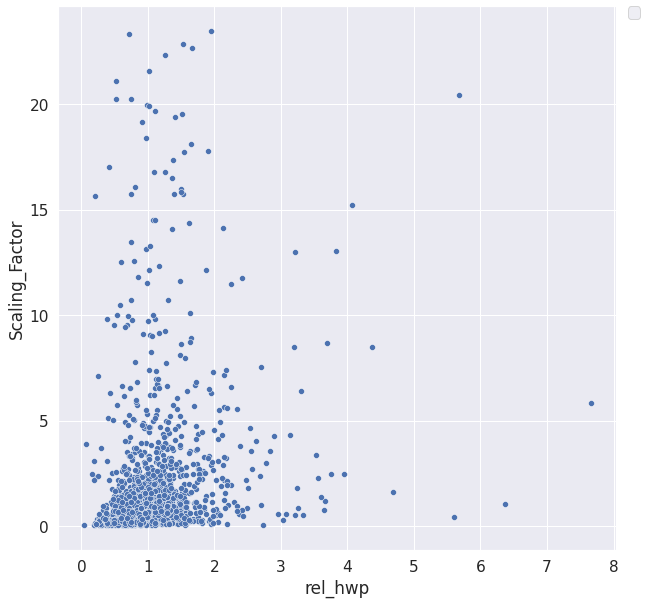

No handles with labels found to put in legend.


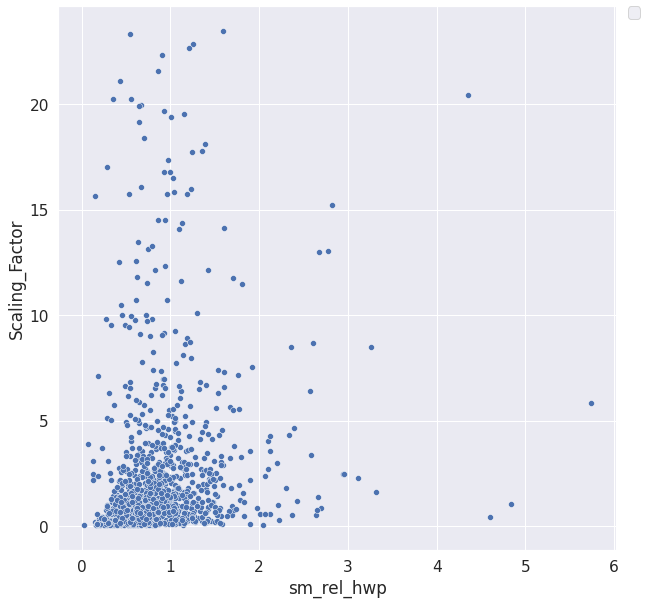

No handles with labels found to put in legend.


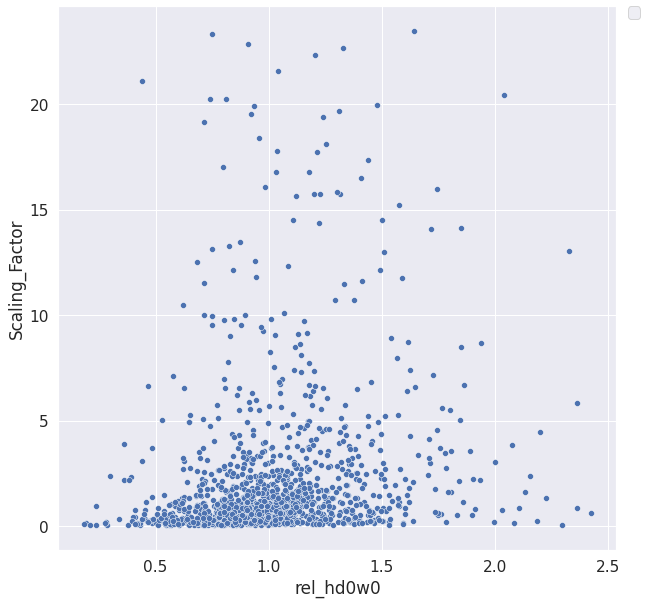

No handles with labels found to put in legend.


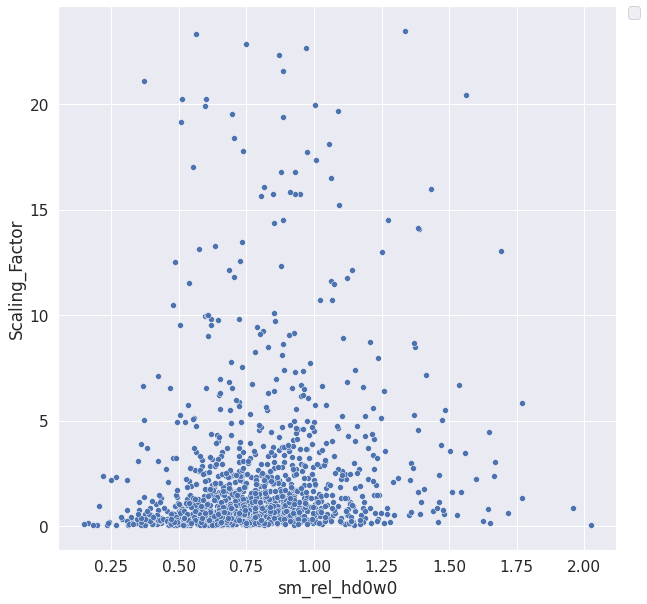

No handles with labels found to put in legend.


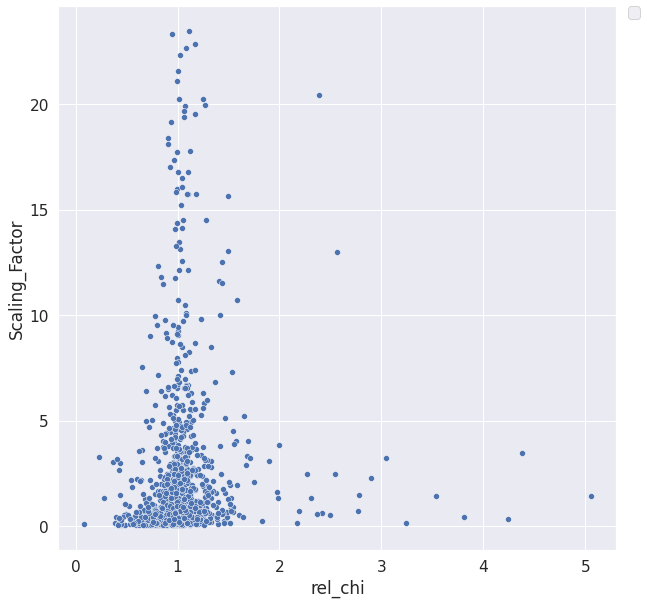

No handles with labels found to put in legend.


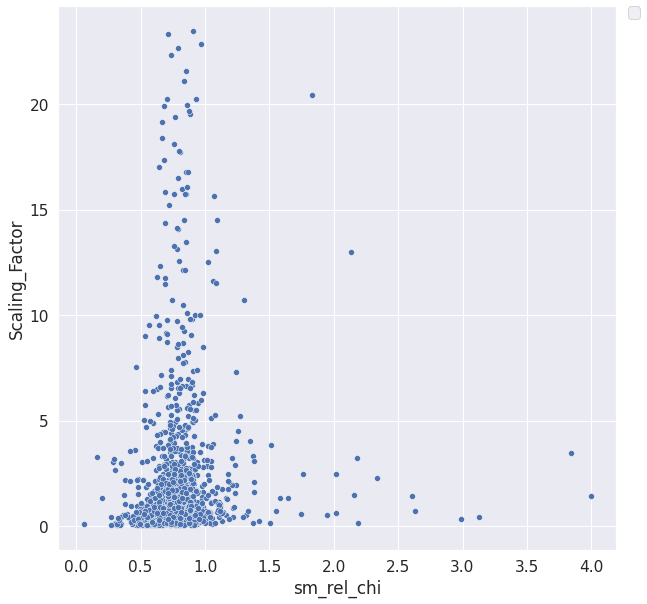

In [115]:
features_unweighted_plot['sm_rel_hwp'] = (1-features_unweighted_plot['Blended_SM'])*features_unweighted_plot['rel_hwp']
features_unweighted_plot['sm_rel_hd0w0'] = (1-features_unweighted_plot['Blended_SM'])*features_unweighted_plot['rel_hd0w0']
features_unweighted_plot['sm_rel_chi'] = (1-features_unweighted_plot['Blended_SM'])*features_unweighted_plot['rel_chi']

features_unweighted_plot['sm_rel_hwp_chi'] = (1-features_unweighted_plot['Blended_SM'])*features_unweighted_plot['rel_hwp']*features_unweighted_plot['rel_chi']



scatter_plot(features_unweighted_plot,'Blended_SM','Scaling_Factor',None, None, None, None,'')
scatter_plot(features_unweighted_plot,'rel_hwp','Scaling_Factor',None, None, None, None,'')
scatter_plot(features_unweighted_plot,'sm_rel_hwp','Scaling_Factor',None, None, None, None,'')

scatter_plot(features_unweighted_plot,'rel_hd0w0','Scaling_Factor',None, None, None, None,'')
scatter_plot(features_unweighted_plot,'sm_rel_hd0w0','Scaling_Factor',None, None, None, None,'')

scatter_plot(features_unweighted_plot,'rel_chi','Scaling_Factor',None, None, None, None,'')
scatter_plot(features_unweighted_plot,'sm_rel_chi','Scaling_Factor',None, None, None, None,'')



No handles with labels found to put in legend.


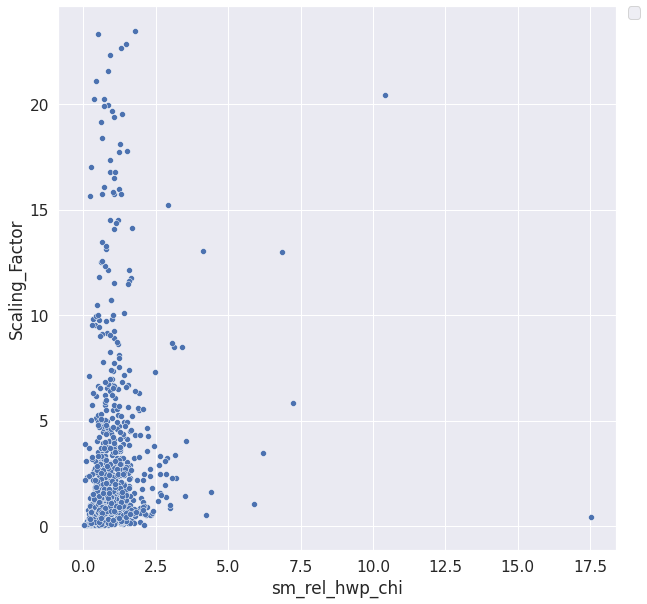

In [116]:
scatter_plot(features_unweighted_plot,'sm_rel_hwp_chi','Scaling_Factor',None, None, None, None,'')


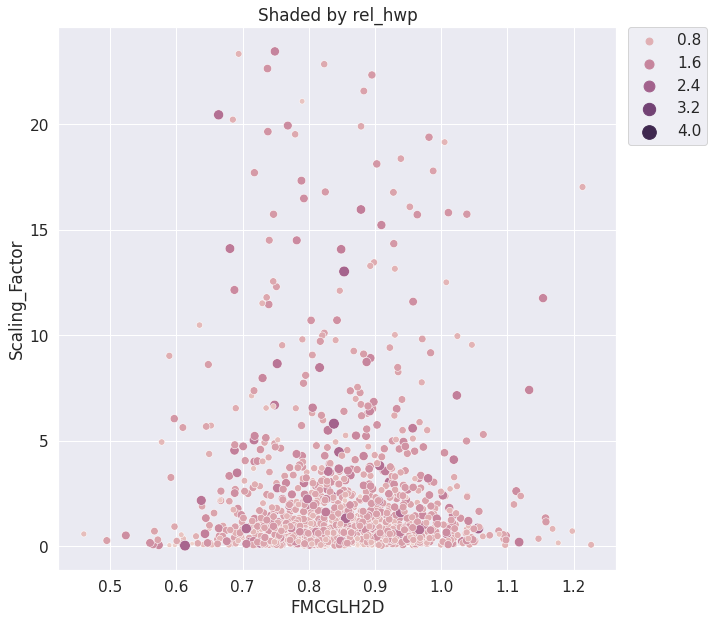

In [122]:
scatter_plot(features_unweighted_plot,'FMCGLH2D','Scaling_Factor','rel_hd0w0', None, 'rel_hd0w0', (20,200),'Shaded by rel_hwp')


### All Features

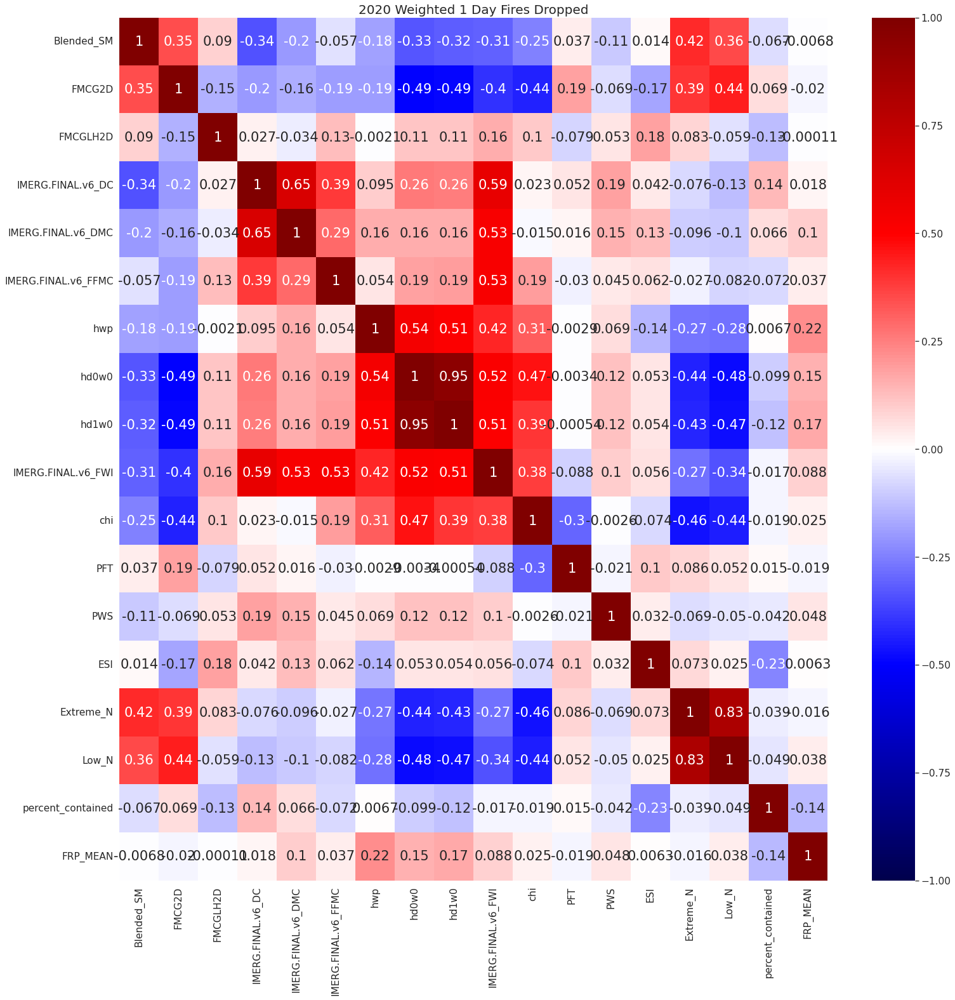

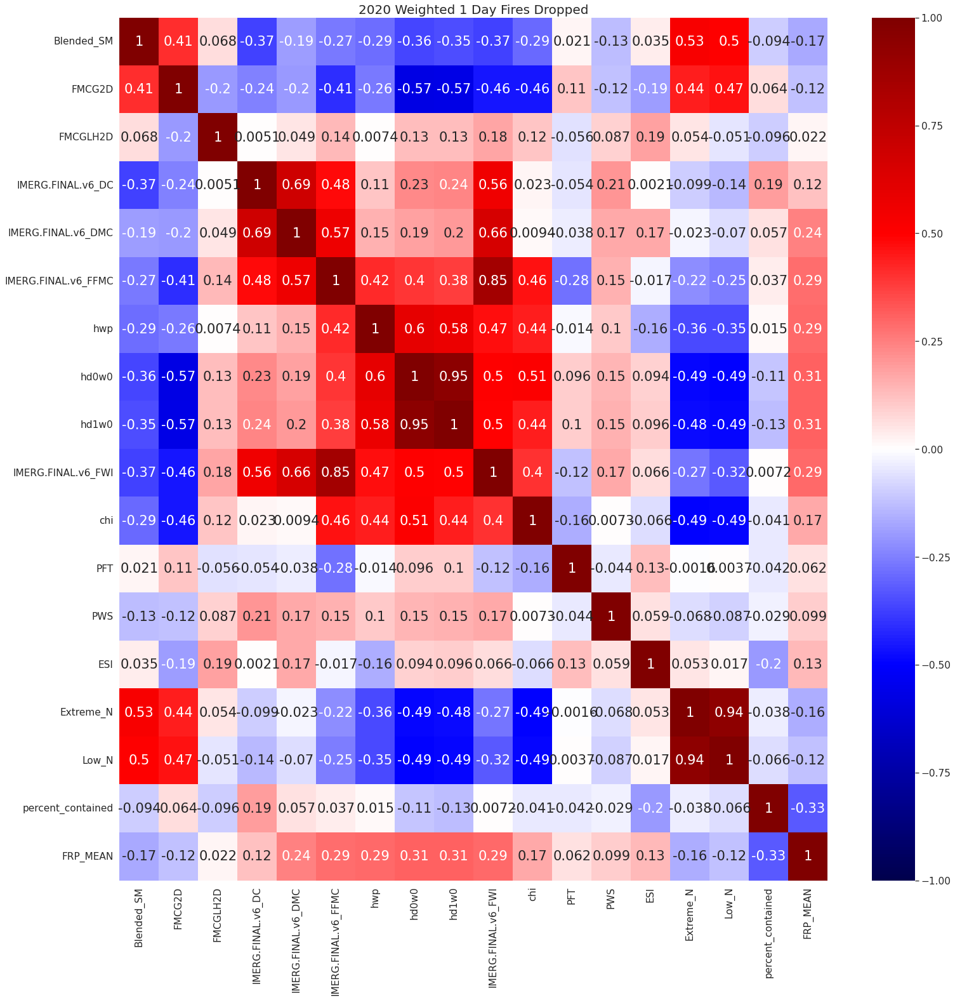

In [90]:
plot_correlations(features_weighted_2020_ge[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 Weighted 1 Day Fires Dropped','pearson')
plot_correlations(features_weighted_2020_ge[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 Weighted 1 Day Fires Dropped','spearman')

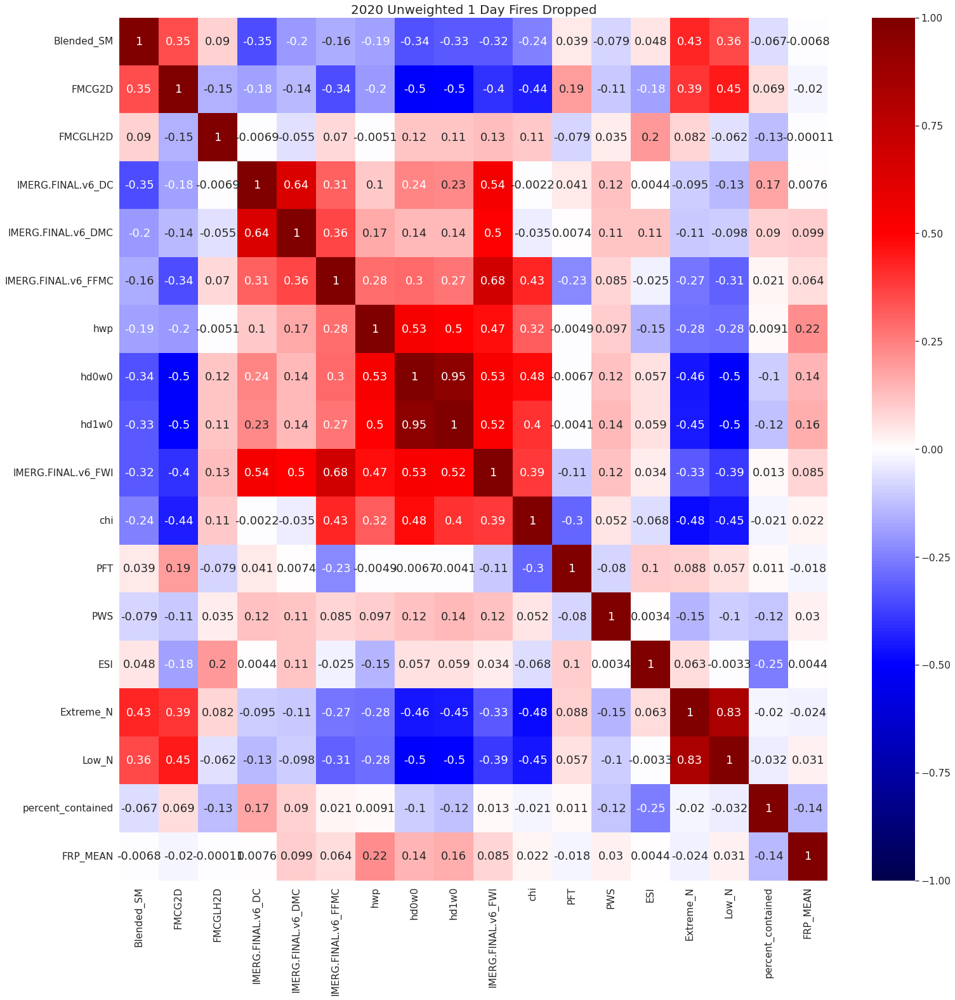

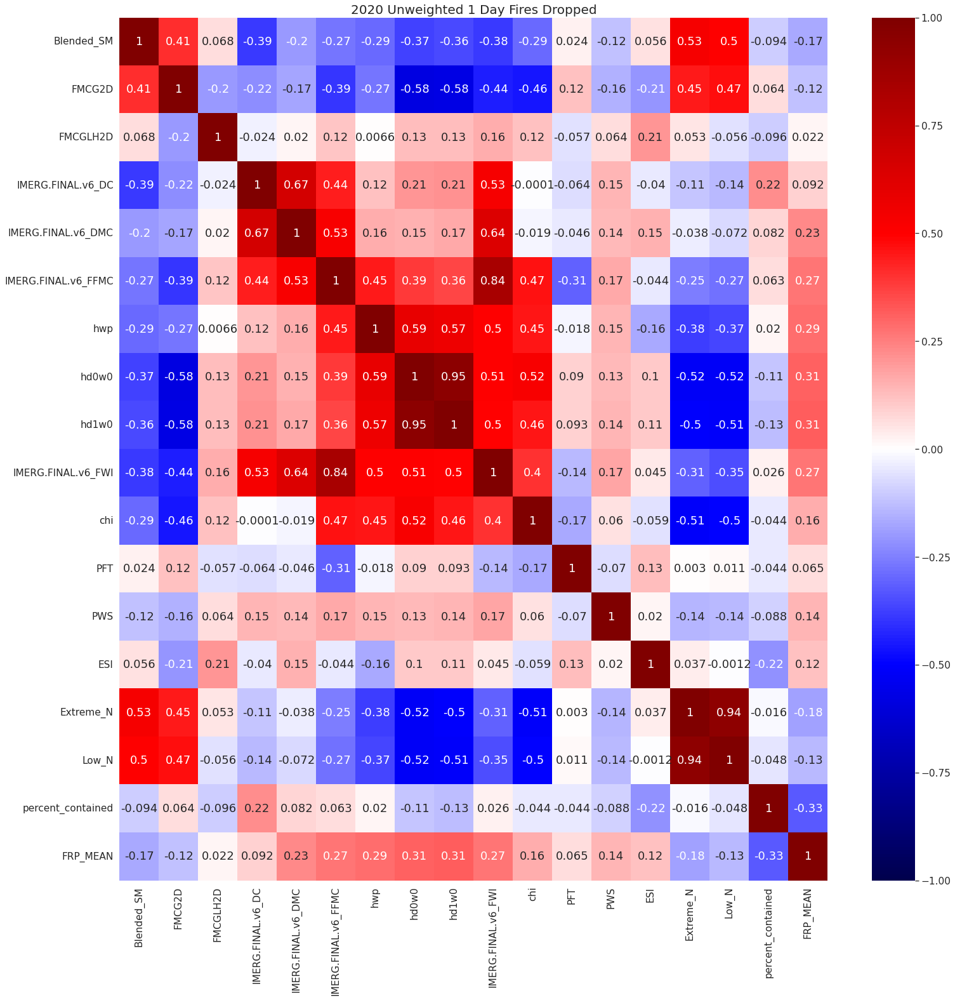

In [25]:
plot_correlations(features_unweighted_2020_ge[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 Unweighted 1 Day Fires Dropped','pearson')
plot_correlations(features_unweighted_2020_ge[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 Unweighted 1 Day Fires Dropped','spearman')

In [19]:
#get the scaling factor
features_with_shifts_weighted['Scaling_Factor'] = features_with_shifts_weighted['FRP_MEAN']/features_with_shifts_weighted['FRP_MEAN_1']
features_with_shifts_unweighted['Scaling_Factor'] = features_with_shifts_unweighted['FRP_MEAN']/features_with_shifts_unweighted['FRP_MEAN_1']

#get the log of the scaling factor
features_with_shifts_weighted['Log_Scaling_Factor']= np.log10(features_with_shifts_weighted['Scaling_Factor'])
features_with_shifts_unweighted['Log_Scaling_Factor']= np.log10(features_with_shifts_unweighted['Scaling_Factor'])

#get the outliers
features_with_shifts_weighted = find_outliers(features_with_shifts_weighted, 'Log_Scaling_Factor')
print(len(features_with_shifts_weighted[features_with_shifts_weighted['Log_Scaling_Factor_is_outlier']==False]))

features_with_shifts_unweighted = find_outliers(features_with_shifts_unweighted, 'Log_Scaling_Factor')
print(len(features_with_shifts_unweighted[features_with_shifts_unweighted['Log_Scaling_Factor_is_outlier']==False]))

3206
3206


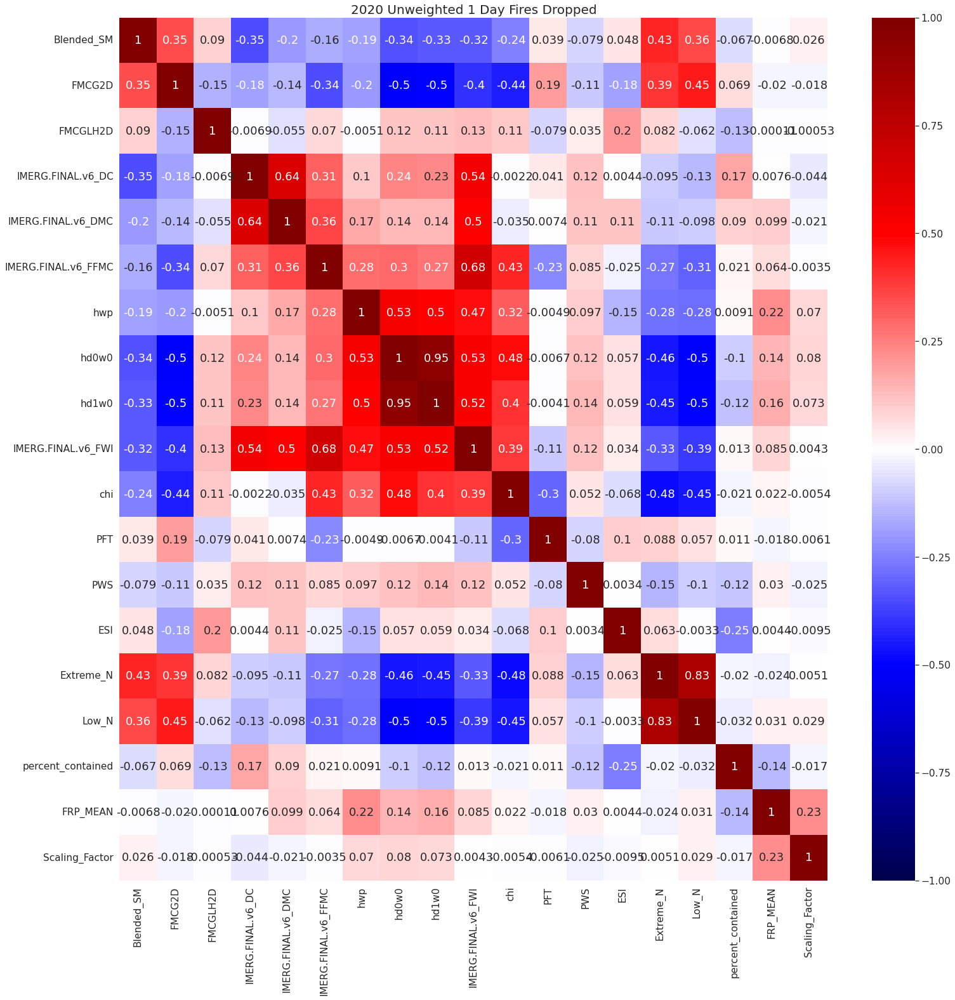

In [24]:
plot_correlations(features_with_shifts_unweighted[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN', 'Scaling_Factor']], \
                  '2020 Unweighted 1 Day Fires Dropped','pearson')

In [109]:
print(features_with_shifts_unweighted.columns.values)

['datetime' 'irwinID' 'day' 'FRP_MEAN' 'Blended_SM' 'hd0w0' 'hd1w0'
 'hd2w0' 'hd3w0' 'hwp' 'IMERG.FINAL.v6_DC' 'IMERG.FINAL.v6_DMC'
 'IMERG.FINAL.v6_FFMC' 'IMERG.FINAL.v6_ISI' 'IMERG.FINAL.v6_BUI'
 'IMERG.FINAL.v6_FWI' 'IMERG.FINAL.v6_DSR' 'PWS' 'Extreme_N' 'VeryHigh_N'
 'High_N' 'Moderate_N' 'Low_N' 'FMCG2D' 'FMCGLH2D' 'ESI' 'U_ml' 'z_fc'
 'dtheta_fc' 'PFT' 'temp_850' 'temp_700' 'dewpt_850' 'ca' 'cb' 'chi'
 'percent_contained' 'FRP_MEAN_1' 'Blended_SM_1' 'hd0w0_1' 'hd1w0_1'
 'hd2w0_1' 'hd3w0_1' 'hwp_1' 'IMERG.FINAL.v6_DC_1' 'IMERG.FINAL.v6_DMC_1'
 'IMERG.FINAL.v6_FFMC_1' 'IMERG.FINAL.v6_ISI_1' 'IMERG.FINAL.v6_BUI_1'
 'IMERG.FINAL.v6_FWI_1' 'IMERG.FINAL.v6_DSR_1' 'PWS_1' 'Extreme_N_1'
 'VeryHigh_N_1' 'High_N_1' 'Moderate_N_1' 'Low_N_1' 'FMCG2D_1'
 'FMCGLH2D_1' 'ESI_1' 'U_ml_1' 'z_fc_1' 'dtheta_fc_1' 'PFT_1' 'temp_850_1'
 'temp_700_1' 'dewpt_850_1' 'ca_1' 'cb_1' 'chi_1' 'percent_contained_1'
 'Scaling_Factor' 'Log_Scaling_Factor' 'Log_Scaling_Factor_is_outlier']


In [20]:
def get_relative_features(df, names): #to today/yesterday, flip it later
    for name in names:
        df['rel_'+name] = df[name]/df[name+'_1']
    return df

In [21]:
features_relative =['hd0w0', 'hd1w0','hd2w0', 'hd3w0', 'hwp', #weather
                    'IMERG.FINAL.v6_FWI','IMERG.FINAL.v6_ISI', 'IMERG.FINAL.v6_BUI', 'IMERG.FINAL.v6_DSR', #weather
                    'IMERG.FINAL.v6_DC', 'IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','Blended_SM', #moisture
                    'FMCG2D', 'FMCGLH2D', #moisture
                    'Extreme_N', 'VeryHigh_N','High_N', 'Moderate_N', 'Low_N', #fuel  
                   'PWS',  'ESI', #ecosystem
                    'PFT', 'chi' #stability
                   ]
features_weighted_relative = get_relative_features(features_with_shifts_weighted, features_relative)
features_unweighted_relative = get_relative_features(features_with_shifts_unweighted, features_relative)

print(features_weighted_relative.columns.values)

['datetime' 'irwinID' 'day' 'FRP_MEAN' 'Blended_SM' 'hd0w0' 'hd1w0'
 'hd2w0' 'hd3w0' 'hwp' 'IMERG.FINAL.v6_DC' 'IMERG.FINAL.v6_DMC'
 'IMERG.FINAL.v6_FFMC' 'IMERG.FINAL.v6_ISI' 'IMERG.FINAL.v6_BUI'
 'IMERG.FINAL.v6_FWI' 'IMERG.FINAL.v6_DSR' 'PWS' 'Extreme_N' 'VeryHigh_N'
 'High_N' 'Moderate_N' 'Low_N' 'FMCG2D' 'FMCGLH2D' 'ESI' 'U_ml' 'z_fc'
 'dtheta_fc' 'PFT' 'temp_850' 'temp_700' 'dewpt_850' 'ca' 'cb' 'chi'
 'percent_contained' 'irwinID_1' 'day_1' 'FRP_MEAN_1' 'Blended_SM_1'
 'hd0w0_1' 'hd1w0_1' 'hd2w0_1' 'hd3w0_1' 'hwp_1' 'IMERG.FINAL.v6_DC_1'
 'IMERG.FINAL.v6_DMC_1' 'IMERG.FINAL.v6_FFMC_1' 'IMERG.FINAL.v6_ISI_1'
 'IMERG.FINAL.v6_BUI_1' 'IMERG.FINAL.v6_FWI_1' 'IMERG.FINAL.v6_DSR_1'
 'PWS_1' 'Extreme_N_1' 'VeryHigh_N_1' 'High_N_1' 'Moderate_N_1' 'Low_N_1'
 'FMCG2D_1' 'FMCGLH2D_1' 'ESI_1' 'U_ml_1' 'z_fc_1' 'dtheta_fc_1' 'PFT_1'
 'temp_850_1' 'temp_700_1' 'dewpt_850_1' 'ca_1' 'cb_1' 'chi_1'
 'percent_contained_1' 'Scaling_Factor' 'Log_Scaling_Factor'
 'Log_Scaling_Factor_is_outlier' 'rel

['rel_hd0w0', 'rel_hd1w0', 'rel_hd2w0', 'rel_hd3w0', 'rel_hwp', 'rel_IMERG.FINAL.v6_FWI', 'rel_IMERG.FINAL.v6_ISI', 'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR', 'Scaling_Factor']


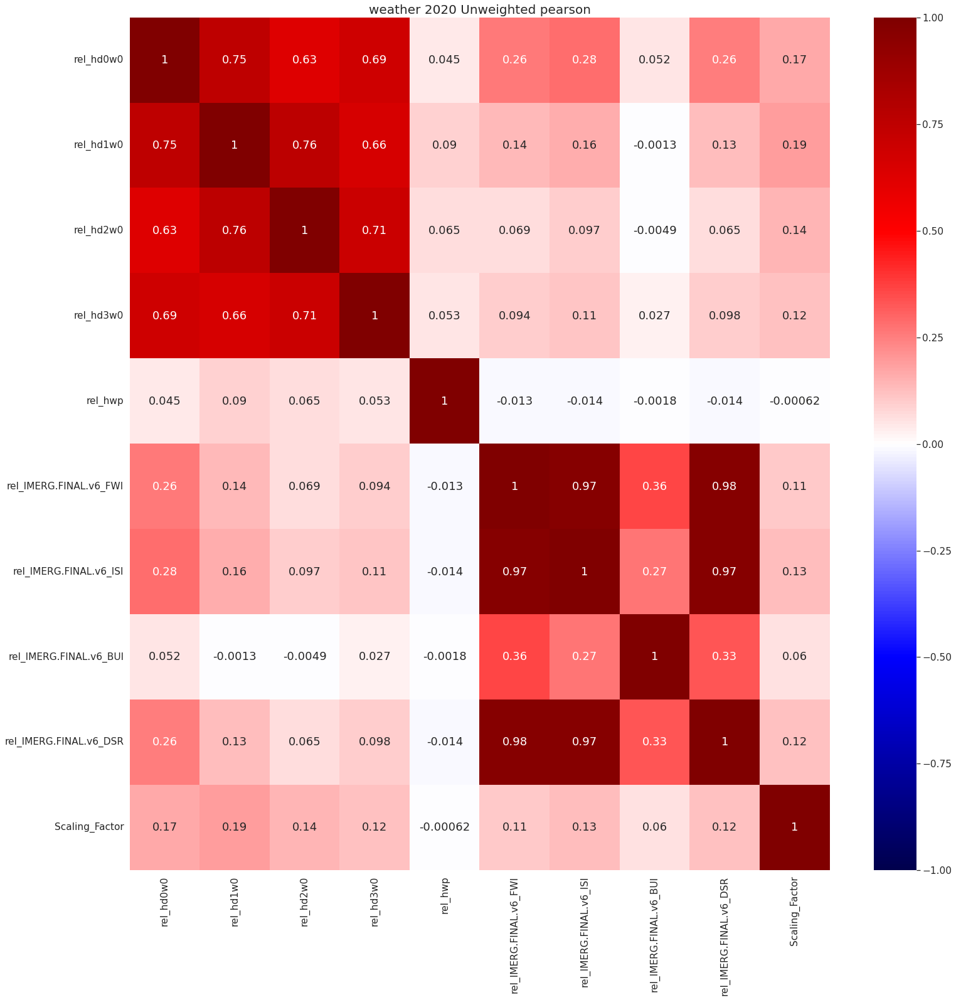

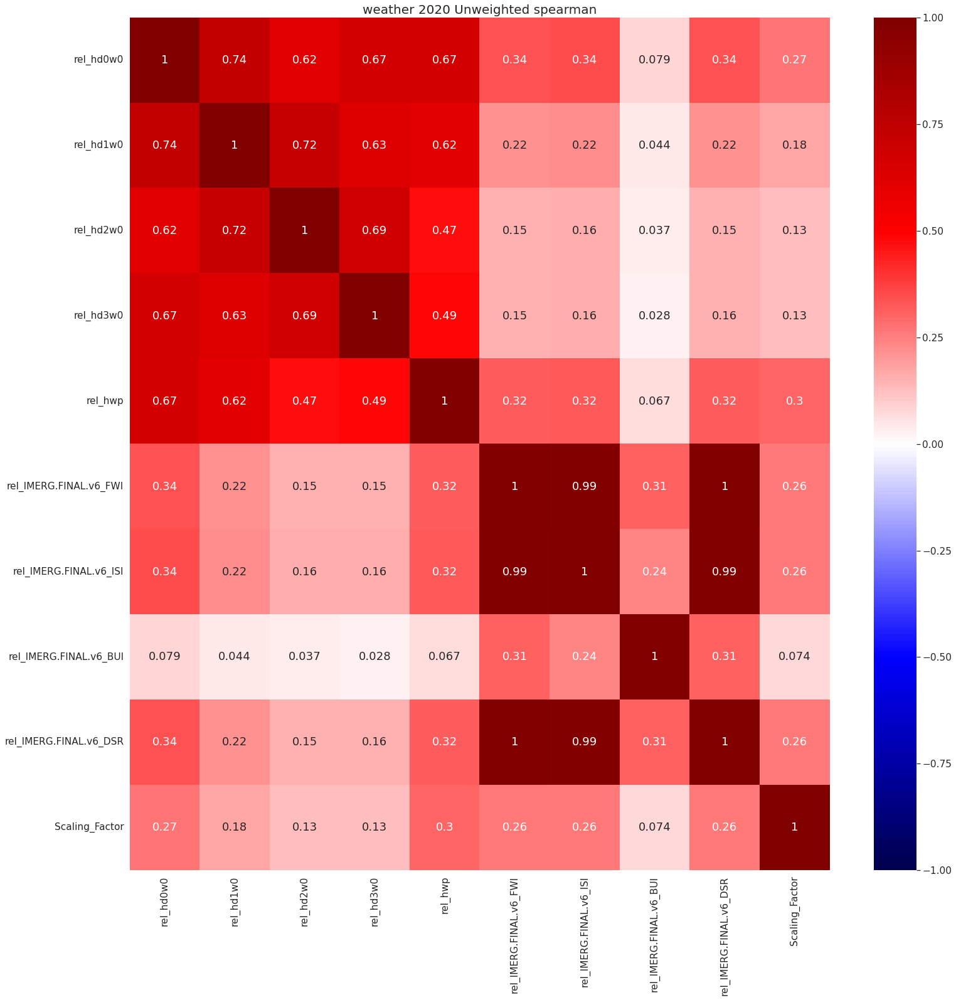

['rel_IMERG.FINAL.v6_DC', 'rel_IMERG.FINAL.v6_DMC', 'rel_IMERG.FINAL.v6_FFMC', 'rel_Blended_SM', 'rel_FMCG2D', 'rel_FMCGLH2D', 'Scaling_Factor']


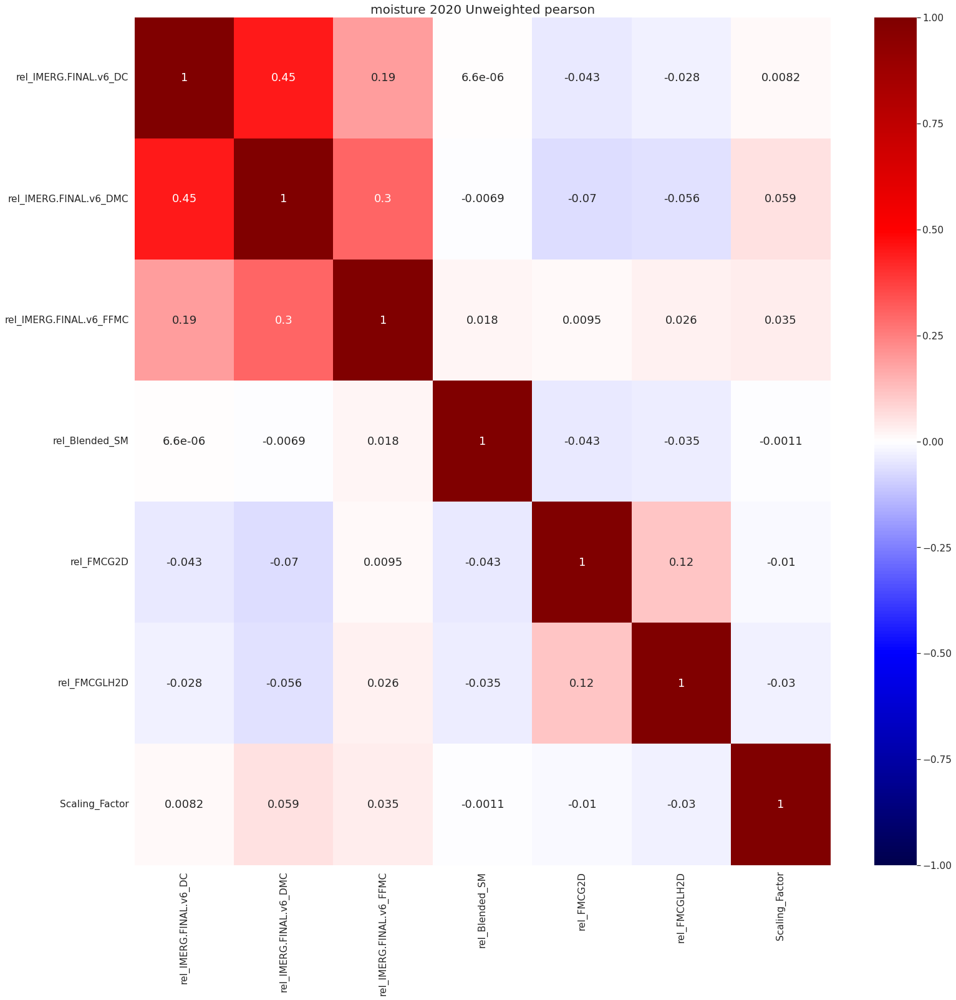

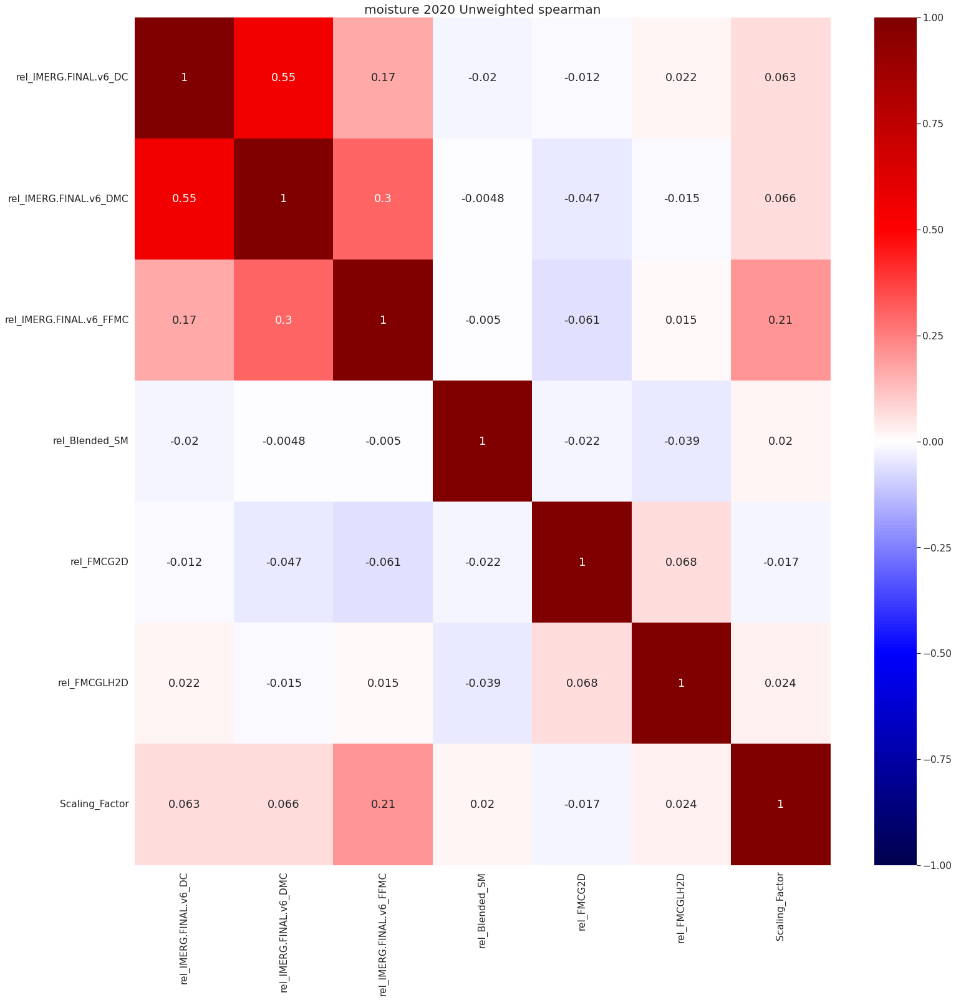

['rel_Extreme_N', 'rel_VeryHigh_N', 'rel_High_N', 'rel_Moderate_N', 'rel_Low_N', 'Scaling_Factor']


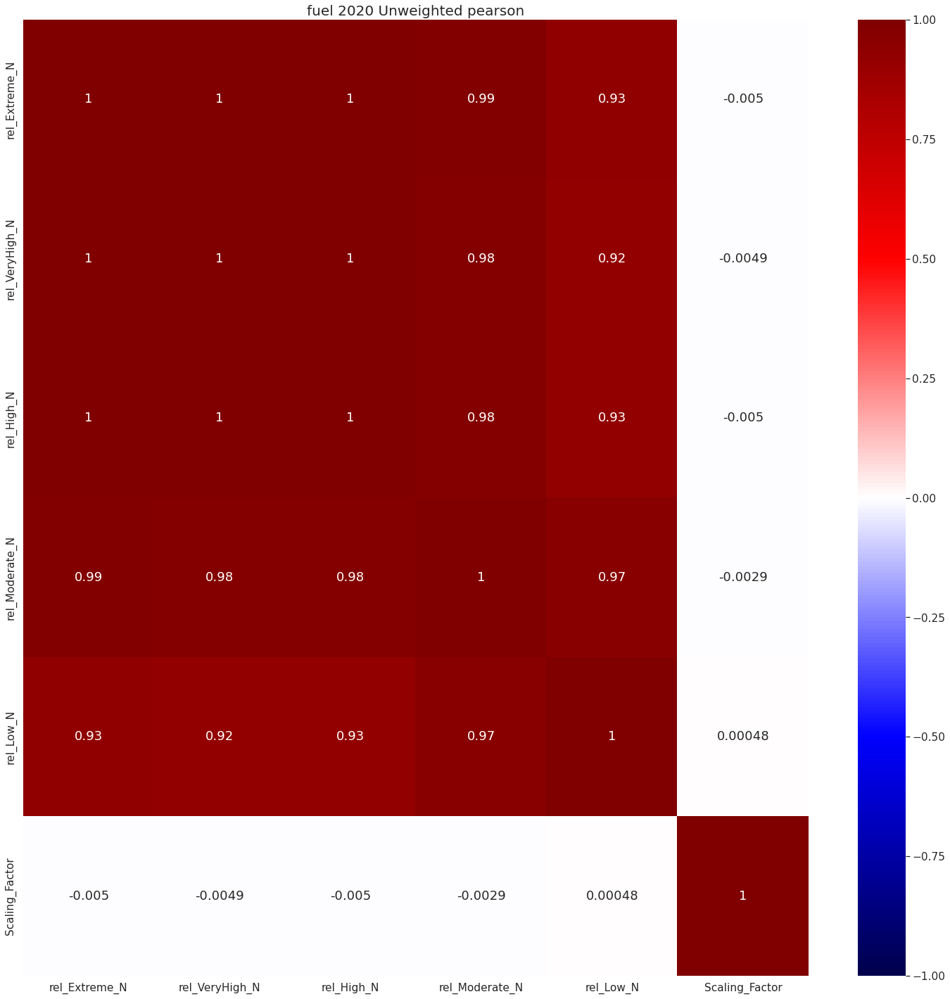

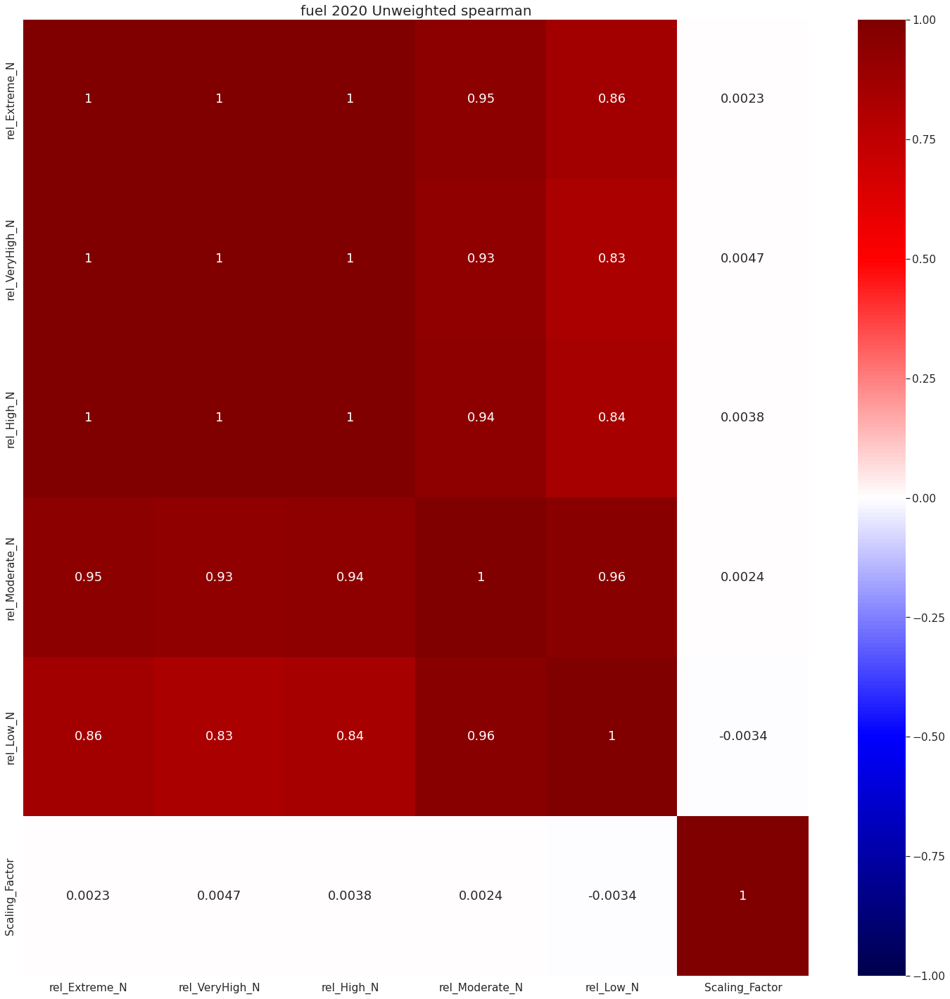

['rel_PWS', 'rel_ESI', 'Scaling_Factor']


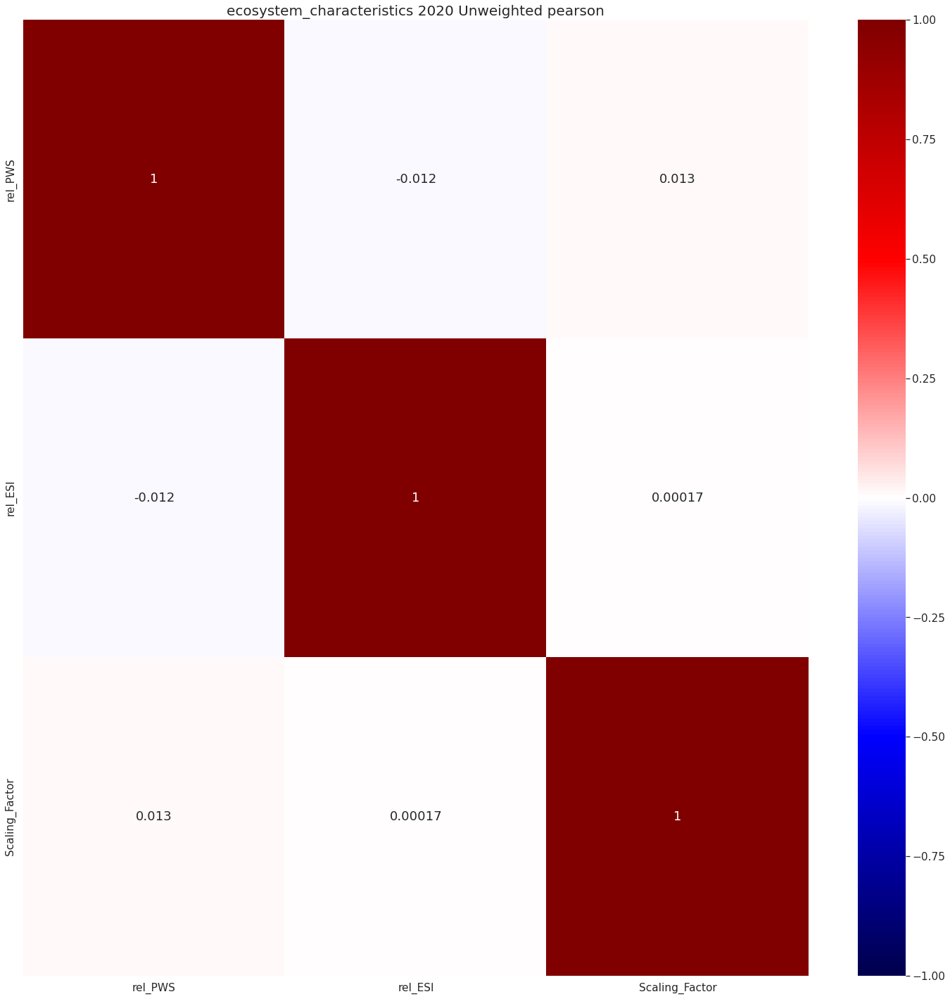

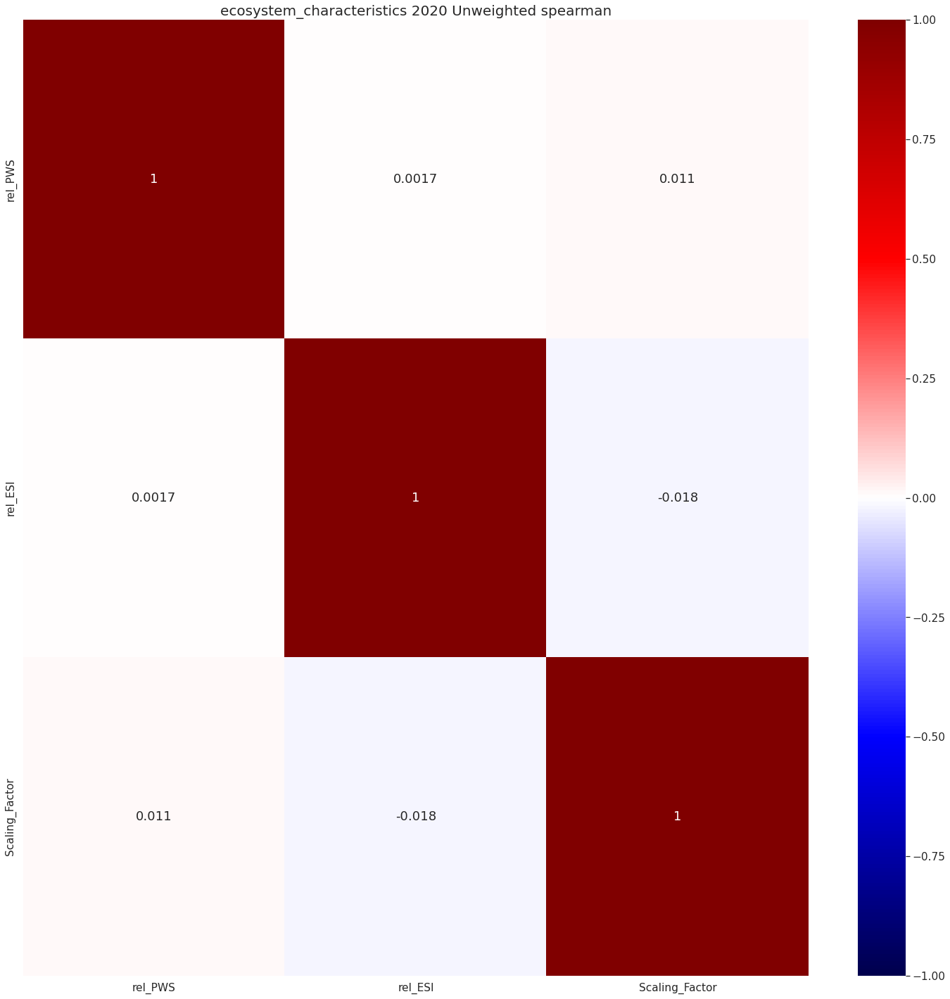

['rel_PFT', 'rel_chi', 'Scaling_Factor']


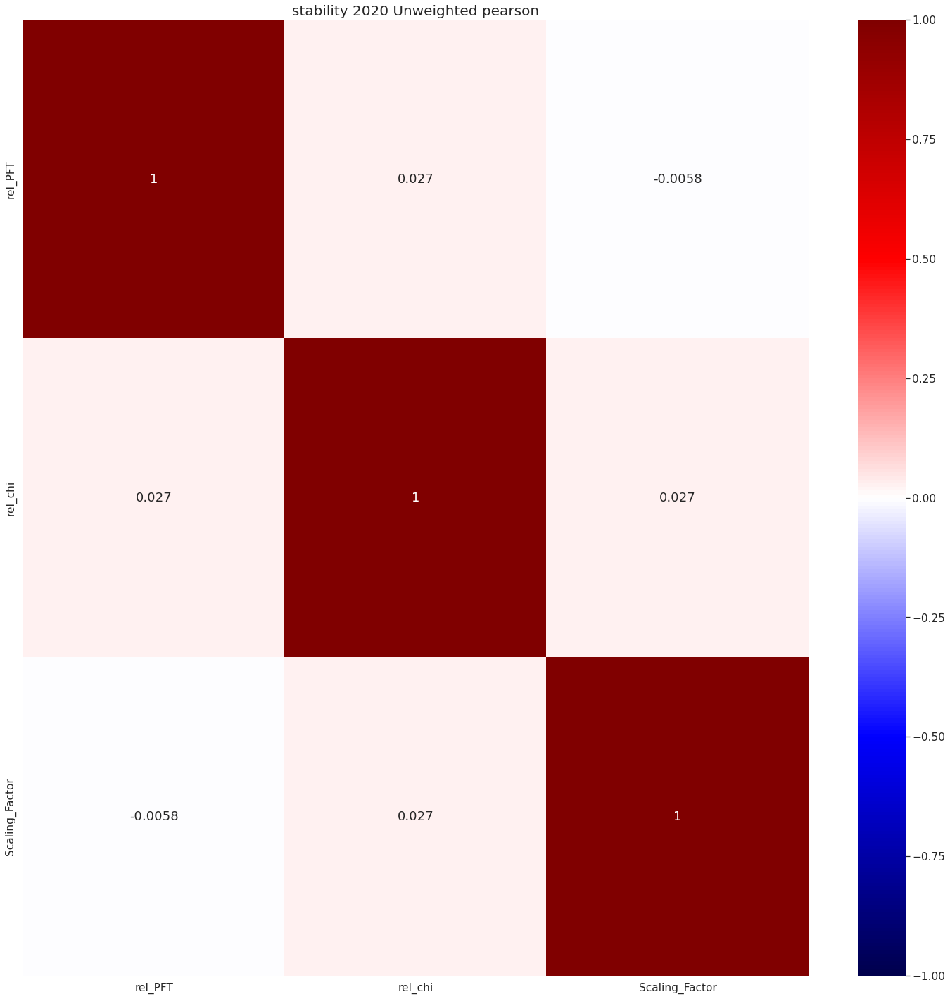

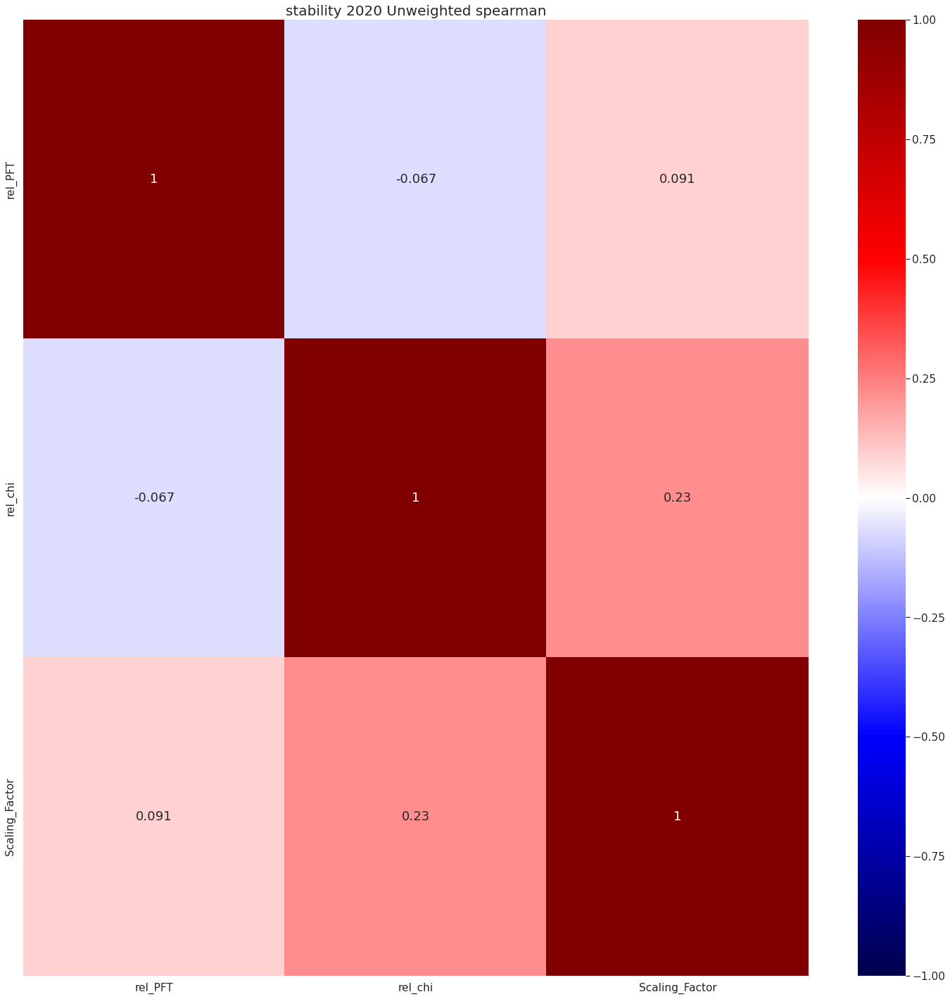

In [152]:
#PLOT UNWEIGHTED
feat_plot ={'weather':['rel_hd0w0', 'rel_hd1w0','rel_hd2w0', 'rel_hd3w0', 'rel_hwp', #weather
                    'rel_IMERG.FINAL.v6_FWI','rel_IMERG.FINAL.v6_ISI', 'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR'], #weather
                    'moisture':['rel_IMERG.FINAL.v6_DC', 'rel_IMERG.FINAL.v6_DMC','rel_IMERG.FINAL.v6_FFMC','rel_Blended_SM', #moisture
                    'rel_FMCG2D', 'rel_FMCGLH2D'], #moisture
                    'fuel':['rel_Extreme_N', 'rel_VeryHigh_N','rel_High_N', 'rel_Moderate_N', 'rel_Low_N'], #fuel  
                   'ecosystem_characteristics':['rel_PWS',  'rel_ESI'], #ecosystem
                    'stability':['rel_PFT', 'rel_chi'] #stability
                   }

for key in feat_plot.keys():
    plot_these = feat_plot[key]
    plot_these.append('Scaling_Factor')
    print(plot_these)
    plot_correlations(features_unweighted_relative[plot_these], key+ ' 2020 Unweighted pearson','pearson')
    plot_correlations(features_unweighted_relative[plot_these], key+ ' 2020 Unweighted spearman','spearman')

['rel_hd0w0', 'rel_hd1w0', 'rel_hd2w0', 'rel_hd3w0', 'rel_hwp', 'rel_IMERG.FINAL.v6_FWI', 'rel_IMERG.FINAL.v6_ISI', 'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR', 'Scaling_Factor']


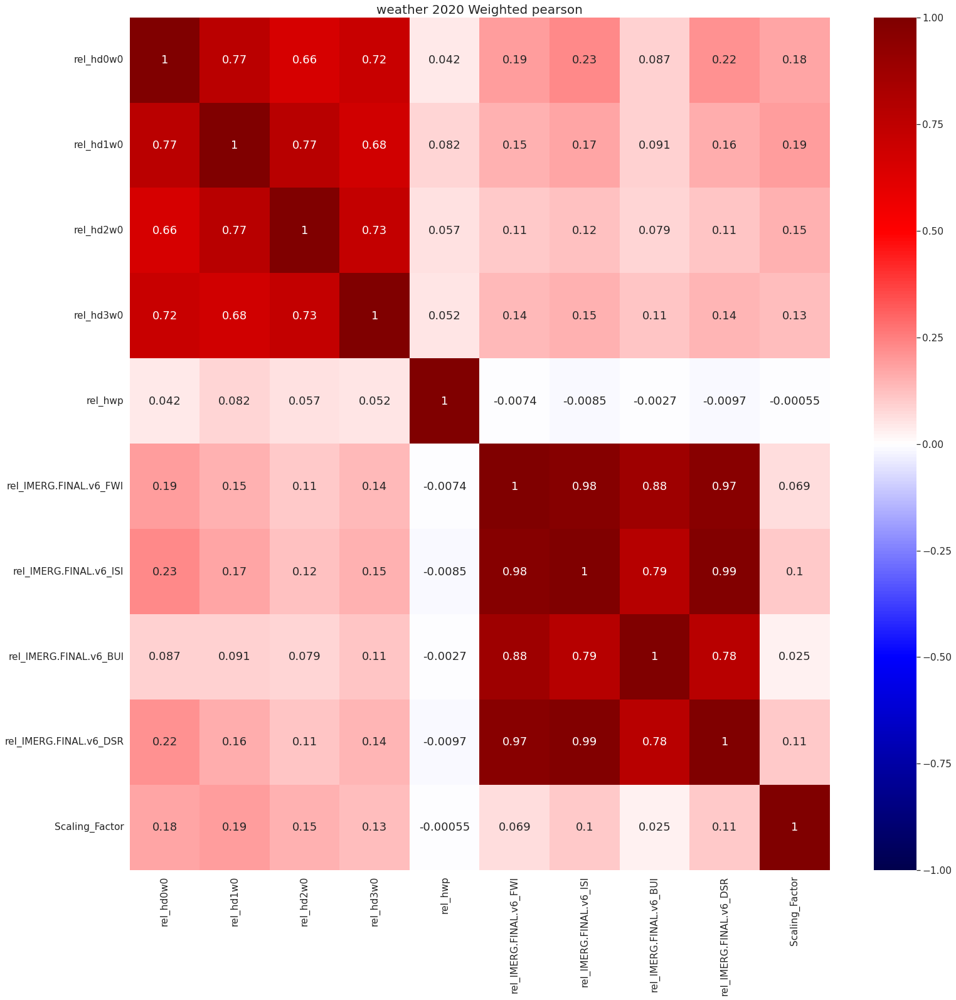

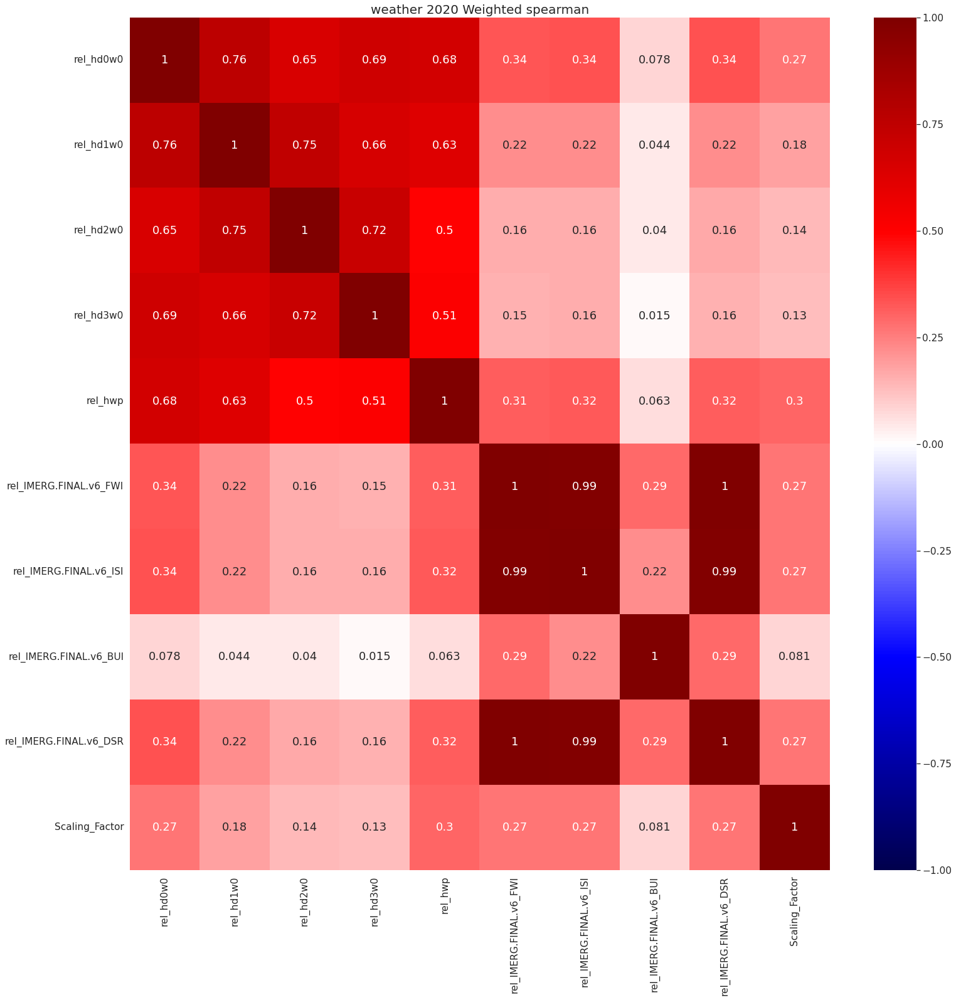

['rel_IMERG.FINAL.v6_DC', 'rel_IMERG.FINAL.v6_DMC', 'rel_IMERG.FINAL.v6_FFMC', 'rel_Blended_SM', 'rel_FMCG2D', 'rel_FMCGLH2D', 'Scaling_Factor']


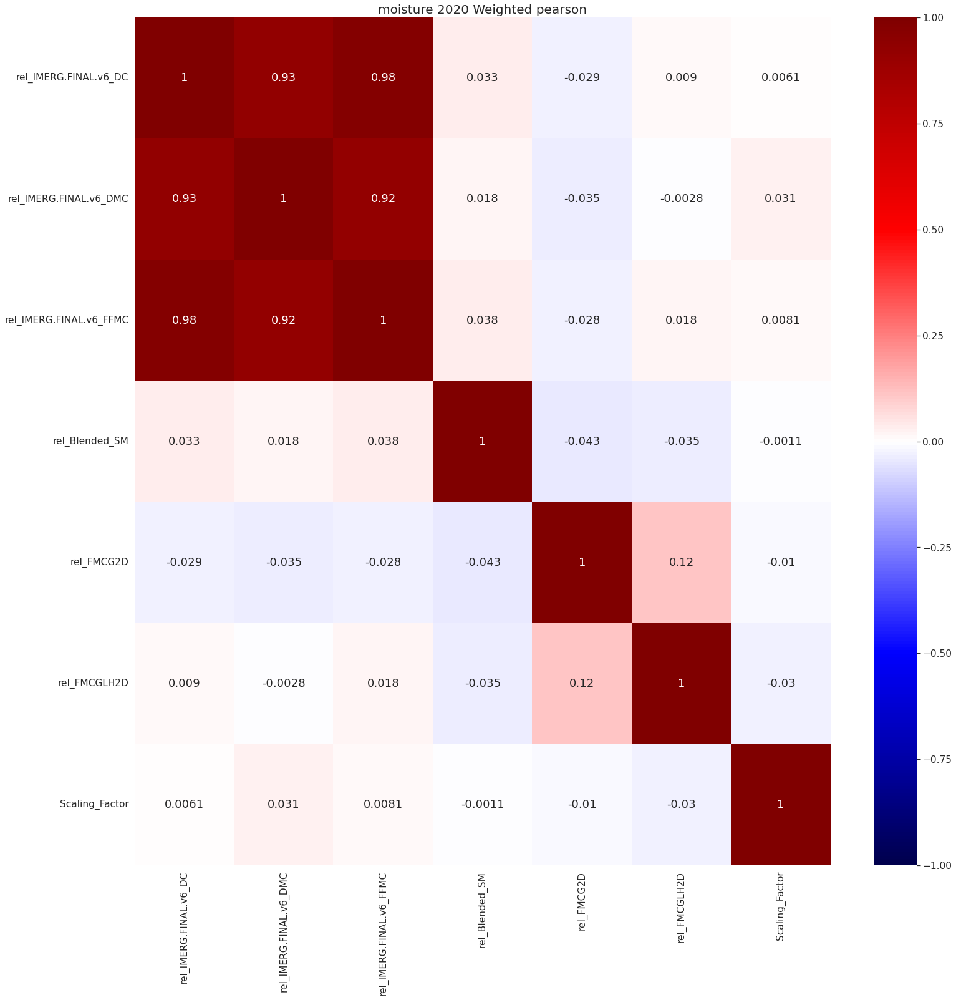

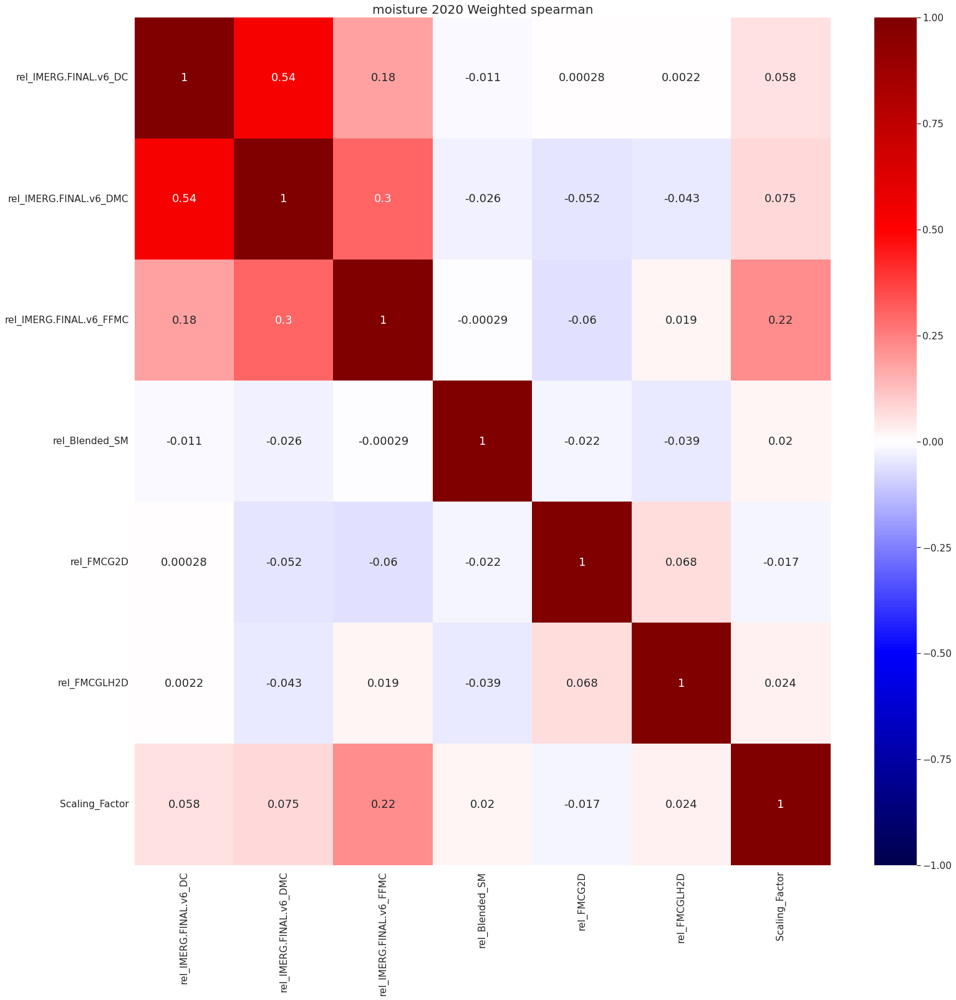

['rel_Extreme_N', 'rel_VeryHigh_N', 'rel_High_N', 'rel_Moderate_N', 'rel_Low_N', 'Scaling_Factor']


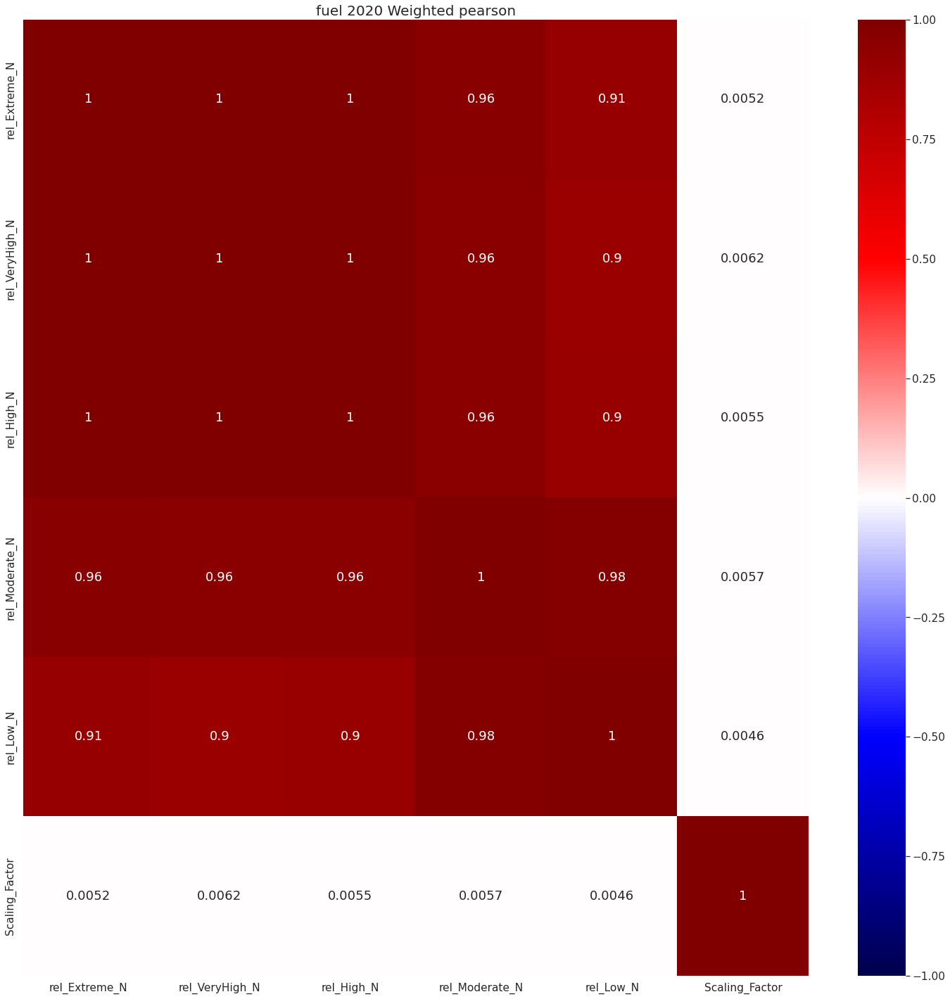

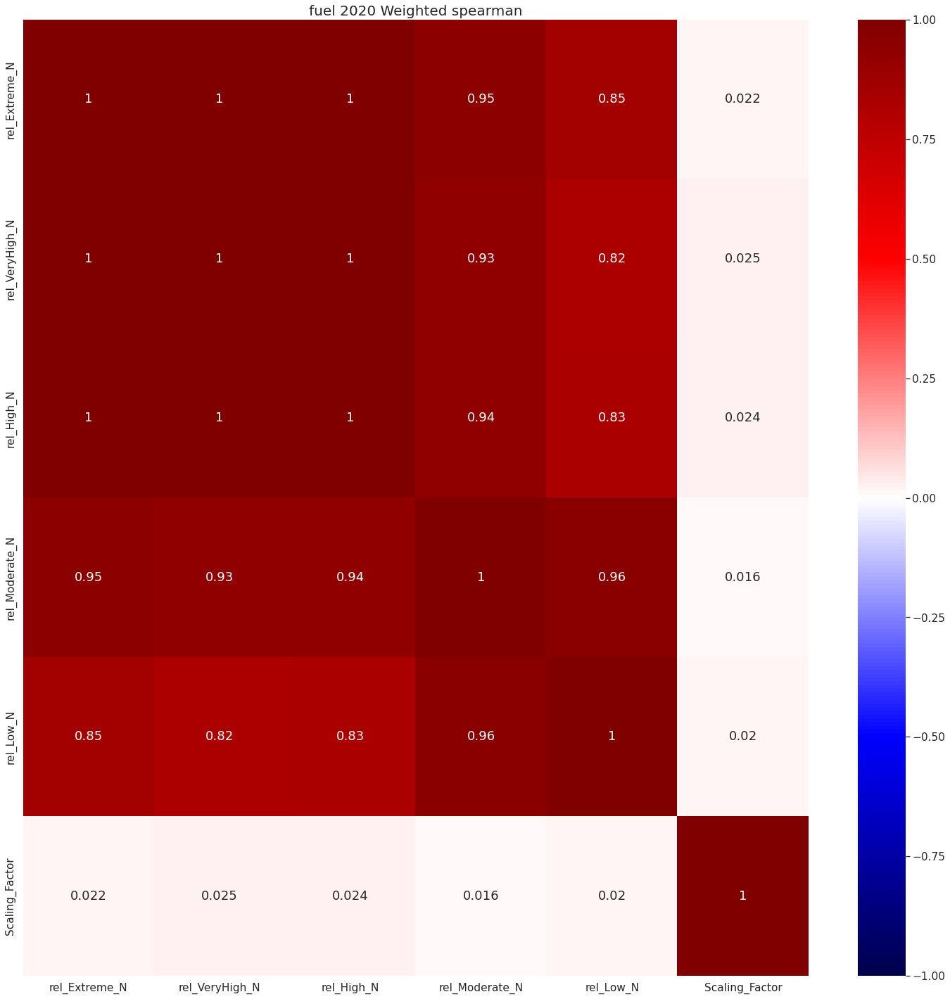

['rel_PWS', 'rel_ESI', 'Scaling_Factor']


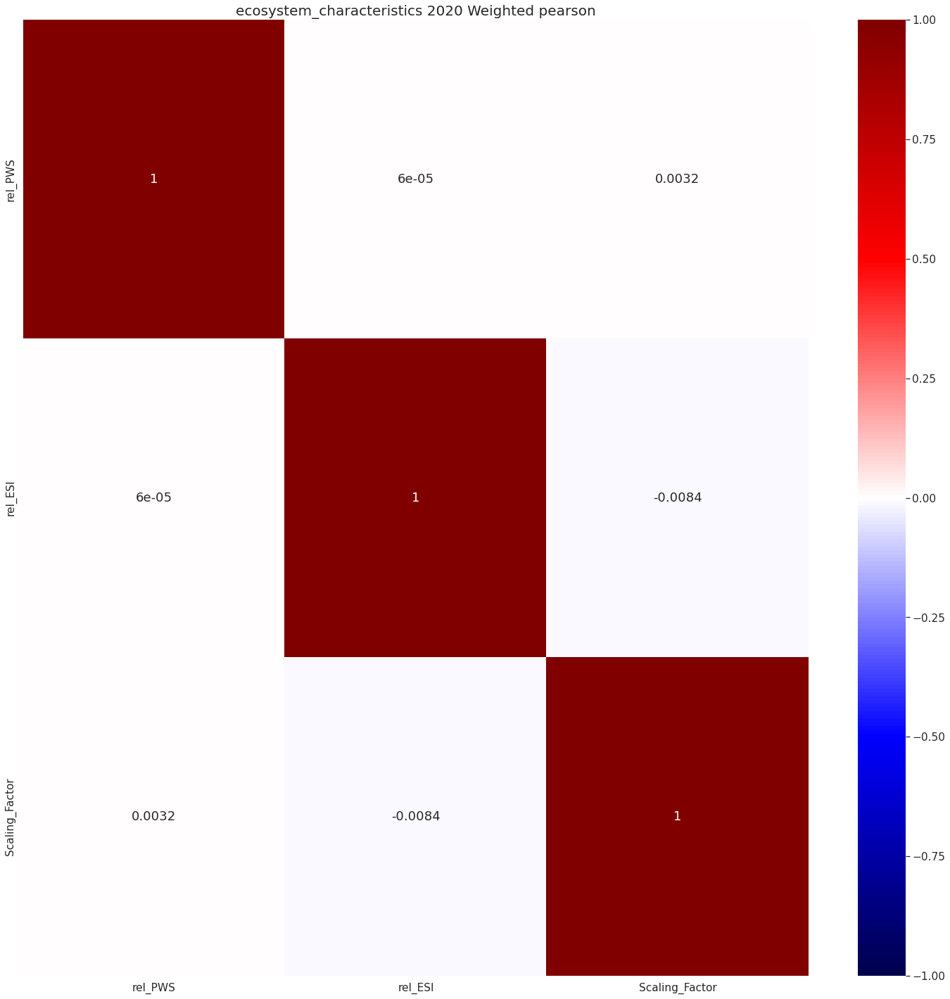

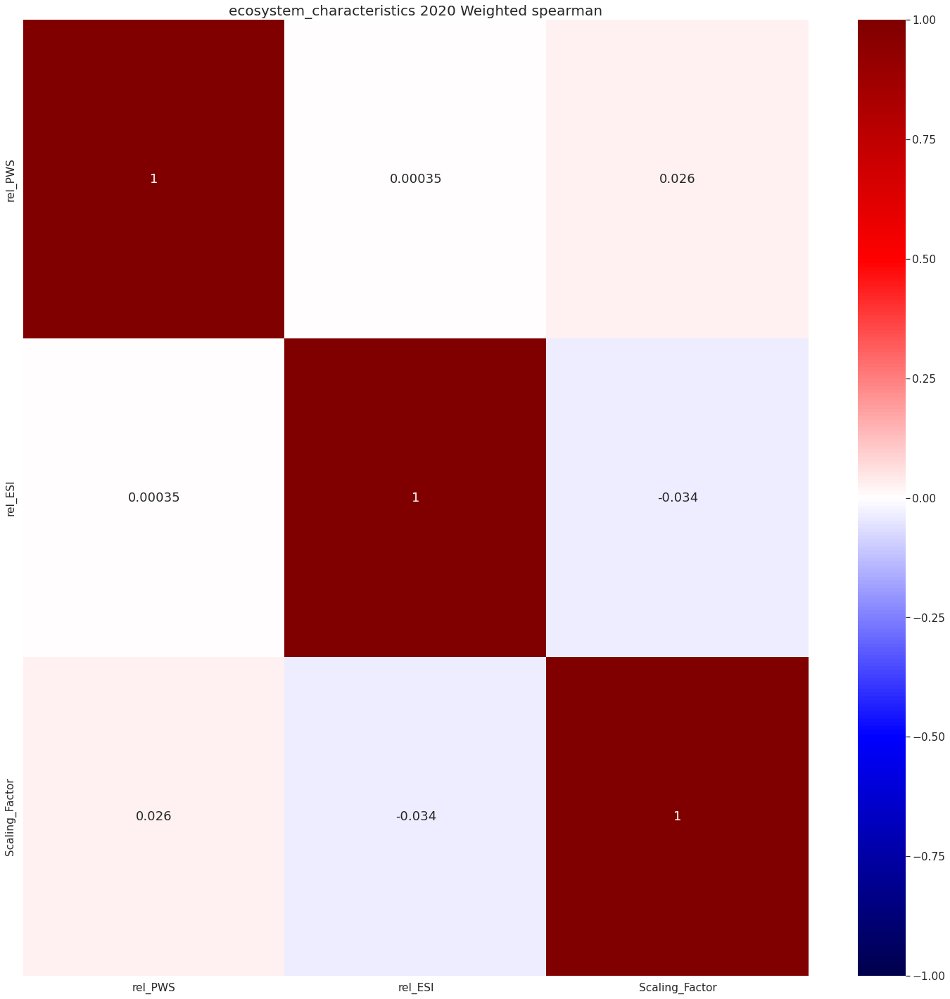

['rel_PFT', 'rel_chi', 'Scaling_Factor']


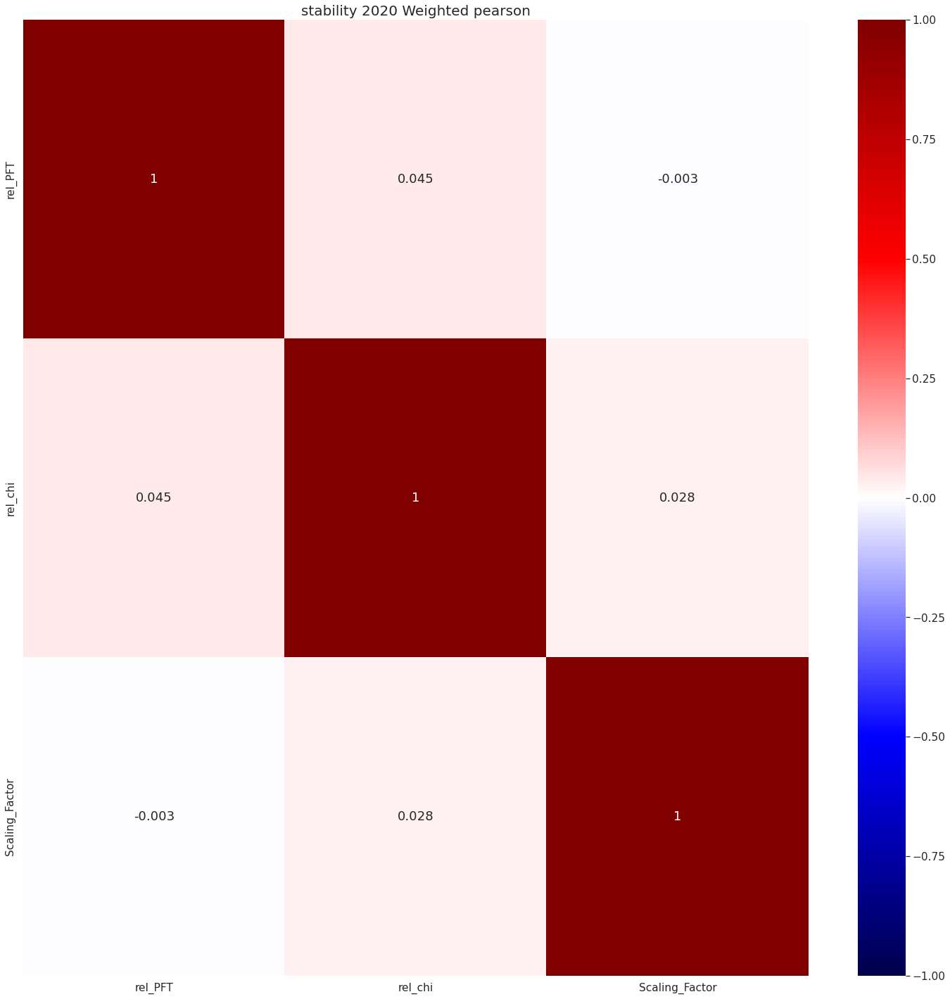

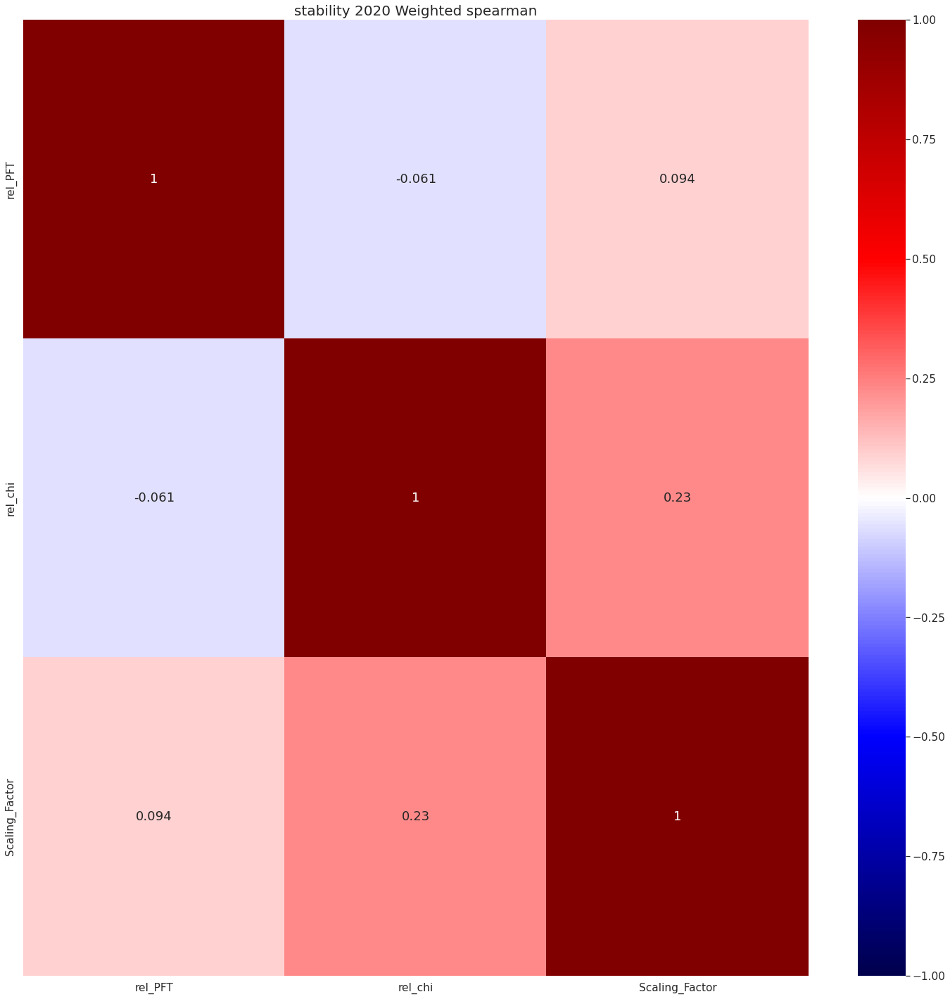

In [23]:
#PLOT WEIGHTED
feat_plot ={'weather':['rel_hd0w0', 'rel_hd1w0','rel_hd2w0', 'rel_hd3w0', 'rel_hwp', #weather
                    'rel_IMERG.FINAL.v6_FWI','rel_IMERG.FINAL.v6_ISI', 'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR'], #weather
                    'moisture':['rel_IMERG.FINAL.v6_DC', 'rel_IMERG.FINAL.v6_DMC','rel_IMERG.FINAL.v6_FFMC','rel_Blended_SM', #moisture
                    'rel_FMCG2D', 'rel_FMCGLH2D'], #moisture
                    'fuel':['rel_Extreme_N', 'rel_VeryHigh_N','rel_High_N', 'rel_Moderate_N', 'rel_Low_N'], #fuel  
                   'ecosystem_characteristics':['rel_PWS',  'rel_ESI'], #ecosystem
                    'stability':['rel_PFT', 'rel_chi'] #stability
                   }

for key in feat_plot.keys():
    plot_these = feat_plot[key]
    plot_these.append('Scaling_Factor')
    print(plot_these)
    plot_correlations(features_weighted_relative[plot_these], key+ ' 2020 Weighted pearson','pearson')
    plot_correlations(features_weighted_relative[plot_these], key+ ' 2020 Weighted spearman','spearman')

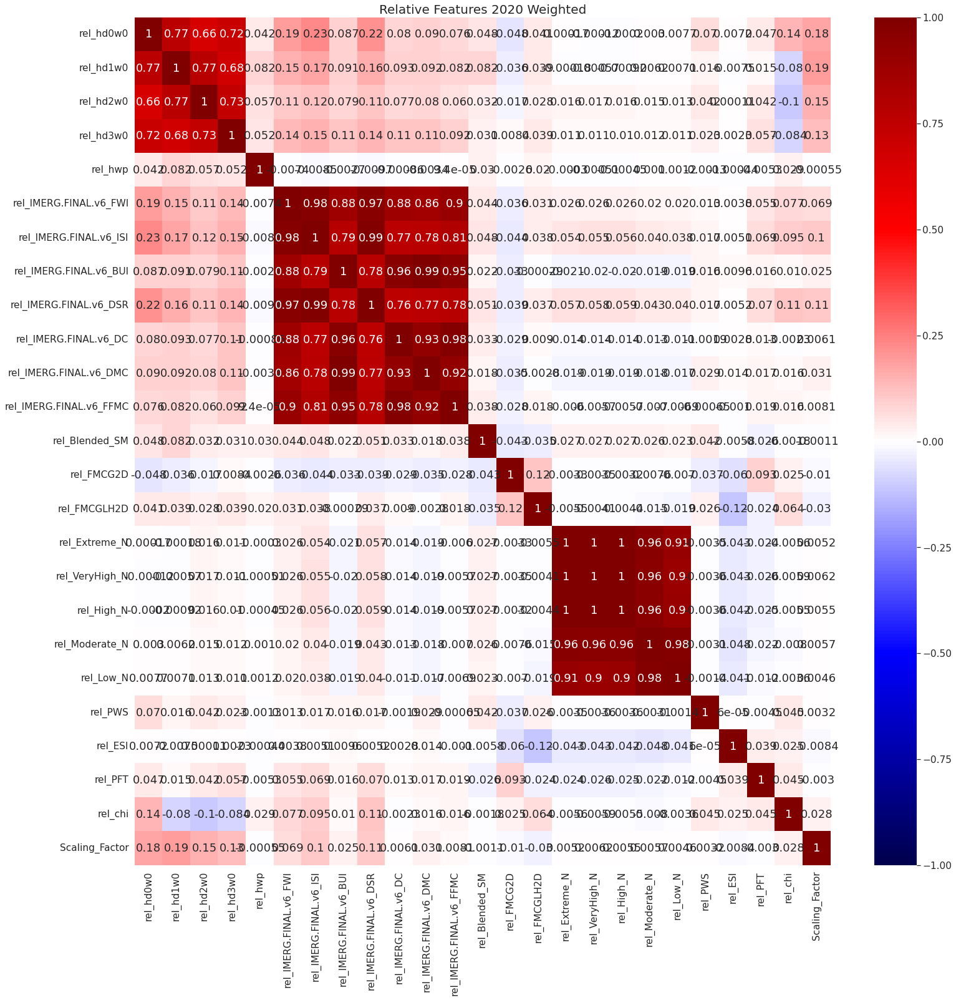

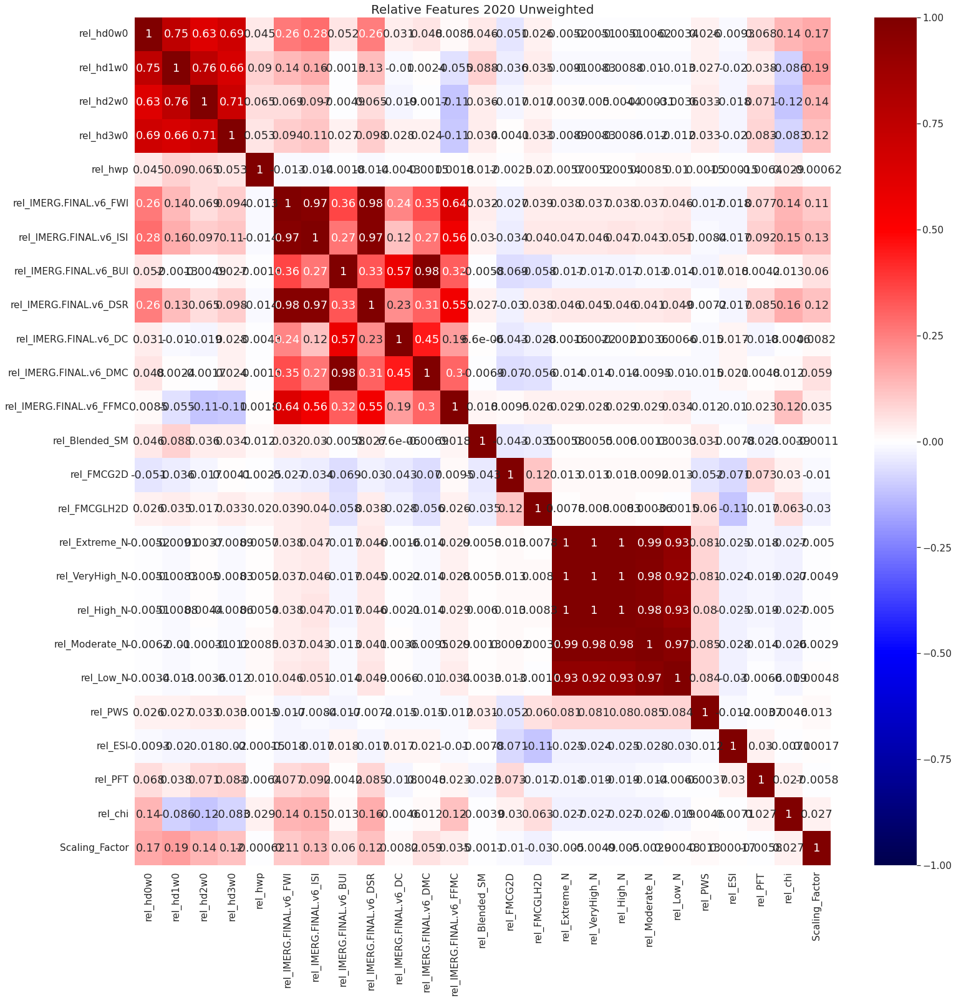

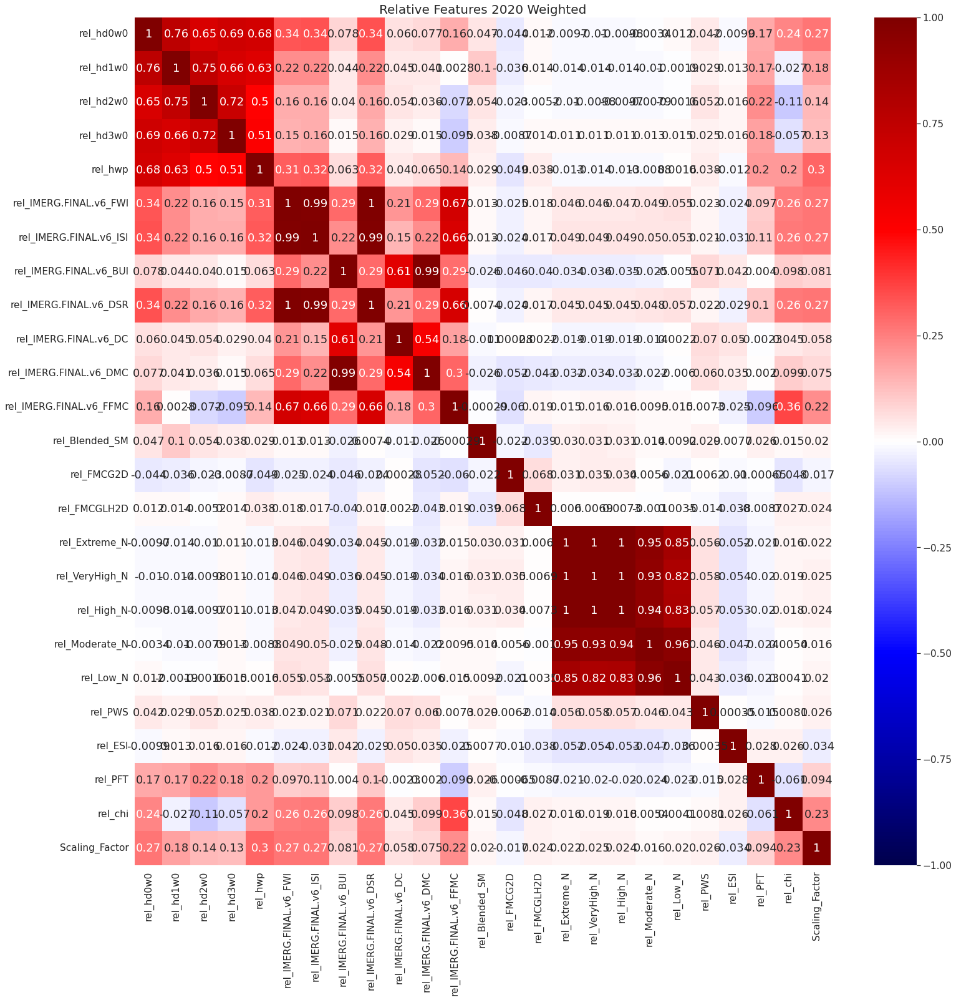

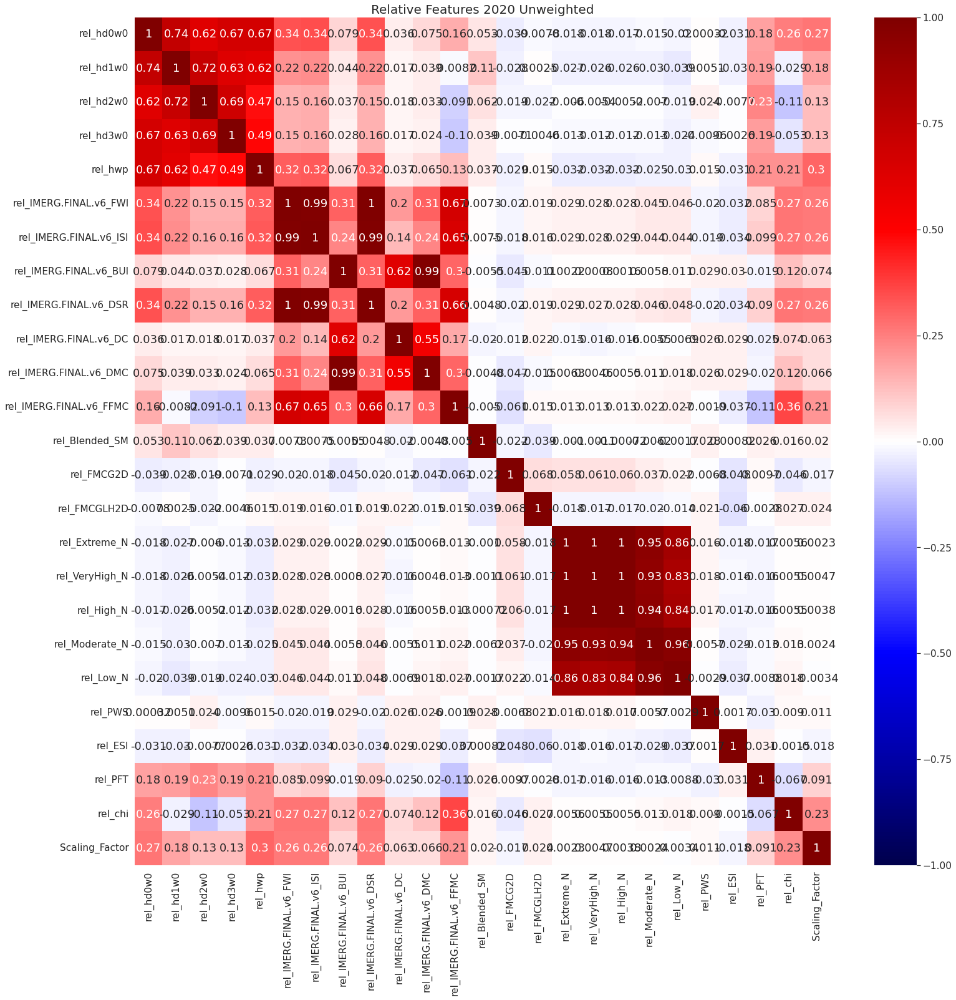

In [151]:
feat_plot = ['rel_hd0w0', 'rel_hd1w0', 'rel_hd2w0', 'rel_hd3w0', 'rel_hwp',
 'rel_IMERG.FINAL.v6_FWI', 'rel_IMERG.FINAL.v6_ISI',
 'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR', 'rel_IMERG.FINAL.v6_DC',
 'rel_IMERG.FINAL.v6_DMC', 'rel_IMERG.FINAL.v6_FFMC', 'rel_Blended_SM',
 'rel_FMCG2D', 'rel_FMCGLH2D', 'rel_Extreme_N', 'rel_VeryHigh_N', 'rel_High_N',
 'rel_Moderate_N', 'rel_Low_N', 'rel_PWS', 'rel_ESI', 'rel_PFT', 'rel_chi', 'Scaling_Factor']

plot_correlations(features_weighted_relative[feat_plot], 'Relative Features 2020 Weighted','pearson')
plot_correlations(features_unweighted_relative[feat_plot], 'Relative Features 2020 Unweighted','pearson')

plot_correlations(features_weighted_relative[feat_plot], 'Relative Features 2020 Weighted','spearman')
plot_correlations(features_unweighted_relative[feat_plot], 'Relative Features 2020 Unweighted','spearman')

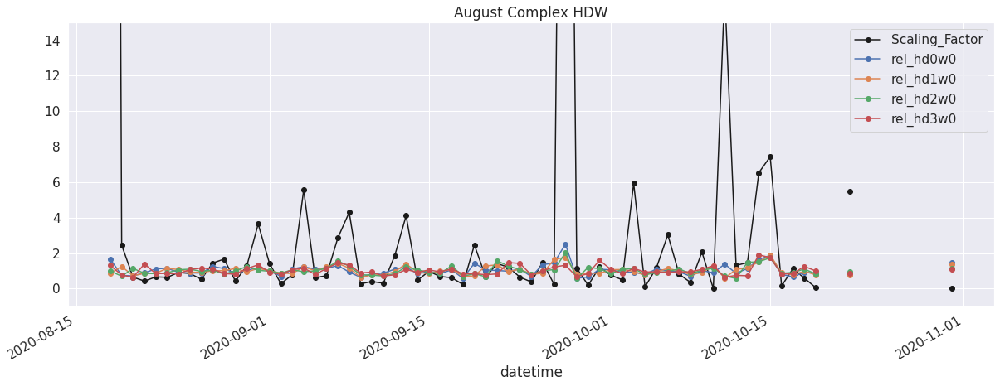

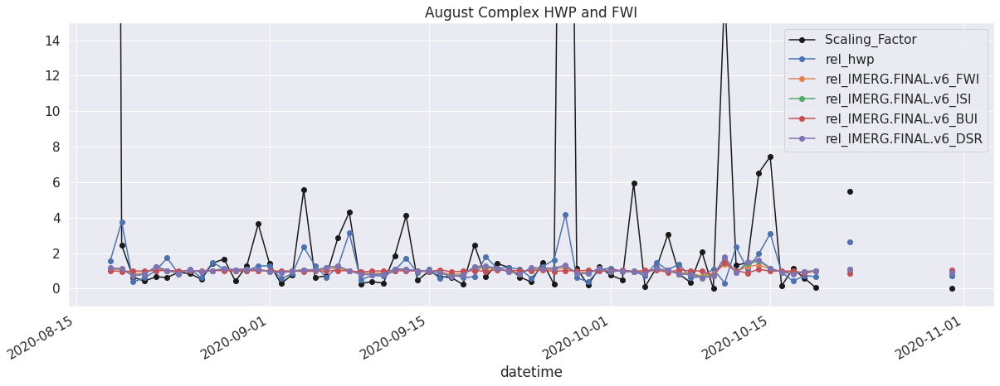

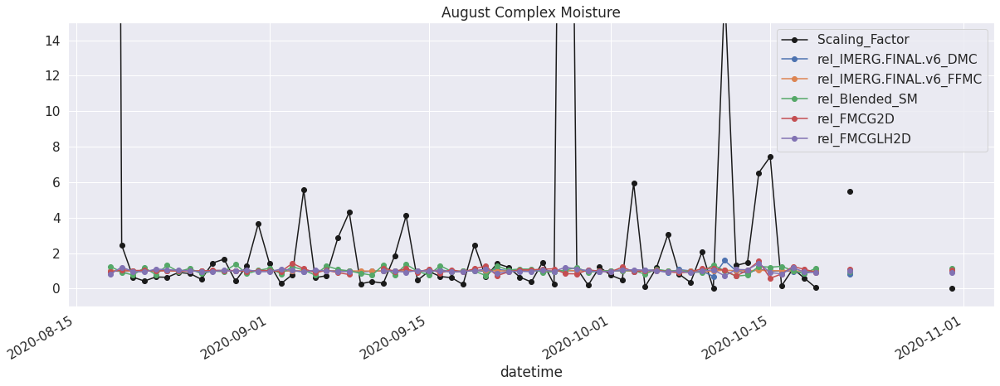

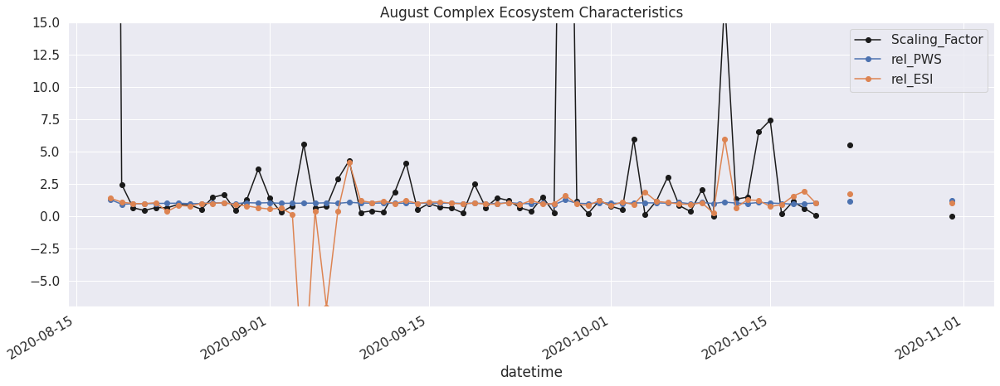

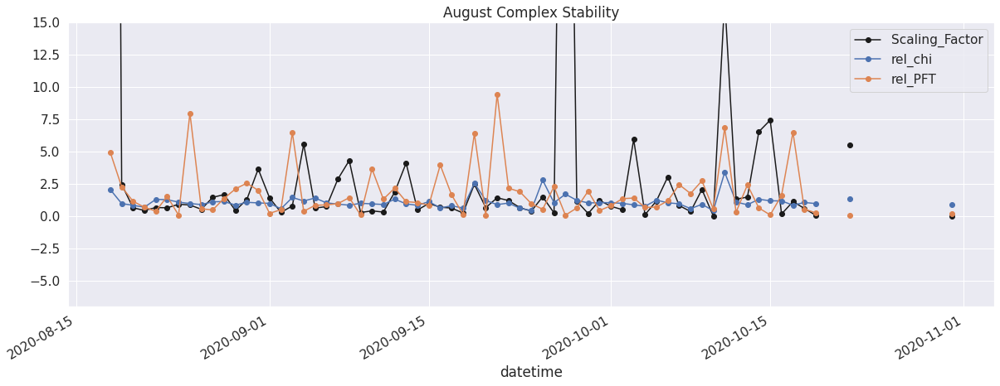

" 'rel_Extreme_N', 'rel_VeryHigh_N', 'rel_High_N',\n 'rel_Moderate_N', 'rel_Low_N', 'rel_PWS', 'rel_ESI', 'rel_PFT', 'rel_chi', 'Scaling_Factor']"

In [133]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
features_ac = features_unweighted_relative[features_unweighted_relative['irwinID']==ac['irwinID'].values[0][2:38]].reset_index()


fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(x='datetime',y=['rel_hd0w0', 'rel_hd1w0', 'rel_hd2w0', 'rel_hd3w0'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex HDW')
plt.ylim(-1,15)
plt.show()

fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(x='datetime',y=['rel_hwp', 'rel_IMERG.FINAL.v6_FWI', 'rel_IMERG.FINAL.v6_ISI',
                                     'rel_IMERG.FINAL.v6_BUI', 'rel_IMERG.FINAL.v6_DSR',],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex HWP and FWI')
plt.ylim(-1,15)
plt.show()


fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(x='datetime',y=['rel_IMERG.FINAL.v6_DMC', 'rel_IMERG.FINAL.v6_FFMC', 'rel_Blended_SM',
                                 'rel_FMCG2D', 'rel_FMCGLH2D',],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex Moisture')
plt.ylim(-1,15)
plt.show()

fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(x='datetime',y=['rel_PWS', 'rel_ESI'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex Ecosystem Characteristics')
plt.ylim(-7,15)
plt.show()


fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(x='datetime',y=['rel_chi', 'rel_PFT'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex Stability')
plt.ylim(-7,15)
plt.show()

""" 'rel_Extreme_N', 'rel_VeryHigh_N', 'rel_High_N',
 'rel_Moderate_N', 'rel_Low_N', 'rel_PWS', 'rel_ESI', 'rel_PFT', 'rel_chi', 'Scaling_Factor']"""





# First pass looking at the performance of fire indices (2020 Only)

In [15]:
#load in all the data for 2020
rave = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_RAVE_Unweighted_12Z_day_start.csv', [2020])
smops = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_SMOPS_Weighted_12Z_day_start.csv', [2020])
hdw = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HDW_Weighted_12Z_day_start.csv', [2020])
hwp =combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HWP_Weighted_12Z_day_start.csv', [2020])
imerg = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_IMERG_FWI_Weighted_12Z_day_start.csv', [2020])
pws = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_PWS_Weighted_12Z_day_start.csv', [2020])
loading = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_LOADING_Weighted_12Z_day_start.csv', [2020])

ncar = combine_per_fire_csv(np.unique(rave['irwinID'].values),   
                            './fire_features_ncar/', 'Weighted')
esi = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_esi/', 'Weighted')
chi = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_chi/', 'Weighted')
resources = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_resources/', '')
pft = combine_per_fire_csv(np.unique(rave['irwinID'].values), 
                            './fire_features_pft/', 'Weighted')

In [16]:
#put all of the features together
features = rave[['irwinID','day']].set_index(['irwinID', 'day'])
features = add_to_features(features, rave)
features = add_to_features(features, smops)
features = add_to_features(features, hdw)
features = add_to_features(features, hwp)
features = add_to_features(features, imerg)
features = add_to_features(features, pws)
features = add_to_features(features, loading)
features = add_to_features(features, ncar)
features = add_to_features(features, esi)
features = add_to_features(features, pft)
features = add_to_features(features, chi)

features = add_to_features(features, resources)
print(features.columns, len(features))


Index(['FRP_MEAN', 'Blended_SM', 'hd0w0', 'hd1w0', 'hd2w0', 'hd3w0', 'hwp',
       'IMERG.FINAL.v6_DC', 'IMERG.FINAL.v6_DMC', 'IMERG.FINAL.v6_FFMC',
       'IMERG.FINAL.v6_ISI', 'IMERG.FINAL.v6_BUI', 'IMERG.FINAL.v6_FWI',
       'IMERG.FINAL.v6_DSR', 'PWS', 'Extreme_N', 'VeryHigh_N', 'High_N',
       'Moderate_N', 'Low_N', 'FMCG2D', 'FMCGLH2D', 'ESI', 'U_ml', 'z_fc',
       'dtheta_fc', 'PFT', 'temp_850', 'temp_700', 'dewpt_850', 'ca', 'cb',
       'chi', 'percent_contained'],
      dtype='object') 2485


In [17]:
# drop fires that last one day
features_reindex = features.reset_index()
print(len(np.unique(features_reindex['irwinID'])))

features_ge_two_days = features_reindex[features_reindex.groupby('irwinID')['day'].transform('size').ge(2)].reset_index(drop=True)
print(len(np.unique(features_ge_two_days['irwinID'])))
print(features_ge_two_days)

259
205
                                   irwinID         day       FRP_MEAN  \
0     00B3EDB2-87A4-4D0A-A834-4E1012BF9693  2020-09-08  102303.436315   
1     00B3EDB2-87A4-4D0A-A834-4E1012BF9693  2020-09-09   18779.802910   
2     00B3EDB2-87A4-4D0A-A834-4E1012BF9693  2020-09-10   14731.512078   
3     00B3EDB2-87A4-4D0A-A834-4E1012BF9693  2020-09-11    2706.065915   
4     00B3EDB2-87A4-4D0A-A834-4E1012BF9693  2020-09-12    1349.205056   
...                                    ...         ...            ...   
2426  FF0731C1-EC45-43FB-B0A7-9CDAECB282CD  2020-07-14    1272.865791   
2427  FF65A04D-419D-4791-BAA4-FBBAB29AA03F  2020-11-05    1816.646481   
2428  FF65A04D-419D-4791-BAA4-FBBAB29AA03F  2020-11-06     744.962650   
2429  FFCB89F5-98FB-4C3A-9554-3D1554181A63  2020-09-17    5779.058105   
2430  FFCB89F5-98FB-4C3A-9554-3D1554181A63  2020-09-18    8980.300549   

      Blended_SM       hd0w0       hd1w0       hd2w0       hd3w0        hwp  \
0       0.300812  164.580865  184.19

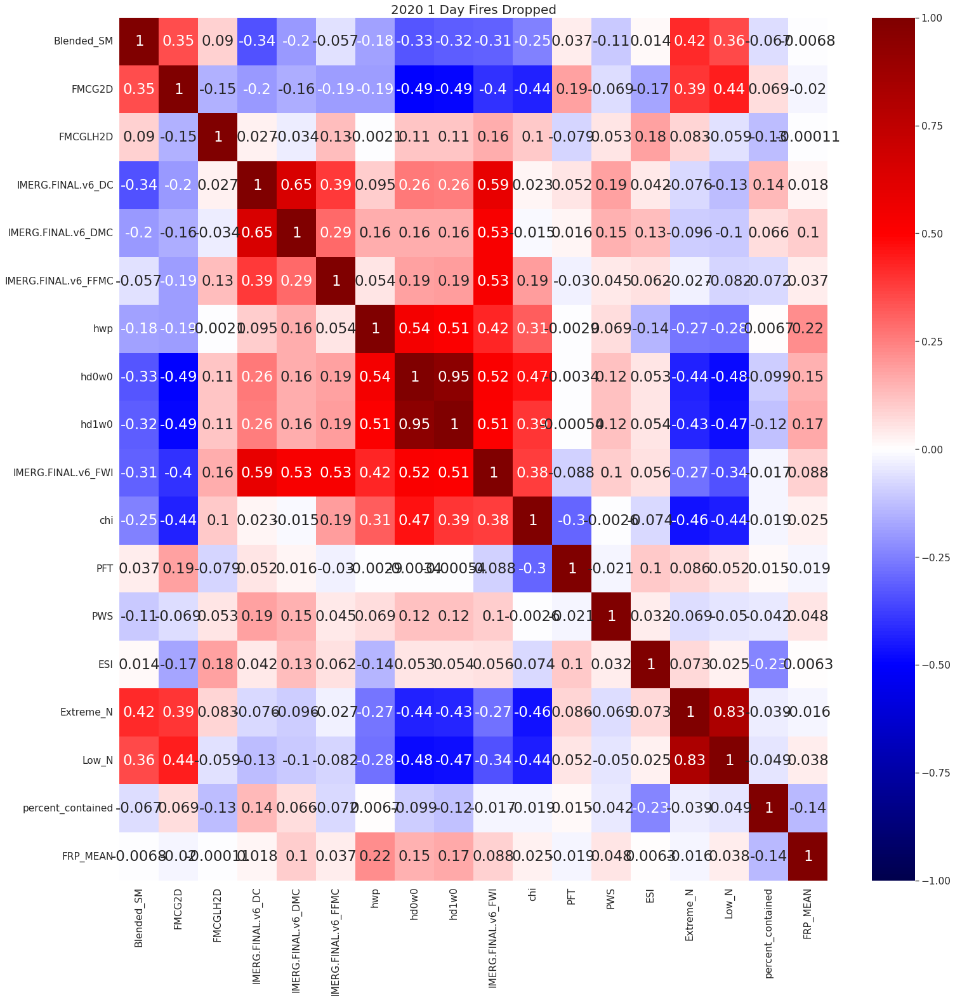

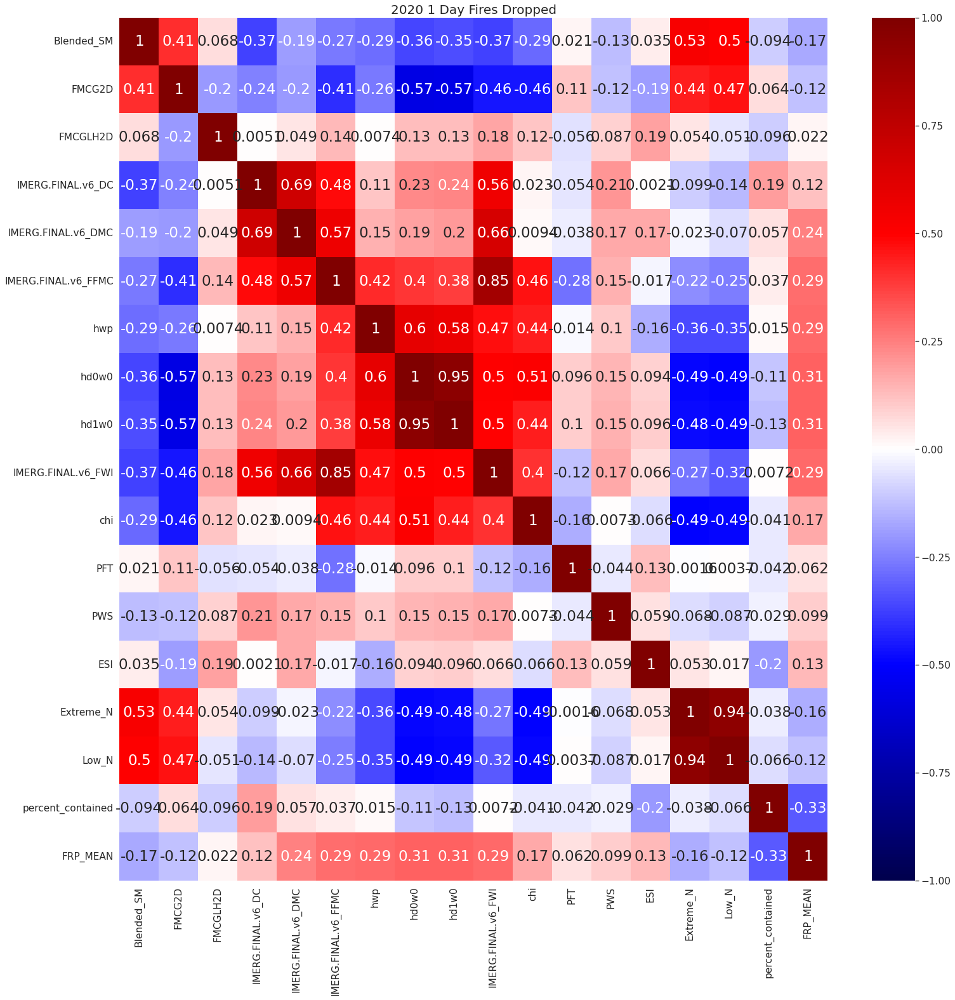

In [111]:
plot_correlations(features_ge_two_days[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 1 Day Fires Dropped','pearson')
plot_correlations(features_ge_two_days[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN']], \
                  '2020 1 Day Fires Dropped','spearman')

In [18]:
#do the shifts for all the incidents
events = np.unique(features_ge_two_days['irwinID']) #all the incidents

features_to_shift = features.columns.values
features_shifted = []

features_with_shifts = pd.DataFrame()
for ii in range(len(features_to_shift)):
    features_shifted.append(features_to_shift[ii]+'_1')
    
    
for jj in range(len(events)):
    df_fire = features_ge_two_days[features_ge_two_days['irwinID']==events[jj]]
    df_fire_shifted = shift_ndays(df_fire, 1, features_to_shift, features_shifted, 'day')

    features_with_shifts = pd.concat([features_with_shifts, df_fire_shifted], axis=0).reset_index(drop=True)

print(features_with_shifts.columns.values)

['datetime' 'irwinID' 'day' 'FRP_MEAN' 'Blended_SM' 'hd0w0' 'hd1w0'
 'hd2w0' 'hd3w0' 'hwp' 'IMERG.FINAL.v6_DC' 'IMERG.FINAL.v6_DMC'
 'IMERG.FINAL.v6_FFMC' 'IMERG.FINAL.v6_ISI' 'IMERG.FINAL.v6_BUI'
 'IMERG.FINAL.v6_FWI' 'IMERG.FINAL.v6_DSR' 'PWS' 'Extreme_N' 'VeryHigh_N'
 'High_N' 'Moderate_N' 'Low_N' 'FMCG2D' 'FMCGLH2D' 'ESI' 'U_ml' 'z_fc'
 'dtheta_fc' 'PFT' 'temp_850' 'temp_700' 'dewpt_850' 'ca' 'cb' 'chi'
 'percent_contained' 'FRP_MEAN_1' 'Blended_SM_1' 'hd0w0_1' 'hd1w0_1'
 'hd2w0_1' 'hd3w0_1' 'hwp_1' 'IMERG.FINAL.v6_DC_1' 'IMERG.FINAL.v6_DMC_1'
 'IMERG.FINAL.v6_FFMC_1' 'IMERG.FINAL.v6_ISI_1' 'IMERG.FINAL.v6_BUI_1'
 'IMERG.FINAL.v6_FWI_1' 'IMERG.FINAL.v6_DSR_1' 'PWS_1' 'Extreme_N_1'
 'VeryHigh_N_1' 'High_N_1' 'Moderate_N_1' 'Low_N_1' 'FMCG2D_1'
 'FMCGLH2D_1' 'ESI_1' 'U_ml_1' 'z_fc_1' 'dtheta_fc_1' 'PFT_1' 'temp_850_1'
 'temp_700_1' 'dewpt_850_1' 'ca_1' 'cb_1' 'chi_1' 'percent_contained_1']


In [19]:
names_rel = ['Blended_SM', 'hd0w0', 'hd1w0',
 'hd2w0' ,'hd3w0', 'hwp' ,'IMERG.FINAL.v6_DC', 'IMERG.FINAL.v6_DMC',
 'IMERG.FINAL.v6_FFMC' ,'IMERG.FINAL.v6_ISI', 'IMERG.FINAL.v6_BUI',
 'IMERG.FINAL.v6_FWI', 'IMERG.FINAL.v6_DSR', 'PWS', 'Extreme_N' ,'VeryHigh_N',
 'High_N' ,'Moderate_N' ,'Low_N' ,'FMCG2D' ,'FMCGLH2D', 'ESI' ,'U_ml' ,'z_fc',
 'dtheta_fc', 'PFT', 'temp_850' ,'temp_700' ,'dewpt_850' ,'ca', 'cb', 'chi']

features_with_shifts = get_relative_features(features_with_shifts, names_rel)


In [20]:
features_with_shifts['Scaling_Factor'] = features_with_shifts['FRP_MEAN']/features_with_shifts['FRP_MEAN_1']
features_with_shifts['Log_Scaling_Factor'] = np.log10(features_with_shifts['Scaling_Factor'])

#calculate the outliers
quantiles = features_with_shifts['Log_Scaling_Factor'].quantile(q=[.25, .5, .75])
print(quantiles)
iqr = quantiles[0.75]-quantiles[0.25]
print('IQR: ' + str(iqr))

lower_fence = quantiles[0.50]-(1.5*iqr)
upper_fence = quantiles[0.50]+(1.5*iqr)
print('Lower and upper fences are: '+ str(lower_fence) + ', '+ str(upper_fence))

#mark the outliers, we won't count them in the evaluation
features_with_shifts['scaling_factor_is_outlier'] = np.where((features_with_shifts['Log_Scaling_Factor']<=lower_fence)| (features_with_shifts['Log_Scaling_Factor']>=upper_fence), True,False)


0.25   -0.553441
0.50   -0.052132
0.75    0.398063
Name: Log_Scaling_Factor, dtype: float64
IQR: 0.9515039174364963
Lower and upper fences are: -1.4793877385012746, 1.3751240138082144


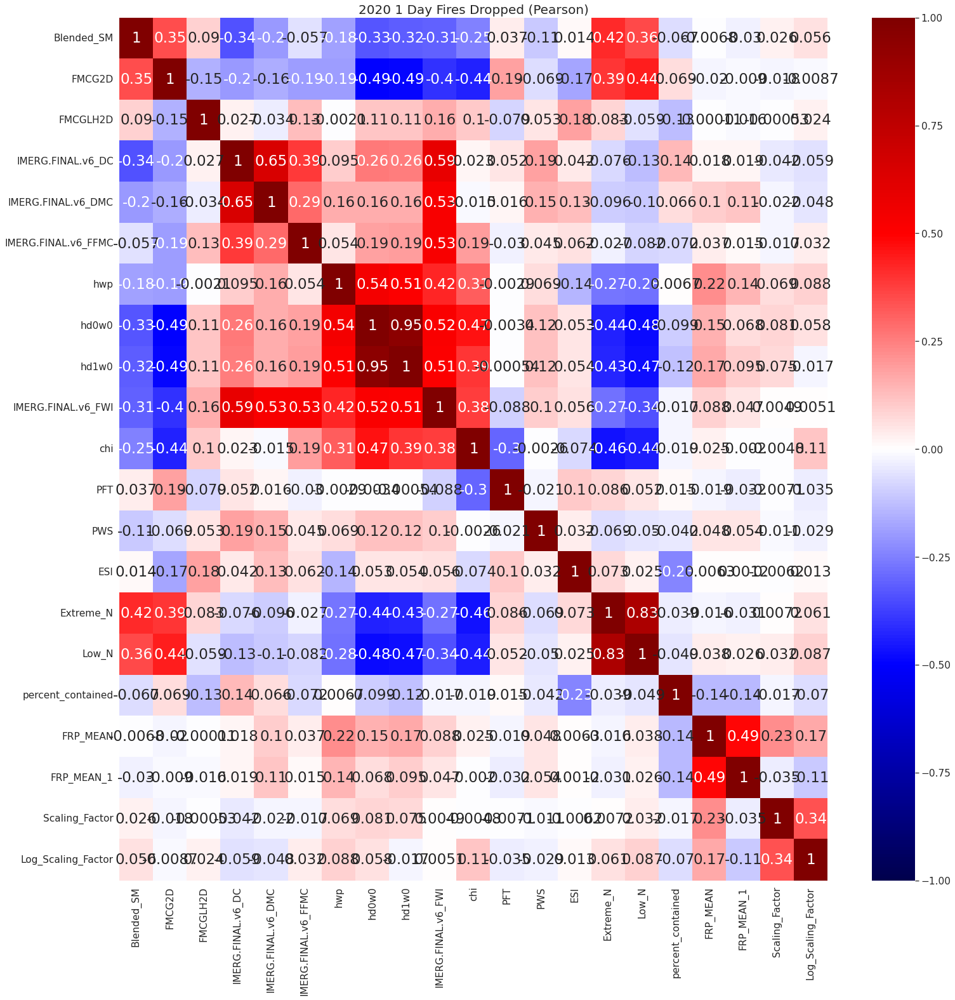

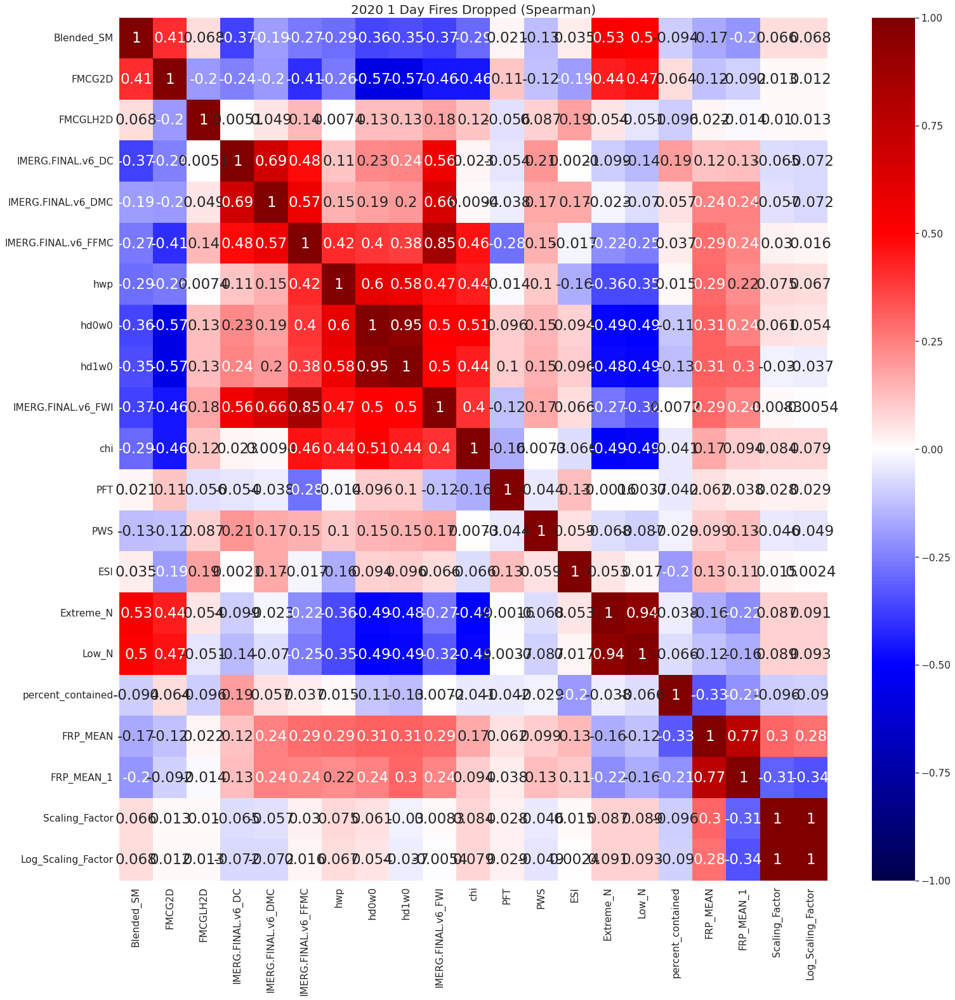

In [124]:
plot_correlations(features_with_shifts[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN', 'FRP_MEAN_1','Scaling_Factor', 'Log_Scaling_Factor']], \
                  '2020 1 Day Fires Dropped (Pearson)','pearson')
plot_correlations(features_with_shifts[['Blended_SM', 'FMCG2D', 'FMCGLH2D', 'IMERG.FINAL.v6_DC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_FFMC','hwp', 'hd0w0', 'hd1w0', 'IMERG.FINAL.v6_FWI','chi','PFT','PWS', 'ESI','Extreme_N','Low_N','percent_contained','FRP_MEAN', 'FRP_MEAN_1','Scaling_Factor', 'Log_Scaling_Factor']], \
                  '2020 1 Day Fires Dropped (Spearman)','spearman')

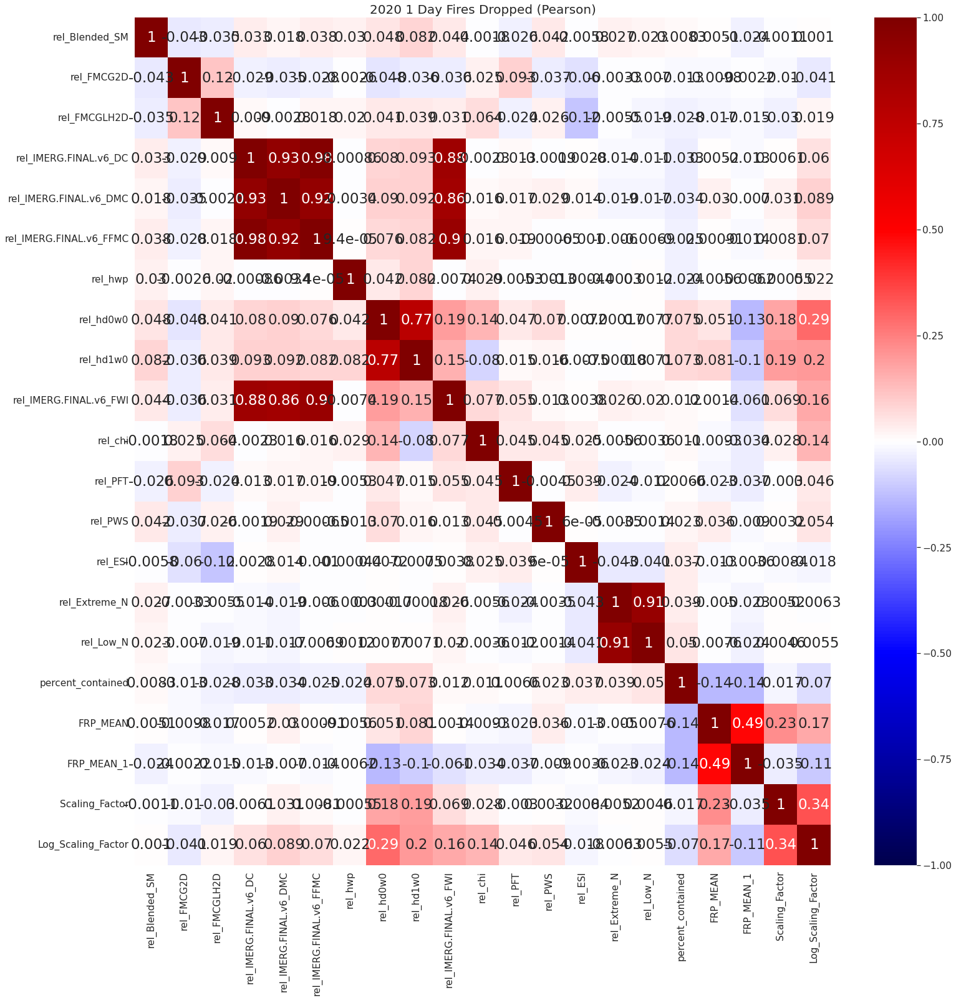

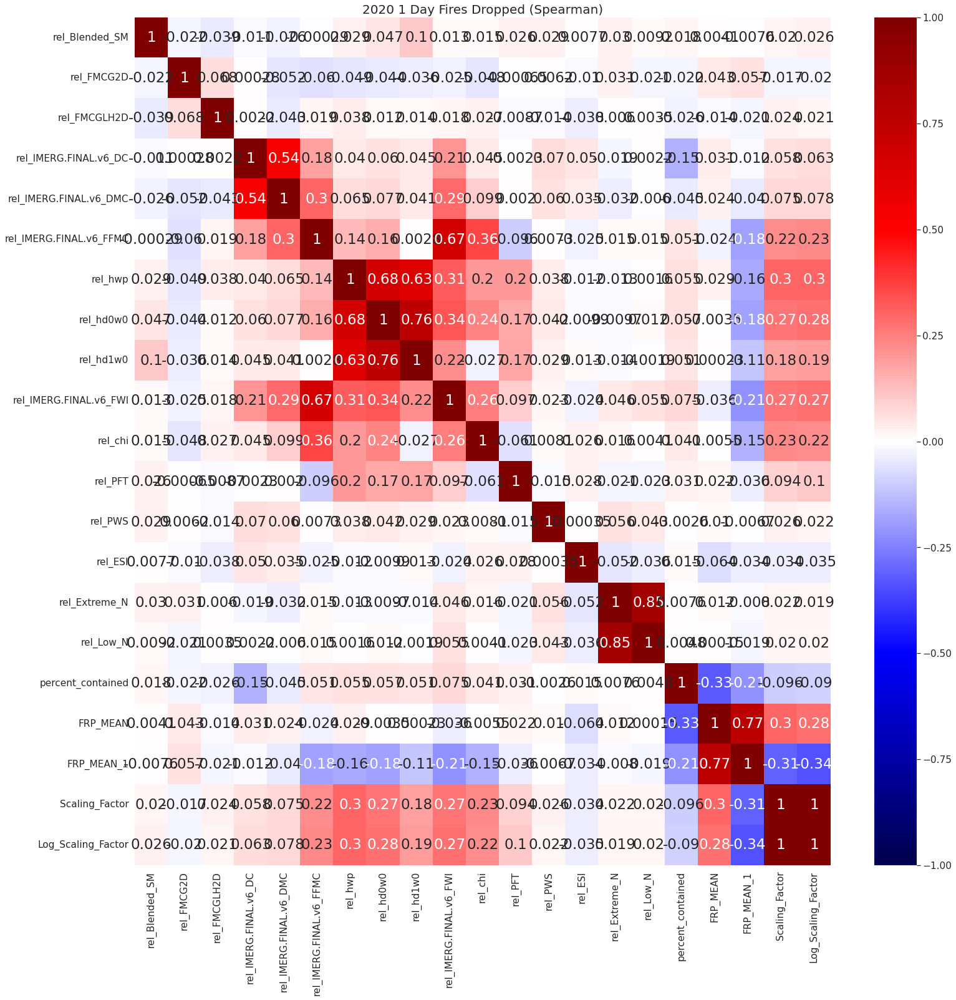

In [115]:
plot_correlations(features_with_shifts[['rel_Blended_SM', 'rel_FMCG2D', 'rel_FMCGLH2D', 'rel_IMERG.FINAL.v6_DC','rel_IMERG.FINAL.v6_DMC','rel_IMERG.FINAL.v6_FFMC','rel_hwp', 'rel_hd0w0', 'rel_hd1w0', 'rel_IMERG.FINAL.v6_FWI','rel_chi','rel_PFT','rel_PWS', 'rel_ESI','rel_Extreme_N','rel_Low_N','percent_contained','FRP_MEAN', 'FRP_MEAN_1','Scaling_Factor', 'Log_Scaling_Factor']], \
                  '2020 1 Day Fires Dropped (Pearson)','pearson')
plot_correlations(features_with_shifts[['rel_Blended_SM', 'rel_FMCG2D', 'rel_FMCGLH2D', 'rel_IMERG.FINAL.v6_DC','rel_IMERG.FINAL.v6_DMC','rel_IMERG.FINAL.v6_FFMC','rel_hwp', 'rel_hd0w0', 'rel_hd1w0', 'rel_IMERG.FINAL.v6_FWI','rel_chi','rel_PFT','rel_PWS', 'rel_ESI','rel_Extreme_N','rel_Low_N','percent_contained','FRP_MEAN', 'FRP_MEAN_1','Scaling_Factor', 'Log_Scaling_Factor']], \
                  '2020 1 Day Fires Dropped (Spearman)','spearman')

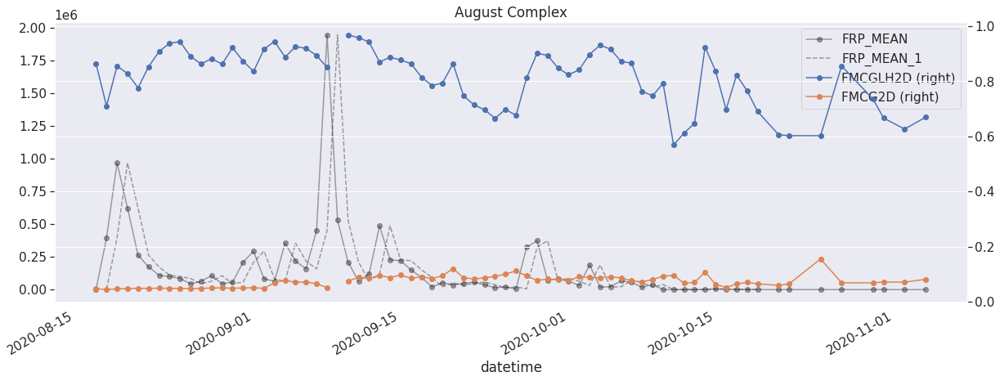

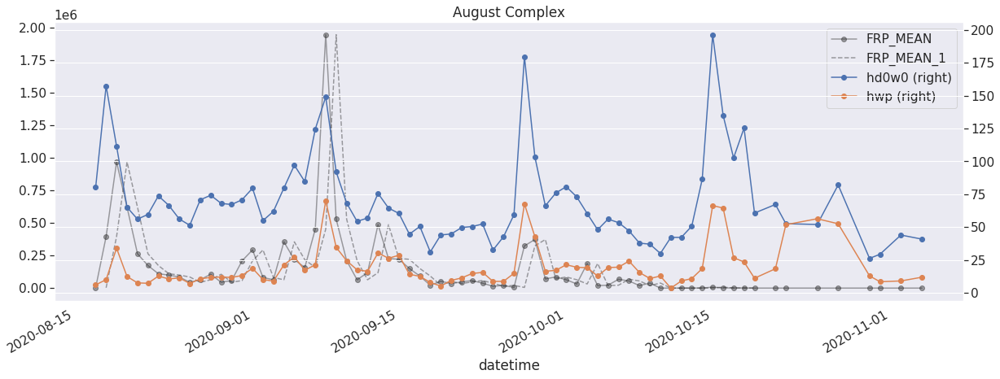

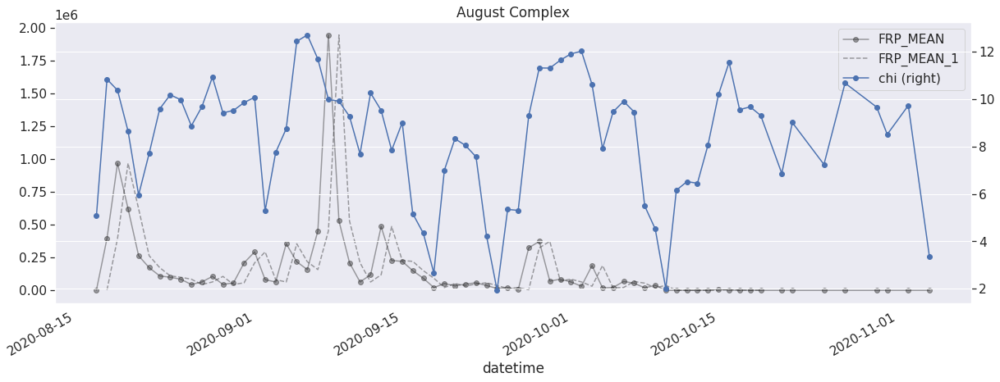

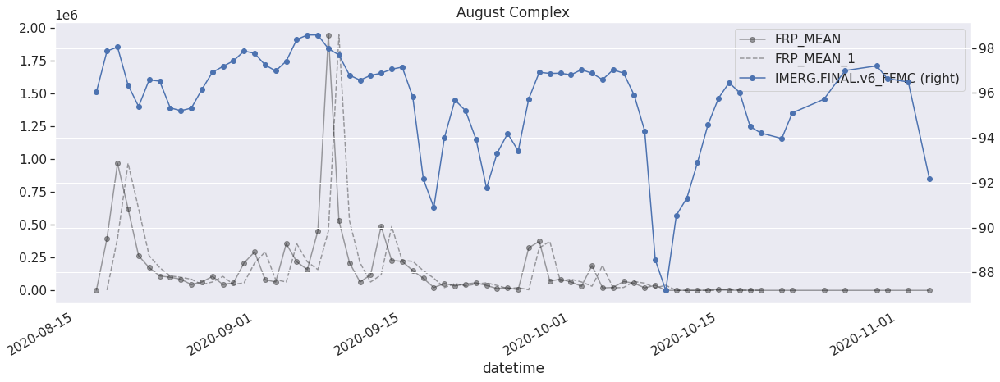

In [21]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
features_ac = features_with_shifts[features_with_shifts['irwinID']==ac['irwinID'].values[0][2:38]].reset_index()


#try to understand living fuel moisture a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['FMCGLH2D', 'FMCG2D'],style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()

#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['hd0w0', 'hwp'],style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()

#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['chi'],style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()

#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['IMERG.FINAL.v6_FFMC'],style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()

In [ ]:
print(features_ac[['datetime','FRP_MEAN', 'hwp']].values)

### Validation for 2020, HD0W0 Only

In [37]:
features_with_shifts['ratio_hd0w0'] = features_with_shifts['hd0w0']/features_with_shifts['hd0w0_1']
features_with_shifts['normal_diff_hd0w0'] = (features_with_shifts['hd0w0']-features_with_shifts['hd0w0_1'])/features_with_shifts['hd0w0']

features_with_shifts['persistence'] = np.ones(len(features_with_shifts))

methods_test = ['irwinID','datetime','persistence','ratio_hd0w0', 'normal_diff_hd0w0',
                'Scaling_Factor']
feat_validate = features_with_shifts[(~features_with_shifts['scaling_factor_is_outlier'])&
                                     (features_with_shifts['FRP_MEAN']>1000)].reset_index(drop=True) #drop the outliers and dead fires
feat_validate = feat_validate[methods_test].replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
feat_validate= feat_validate.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0
feat_validate

,irwinID,datetime,persistence,ratio_hd0w0,normal_diff_hd0w0,Scaling_Factor
0,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,2020-09-09,1.0,1.010877,0.010760,0.183570
1,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,2020-09-10,1.0,0.458325,-1.181859,0.784434
2,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,2020-09-11,1.0,0.600575,-0.665071,0.183692
3,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,2020-09-12,1.0,0.881300,-0.134687,0.498585
4,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,2020-08-26,1.0,0.698707,-0.431216,2.602551
...,...,...,...,...,...,...
1054,FEF1C45E-C557-4934-87CC-06B12392FFFA,2020-08-22,1.0,0.914343,-0.093681,1.494593
1055,FEF1C45E-C557-4934-87CC-06B12392FFFA,2020-08-23,1.0,1.001714,0.001711,0.117635
1056,FEF1C45E-C557-4934-87CC-06B12392FFFA,2020-08-24,1.0,1.001822,0.001819,0.619178
1057,FF0731C1-EC45-43FB-B0A7-9CDAECB282CD,2020-07-14,1.0,0.599699,-0.667502,0.363427


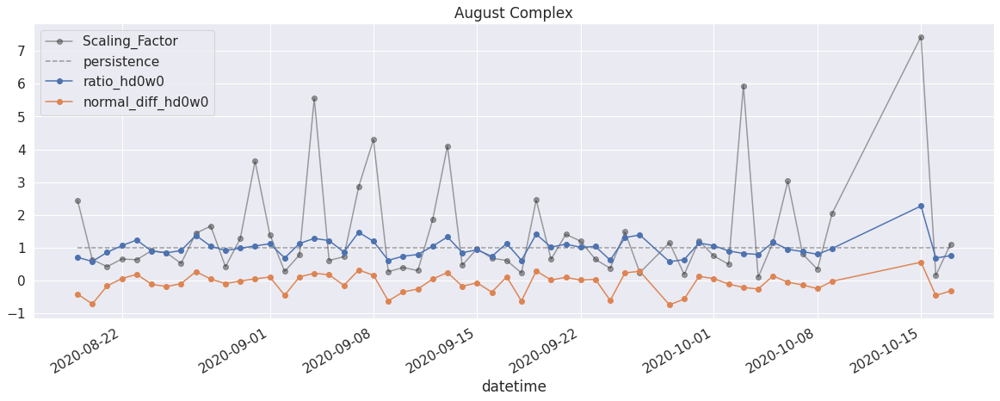

In [40]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
features_ac = feat_validate[feat_validate['irwinID']==ac['irwinID'].values[0][2:38]].reset_index()


#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['Scaling_Factor', 'persistence'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['ratio_hd0w0', 'normal_diff_hd0w0'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex')
plt.show()

In [ ]:
numrows_plot = int(np.ceil(len(methods_test)/2))
fig, axs = plt.subplots(numrows_plot,2, figsize=(14,14))

for ii in range(len(methods_test)):
    row=int(np.floor(ii/2))
    col = np.mod(ii,2)
    ax0 = feat_validate[methods_test[ii]].plot.hist(ax=axs[row, col], bins = 20)
    ax0.set(xlabel=methods_test[ii])
plt.show()

In [ ]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
features_ac = features_with_shifts[features_with_shifts['irwinID']==ac['irwinID'].values[0][2:38]].reset_index()

features_ac['rel_hd0w0_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_hd0w0']

#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['rel_hd0w0_FRP'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex')
plt.show()

In [ ]:

#error metrics
print('AUC: ')
for name in methods_test: 
    print(name+': '+ str(AUC(REC(feat_validate[name], feat_validate['Scaling_Factor'])[1])))#/AUC(REC(feat_validate['Scaling_Factor'], feat_validate['Scaling_Factor'])[1])))

print()
print('RMSE: ')
for name in methods_test:
    print(name+': '+ str(RMSE(feat_validate[name], feat_validate['Scaling_Factor'])))

print()
print('MAD: ')
for name in methods_test:
    print(name+': '+ str(MAD(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('MeAD: ')
for name in methods_test:
    print(name+': '+ str(MeAD(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('median_percent_error: ')
for name in methods_test:
    print(name+': '+ str(median_percent_error(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('mdrae: ')
for name in methods_test:
    print(name+': '+ str(mdrae(feat_validate['Scaling_Factor'], feat_validate[name], feat_validate['persistence'])))
    
    
# Medium post on error metrics https://t|owardsdatascience.com/time-series-forecast-error-metrics-you-should-know-cc88b8c67f27


In [ ]:
#REC CURVES
thresholds_persistence, accuracy_persistence = REC(feat_validate['persistence'], feat_validate['Scaling_Factor'])
thresh_hwp_hd0w0, accuracies_hwp_hd0w0 = REC(feat_validate['rel_hd0w0'].values, feat_validate['Scaling_Factor'].values)

thresh_sf, accuracies_sf = REC(feat_validate['Scaling_Factor'].values, feat_validate['Scaling_Factor'].values)



plt.figure(figsize=(10,10))
plt.plot(thresholds_persistence, accuracy_persistence,'k--',  label = 'Persistence')
plt.plot(thresh_hwp_hd0w0, accuracies_hwp_hd0w0,'m-',linewidth=2,label='rel_hd0w0')
plt.plot(thresh_sf, accuracies_sf, 'k-', linewidth=4, label='Ground Truth')

plt.legend(fontsize=15)
plt.title('REC Curve for the Methods Tested', fontsize=32)
plt.ylabel('Percent Correct', fontsize=24)
plt.xlabel('Absolute Error', fontsize=24)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(True)
plt.show()


### Validation for 2020, multiple feature indices

In [ ]:
#combined features
features_with_shifts['rel_hwp'] = features_with_shifts['hwp']/features_with_shifts['hwp_1']
features_with_shifts['rel_hd0w0'] = features_with_shifts['hd0w0']/features_with_shifts['hd0w0_1']
features_with_shifts['rel_fwi'] = features_with_shifts['IMERG.FINAL.v6_FWI']/features_with_shifts['IMERG.FINAL.v6_FWI_1']

features_with_shifts['rel_FFMC'] = features_with_shifts['IMERG.FINAL.v6_FFMC']/features_with_shifts['IMERG.FINAL.v6_FFMC_1']

#contained weather
features_with_shifts['cont_rel_hwp'] = (1-(features_with_shifts['percent_contained_1']/100))*features_with_shifts['rel_hwp']
features_with_shifts['cont_rel_hd0w0'] = (1-(features_with_shifts['percent_contained_1']/100))*features_with_shifts['rel_hd0w0']
features_with_shifts['cont_rel_fwi'] = (1-(features_with_shifts['percent_contained_1']/100))*features_with_shifts['rel_fwi']

#contained combined weather
features_with_shifts['cont_rel_hwp_hd0w0'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                                features_with_shifts['rel_hwp']*features_with_shifts['rel_hd0w0']
features_with_shifts['cont_rel_hwp_fwi'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                                features_with_shifts['rel_hwp']*features_with_shifts['rel_fwi']
features_with_shifts['cont_rel_hd0w0_fwi'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                                features_with_shifts['rel_hd0w0']*features_with_shifts['rel_fwi']

features_with_shifts['cont_rel_hwp_hd0w0_fwi'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                            features_with_shifts['rel_hwp']*features_with_shifts['rel_hd0w0']*features_with_shifts['rel_fwi']


#weather and moisture

features_with_shifts['cont_rel_hwp_ffmc'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                                features_with_shifts['rel_hwp']*features_with_shifts['rel_FFMC']
features_with_shifts['cont_rel_hwp_FMCGLH2D'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                                features_with_shifts['rel_hwp']*features_with_shifts['rel_FMCGLH2D']




In [ ]:
features_with_shifts = find_outliers(features_with_shifts, 'rel_hwp')
#print(features_with_shifts[['datetime','rel_hwp', 'rel_hwp_is_outlier']].values)

In [ ]:
#compare rel_* with Scaling_Factor, for the ones that ARE NOT OUTLIERS
features_with_shifts['persistence'] = np.ones(len(features_with_shifts))

methods_test = ['datetime','persistence','rel_hwp','ks',
                'Scaling_Factor']
feat_validate = features_with_shifts[~features_with_shifts['scaling_factor_is_outlier']].reset_index(drop=True) #drop the outliers
feat_validate = feat_validate[methods_test].replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
feat_validate= feat_validate.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0
feat_validate

In [ ]:
#error metrics
print('AUC (as fraction of area under ground truth curve): ')
for name in methods_test: 
    print(name+': '+ str(AUC(REC(feat_validate[name], feat_validate['Scaling_Factor'])[1])))#/AUC(REC(feat_validate['Scaling_Factor'], feat_validate['Scaling_Factor'])[1])))

print()
print('RMSE: ')
for name in methods_test:
    print(name+': '+ str(RMSE(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('MeAD: ')
for name in methods_test:
    print(name+': '+ str(MeAD(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('median_percent_error: ')
for name in methods_test:
    print(name+': '+ str(median_percent_error(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('mdrae: ')
for name in methods_test:
    print(name+': '+ str(mdrae(feat_validate['Scaling_Factor'], feat_validate[name], feat_validate['persistence'])))
    
# Medium post on error metrics https://t|owardsdatascience.com/time-series-forecast-error-metrics-you-should-know-cc88b8c67f27


In [ ]:
#REC CURVES
thresholds_persistence, accuracy_persistence = REC(feat_validate['persistence'], feat_validate['Scaling_Factor'])
thresh_hwp, accuracies_hwp = REC(feat_validate['rel_hwp'].values, feat_validate['Scaling_Factor'].values)
thresh_cont_hwp, accuracies_cont_hwp = REC(feat_validate['cont_rel_hwp'].values, feat_validate['Scaling_Factor'].values)
thresh_cont_hwp_fwi, accuracies_cont_hwp_fwi = REC(feat_validate['cont_rel_hwp_fwi'].values, feat_validate['Scaling_Factor'].values)

thresh_sf, accuracies_sf = REC(feat_validate['Scaling_Factor'].values, feat_validate['Scaling_Factor'].values)



plt.figure(figsize=(10,10))
plt.plot(thresholds_persistence, accuracy_persistence,'k--',  label = 'Persistence')
plt.plot(thresh_hwp, accuracies_hwp,'g-',linewidth=4,label='rel_hwp')
plt.plot(thresh_cont_hwp, accuracies_cont_hwp,'m-',linewidth=4,label='cont_rel_hwp')
plt.plot(thresh_cont_hwp_fwi, accuracies_cont_hwp_fwi,'y-',linewidth=4,label='cont_rel_hwp_fwi')
plt.plot(thresholds_persistence, accuracy_persistence,'k--',  label = 'Persistence')
plt.plot(thresh_sf, accuracies_sf, 'k-', linewidth=4, label='Ground Truth')
 
plt.legend(fontsize=15)
plt.title('REC Curve for the Methods Tested', fontsize=32)
plt.ylabel('Percent Correct', fontsize=24)
plt.xlabel('Absolute Error', fontsize=24)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(True)
plt.show()


### Validation for 2020, single feature indices only
This  is the one I show in the May 1st, 2023 Slideshow

In [60]:
#soil moisture (LEAVE OUT LIVING, NOT SURE WHAT TO DO!)
features_with_shifts['rel_Blended_SM'] = features_with_shifts['Blended_SM_1']/features_with_shifts['Blended_SM'] #flipped bc inverse relationship
features_with_shifts['rel_FMCG2D'] = features_with_shifts['FMCG2D_1']/features_with_shifts['FMCG2D'] #flipped bc inverse relationship
features_with_shifts['rel_DC'] = features_with_shifts['IMERG.FINAL.v6_DC']/features_with_shifts['IMERG.FINAL.v6_DC_1']
features_with_shifts['rel_DMC'] = features_with_shifts['IMERG.FINAL.v6_DMC']/features_with_shifts['IMERG.FINAL.v6_DMC_1']
features_with_shifts['rel_FFMC'] = features_with_shifts['IMERG.FINAL.v6_FFMC']/features_with_shifts['IMERG.FINAL.v6_FFMC_1']
features_with_shifts['rel_FMCGLH2D'] = features_with_shifts['FMCGLH2D']/features_with_shifts['FMCGLH2D_1']

#weather
features_with_shifts['rel_hwp'] = features_with_shifts['hwp']/features_with_shifts['hwp_1']
features_with_shifts['rel_hd0w0'] = features_with_shifts['hd0w0']/features_with_shifts['hd0w0_1']
features_with_shifts['rel_hd1w0'] = features_with_shifts['hd1w0']/features_with_shifts['hd1w0_1']
features_with_shifts['rel_hd2w0'] = features_with_shifts['hd2w0']/features_with_shifts['hd2w0_1']
features_with_shifts['rel_fwi'] = features_with_shifts['IMERG.FINAL.v6_FWI']/features_with_shifts['IMERG.FINAL.v6_FWI_1']

#fuel loading (flip because of negative correlation)
features_with_shifts['rel_Low_N'] = features_with_shifts['Low_N_1']/features_with_shifts['Low_N']
features_with_shifts['rel_Moderate_N'] = features_with_shifts['Moderate_N_1']/features_with_shifts['Moderate_N']
features_with_shifts['rel_High_N'] = features_with_shifts['High_N_1']/features_with_shifts['High_N']
features_with_shifts['rel_VeryHigh_N'] = features_with_shifts['VeryHigh_N_1']/features_with_shifts['VeryHigh_N']
features_with_shifts['rel_Extreme_N'] = features_with_shifts['Extreme_N_1']/features_with_shifts['Extreme_N']

#stability
features_with_shifts['rel_chi'] = features_with_shifts['chi']/features_with_shifts['chi_1']
features_with_shifts['rel_pft'] = features_with_shifts['PFT']/features_with_shifts['PFT_1']

#chain a bunch together
features_with_shifts['ks'] = (1-(features_with_shifts['percent_contained_1']/100))*\
                                features_with_shifts['rel_hwp']*features_with_shifts['rel_FFMC']*\
                                features_with_shifts['rel_chi']*features_with_shifts['rel_Low_N']


In [61]:
#compare rel_* with Scaling_Factor, for the ones that ARE NOT OUTLIERS
features_with_shifts['persistence'] = np.ones(len(features_with_shifts))

methods_test = ['persistence', 'rel_hwp', 'rel_hd0w0', 'rel_hd1w0','rel_hd2w0','''rel_fwi',
                'rel_Blended_SM','rel_FMCG2D','rel_FMCGLH2D', 'rel_DC', 'rel_DMC', 'rel_FFMC',
                'rel_Low_N', 'rel_Moderate_N', 'rel_High_N', 'rel_VeryHigh_N','rel_Extreme_N',
                'rel_chi', 'rel_pft',
                'Scaling_Factor']
feat_validate = features_with_shifts[(~features_with_shifts['scaling_factor_is_outlier'])&
                                     (features_with_shifts['FRP_MEAN']>1000)].reset_index(drop=True) #drop the outliers and dead fires
feat_validate = feat_validate[methods_test].replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
feat_validate= feat_validate.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0
feat_validate

,persistence,rel_hwp,rel_hd0w0,rel_hd1w0,rel_hd2w0,rel_fwi,rel_Blended_SM,rel_FMCG2D,rel_FMCGLH2D,rel_DC,...,rel_FFMC,rel_Low_N,rel_Moderate_N,rel_High_N,rel_VeryHigh_N,rel_Extreme_N,rel_chi,rel_pft,ks,Scaling_Factor
0,1.0,0.200852,0.600575,0.890380,1.137536,0.850910,1.111428,1.312757,1.195993,1.012251,...,0.989841,0.933903,0.980476,1.030521,1.037310,1.022818,0.805037,1.794887,0.149471,0.183692
1,1.0,1.376032,0.881300,0.678199,0.865729,0.908600,1.104429,1.155124,1.110631,1.012736,...,0.990030,1.013061,1.001481,0.989031,0.987408,0.990905,1.041910,2.048905,1.294151,0.498585
2,1.0,0.887699,0.698707,0.794811,0.884147,0.975474,0.976846,0.983618,1.041144,1.007465,...,1.004722,1.106347,1.097164,1.073092,1.073089,1.075729,0.948460,0.304783,0.935883,2.602551
3,1.0,1.025795,1.548571,1.270577,1.419618,0.935564,0.998126,0.997138,1.082685,1.015185,...,1.000554,1.517729,1.580547,1.799567,1.798087,1.773448,0.971974,0.417942,1.514085,0.627882
4,1.0,1.351475,1.013856,1.048834,0.937868,0.946554,1.030301,1.016330,1.039055,1.013683,...,0.984990,1.042547,1.042913,1.039770,1.040011,1.040027,1.022262,33.570131,1.418723,1.290980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
984,1.0,1.468930,0.914343,1.089611,0.966209,0.977291,0.892713,1.002203,0.985827,1.019456,...,1.000432,1.263828,1.166533,1.115688,1.106527,1.124388,0.995829,1.559838,0.924765,1.494593
985,1.0,0.640643,1.001714,0.867918,1.031399,1.103934,1.014151,0.979406,1.100015,1.029136,...,1.001599,0.671810,0.801259,0.904668,0.923173,0.886620,1.018846,1.307069,0.175681,0.117635
986,1.0,0.534733,1.001822,1.206874,1.048477,1.052613,1.087179,0.986400,1.004231,1.024094,...,0.996769,0.805994,0.860108,0.903388,0.912636,0.895006,0.877010,1.164952,0.113029,0.619178
987,1.0,0.634535,0.599699,0.600878,0.637360,0.762615,1.027366,1.069497,1.163894,1.012945,...,0.992768,0.748056,0.760691,0.789169,0.789436,0.786250,1.075911,1.023362,0.507007,0.363427


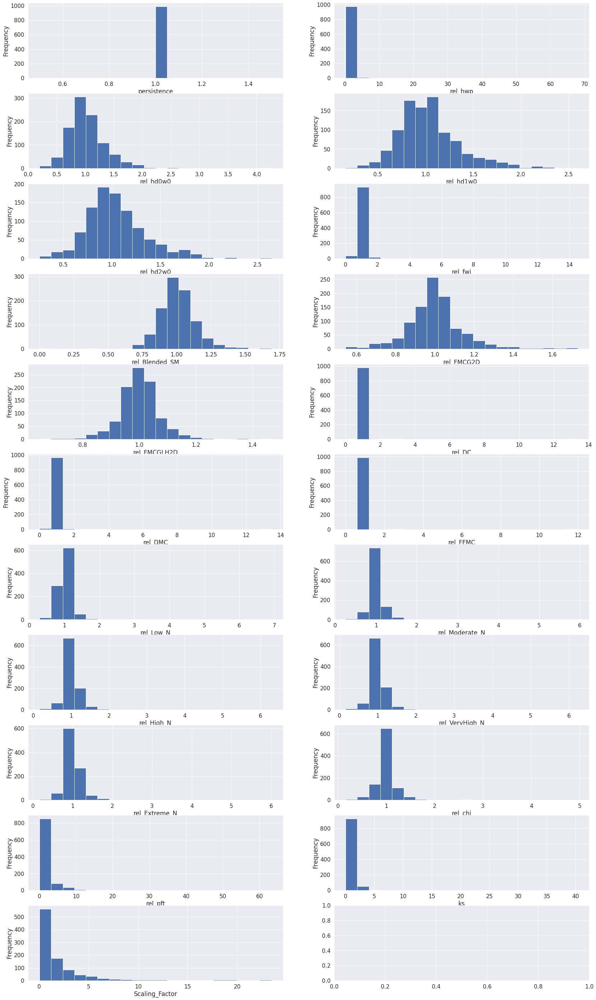

In [62]:
numrows_plot = int(np.ceil(len(methods_test)/2))
fig, axs = plt.subplots(numrows_plot,2, figsize=(28,50))

for ii in range(len(methods_test)):
    row=int(np.floor(ii/2))
    col = np.mod(ii,2)
    ax0 = feat_validate[methods_test[ii]].plot.hist(ax=axs[row, col], bins = 20)
    ax0.set(xlabel=methods_test[ii])

plt.show()

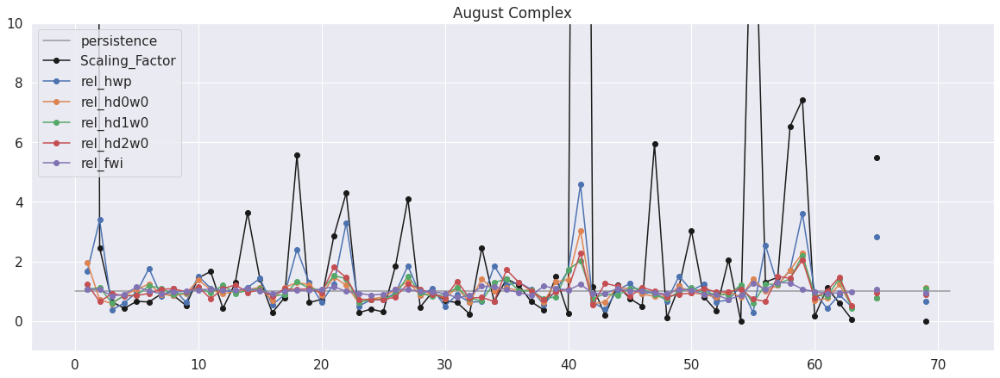

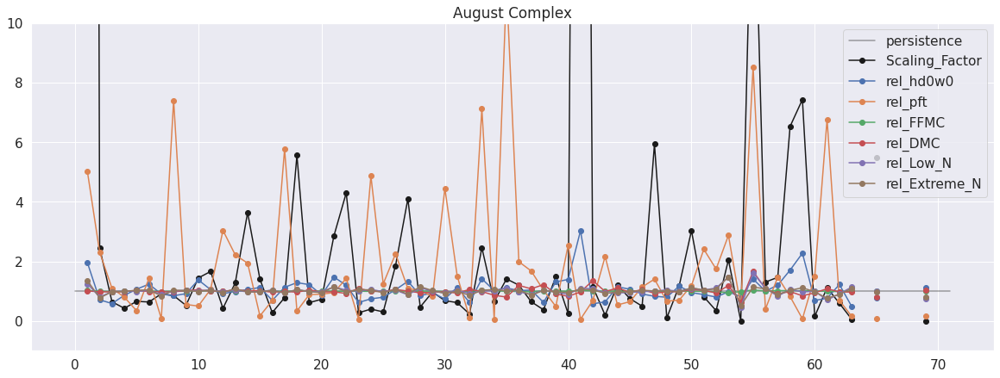

In [72]:
#plot the scaling factors for AC
#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
features_ac.plot(y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(y=['rel_hwp', 'rel_hd0w0', 'rel_hd1w0', 'rel_hd2w0','rel_fwi'],style='o-', ax=ax)
plt.title('August Complex')
ax.set_ylim(-1,10)
plt.show()

#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
features_ac.plot(y=['Scaling_Factor'],style=['ko-'], ax=ax)
features_ac.plot(y=['rel_hd0w0', 'rel_pft', 'rel_FFMC','rel_DMC', 'rel_Low_N','rel_Extreme_N'],style='o-', ax=ax)
plt.title('August Complex')
ax.set_ylim(-1,10)
plt.show()

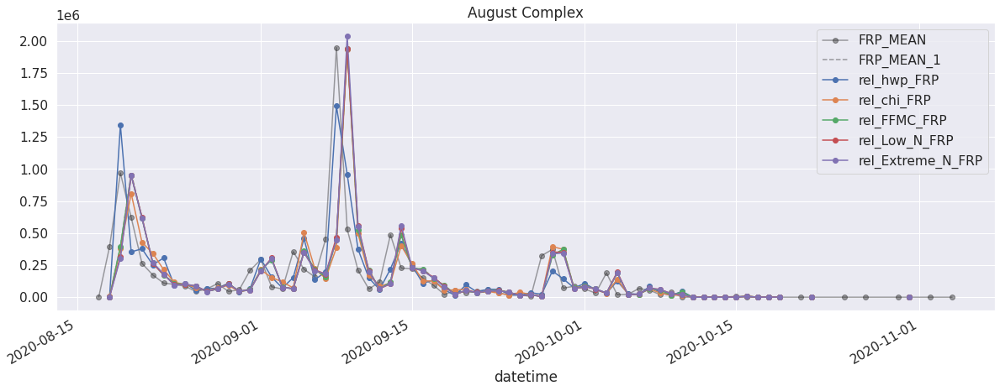

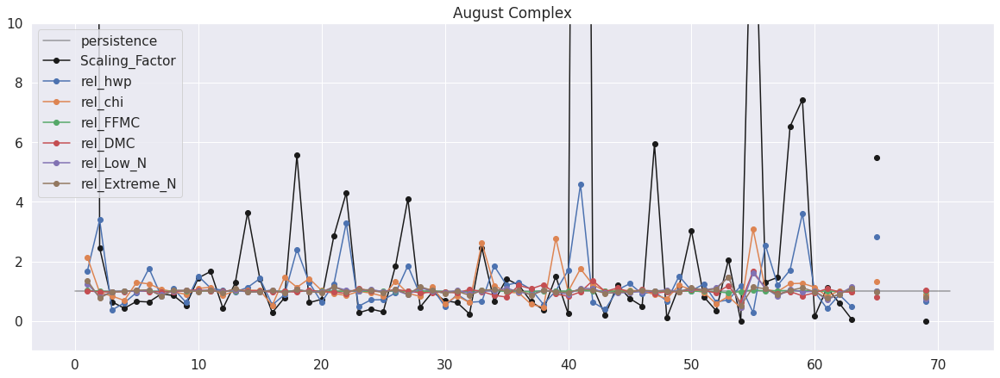

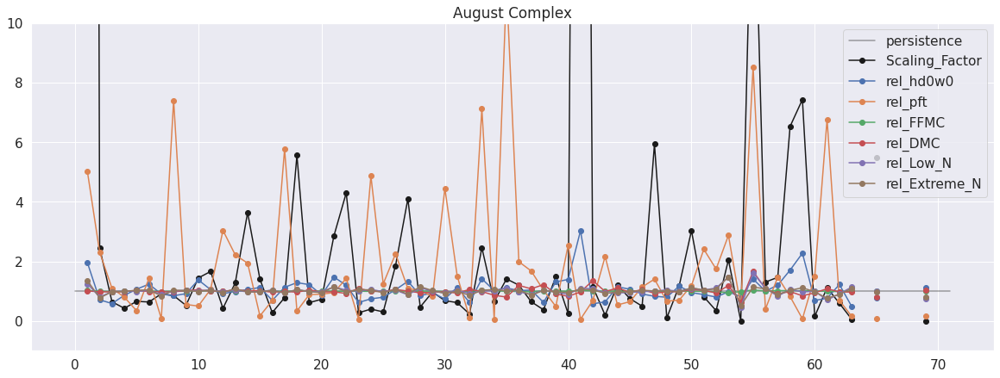

In [69]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
features_ac = features_with_shifts[features_with_shifts['irwinID']==ac['irwinID'].values[0][2:38]].reset_index()

features_ac['rel_hwp_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_hwp']
features_ac['rel_chi_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_chi']
features_ac['rel_FFMC_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_FFMC']
features_ac['rel_DMC_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_DMC']

features_ac['rel_Low_N_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_Low_N']
features_ac['rel_Extreme_N_FRP'] = features_ac['FRP_MEAN_1']*features_ac['rel_Extreme_N']



#try to understand changes in features a bit more
fig, ax = plt.subplots(figsize=(20, 7))
features_ac.plot(x='datetime',y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(x='datetime',y=['rel_hwp_FRP', 'rel_chi_FRP', 'rel_FFMC_FRP', 'rel_Low_N_FRP','rel_Extreme_N_FRP'],style='o-',ax=ax, secondary_y=False)
plt.title('August Complex')
plt.show()




In [27]:
#error metrics
print('AUC (as fraction of area under ground truth curve): ')
for name in methods_test: 
    print(name+': '+ str(AUC(REC(feat_validate[name], feat_validate['Scaling_Factor'])[1])))#/AUC(REC(feat_validate['Scaling_Factor'], feat_validate['Scaling_Factor'])[1])))

"""print()
print('RMSE: ')
for name in methods_test:
    print(name+': '+ str(RMSE(feat_validate[name], feat_validate['Scaling_Factor'])))

print()
print('MAD: ')
for name in methods_test:
    print(name+': '+ str(MAD(feat_validate[name], feat_validate['Scaling_Factor']))) """
    
print()
print('MeAD: ')
for name in methods_test:
    print(name+': '+ str(MeAD(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('median_percent_error: ')
for name in methods_test:
    print(name+': '+ str(median_percent_error(feat_validate[name], feat_validate['Scaling_Factor'])))
    
print()
print('mdrae: ')
for name in methods_test:
    print(name+': '+ str(mdrae(feat_validate['Scaling_Factor'], feat_validate[name], feat_validate['persistence'])))
    
    
# Medium post on error metrics https://t|owardsdatascience.com/time-series-forecast-error-metrics-you-should-know-cc88b8c67f27


AUC (as fraction of area under ground truth curve): 
persistence: 1813.8422649140548
rel_hwp: 1819.6056622851365
rel_hd0w0: 1819.6056622851365
rel_hd1w0: 1818.6754297269972
rel_hd2w0: 1816.7340748230538
rel_fwi: 1816.0869565217392
rel_Blended_SM: 1812.4570273003035
rel_FMCG2D: 1813.4277047522753
rel_FMCGLH2D: 1813.862487360971
rel_DC: 1814.1051567239638
rel_DMC: 1814.459049544995
rel_FFMC: 1814.1961577350862
rel_Low_N: 1812.0829120323563
rel_Moderate_N: 1812.2548028311428
rel_High_N: 1811.9110212335695
rel_VeryHigh_N: 1811.9312436804855
rel_Extreme_N: 1811.9817997977757
rel_chi: 1815.4297269969668
rel_pft: 1753.1749241658242
ks: 1811.7593528816988
Scaling_Factor: 2000.0

MeAD: 
persistence: 0.6882564282591702
rel_hwp: 0.6150963828896437
rel_hd0w0: 0.6200745525657603
rel_hd1w0: 0.6414080068067449
rel_hd2w0: 0.6606710956386594
rel_fwi: 0.6341793867333624
rel_Blended_SM: 0.6981229503152371
rel_FMCG2D: 0.6789990172184206
rel_FMCGLH2D: 0.6765088407895972
rel_DC: 0.6836395303334726
rel_DMC: 

In [ ]:
#REC CURVES
thresholds_persistence, accuracy_persistence = REC(feat_validate['persistence'], feat_validate['Scaling_Factor'])
#thresh_hwp_ffmc_chi, accuracies_hwp_ffmc_chi = REC(feat_validate['rel_hwp_ffmc_chi'].values, feat_validate['Scaling_Factor'].values)
thresh_hwp, accuracies_hwp = REC(feat_validate['rel_hwp'].values, feat_validate['Scaling_Factor'].values)
thresh_hwp_hd0w0, accuracies_hwp_hd0w0 = REC(feat_validate['rel_hd1w0'].values, feat_validate['Scaling_Factor'].values)
thresh_ks, accuracies_ks = REC(feat_validate['ks'].values, feat_validate['Scaling_Factor'].values)

thresh_sf, accuracies_sf = REC(feat_validate['Scaling_Factor'].values, feat_validate['Scaling_Factor'].values)



plt.figure(figsize=(10,10))
plt.plot(thresholds_persistence, accuracy_persistence,'k--',  label = 'Persistence')
plt.plot(thresh_ks, accuracies_ks,'b-',linewidth=2,label='ks')
plt.plot(thresh_hwp, accuracies_hwp,'g-',linewidth=2,label='rel_hwp')
plt.plot(thresh_hwp_hd0w0, accuracies_hwp_hd0w0,'m-',linewidth=2,label='rel_hd1w0')
plt.plot(thresh_sf, accuracies_sf, 'k-', linewidth=4, label='Ground Truth')

plt.legend(fontsize=15)
plt.title('REC Curve for the Methods Tested', fontsize=32)
plt.ylabel('Percent Correct', fontsize=24)
plt.xlabel('Absolute Error', fontsize=24)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(True)
plt.show()


## Machine Learning, predict the scaling factor

In [22]:
#compare rel_* with Scaling_Factor, for the ones that ARE NOT OUTLIERS
features_with_shifts['persistence'] = np.ones(len(features_with_shifts))

methods_test = ['datetime', 'irwinID','persistence', 'rel_hwp', 'rel_hd0w0', 'rel_hd1w0','rel_hd2w0','rel_IMERG.FINAL.v6_FWI',
                'Blended_SM','rel_FMCG2D','rel_FMCGLH2D', 'IMERG.FINAL.v6_DC', 'rel_IMERG.FINAL.v6_DMC', 
                'rel_IMERG.FINAL.v6_FFMC',
                'Low_N', 'rel_Moderate_N', 'rel_High_N', 'rel_VeryHigh_N','rel_Extreme_N',
                'rel_chi', 'PFT', 'ESI', 'PWS', 'percent_contained_1',
                'Scaling_Factor','FRP_MEAN', 'FRP_MEAN_1', 'Log_Scaling_Factor']
feat_validate = features_with_shifts[(~features_with_shifts['scaling_factor_is_outlier'])&
                                     (features_with_shifts['FRP_MEAN']>1000)].reset_index(drop=True) #drop the outliers and dead fires
feat_validate = feat_validate[methods_test].replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
feat_validate= feat_validate.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0
feat_validate

,datetime,irwinID,persistence,rel_hwp,rel_hd0w0,rel_hd1w0,rel_hd2w0,rel_IMERG.FINAL.v6_FWI,Blended_SM,rel_FMCG2D,...,rel_Extreme_N,rel_chi,PFT,ESI,PWS,percent_contained_1,Scaling_Factor,FRP_MEAN,FRP_MEAN_1,Log_Scaling_Factor
0,2020-09-11,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,1.0,0.200852,0.600575,0.890380,1.137536,0.850910,0.285683,0.761756,...,0.977691,0.805037,65.977103,-0.827225,1.006399,0.0,0.183692,2706.065915,14731.512078,-0.735909
1,2020-09-12,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,1.0,1.376032,0.881300,0.678199,0.865729,0.908600,0.258670,0.865708,...,1.009179,1.041910,135.180799,-0.909345,0.868302,10.0,0.498585,1349.205056,2706.065915,-0.302260
2,2020-08-26,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,0.887699,0.698707,0.794811,0.884147,0.975474,0.159800,1.016655,...,0.929602,0.948460,49.695394,-1.958310,1.612045,0.0,2.602551,6981.402969,2682.522659,0.415399
3,2020-08-27,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,1.025795,1.548571,1.270577,1.419618,0.935564,0.160100,1.002870,...,0.563873,0.971974,20.769804,-1.992005,1.501609,0.0,0.627882,4383.497981,6981.402969,-0.202122
4,2020-08-28,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,1.351475,1.013856,1.048834,0.937868,0.946554,0.155391,0.983932,...,0.961514,1.022262,697.245021,-1.899280,1.564319,0.0,1.290980,5659.009813,4383.497981,0.110920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
985,2020-08-22,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,1.468930,0.914343,1.089611,0.966209,0.977291,0.322500,0.997802,...,0.889372,0.995829,143.417871,0.401909,0.262480,50.0,1.494593,19220.669037,12860.137185,0.174523
986,2020-08-23,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,0.640643,1.001714,0.867918,1.031399,1.103934,0.318000,1.021027,...,1.127879,1.018846,187.457065,-0.388141,0.993448,60.0,0.117635,2261.014709,19220.669037,-0.929465
987,2020-08-24,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,0.534733,1.001822,1.206874,1.048477,1.052613,0.292500,1.013788,...,1.117311,0.877010,218.378562,-0.323839,1.304017,70.0,0.619178,1399.971207,2261.014709,-0.208184
988,2020-07-14,FF0731C1-EC45-43FB-B0A7-9CDAECB282CD,1.0,0.634535,0.599699,0.600878,0.637360,0.762615,0.175400,0.935019,...,1.271860,1.075911,461.196829,-0.777753,1.323523,0.0,0.363427,1272.865791,3502.395985,-0.439583


In [31]:
# drop containment >50%, hmm  I don't know
feat_validate = feat_validate[feat_validate['percent_contained_1']<50]

In [44]:

#do the train-test split
data_test = feat_validate[feat_validate['irwinID']==ac['irwinID'].values[0][2:38]].reset_index(drop=True)
data_train = feat_validate[~(feat_validate['irwinID']==ac['irwinID'].values[0][2:38])].reset_index(drop=True)
print(data_train.columns)
print(len(data_train))

Index(['datetime', 'irwinID', 'persistence', 'rel_hwp', 'rel_hd0w0',
       'rel_hd1w0', 'rel_hd2w0', 'rel_IMERG.FINAL.v6_FWI', 'Blended_SM',
       'rel_FMCG2D', 'rel_FMCGLH2D', 'IMERG.FINAL.v6_DC',
       'rel_IMERG.FINAL.v6_DMC', 'rel_IMERG.FINAL.v6_FFMC', 'Low_N',
       'rel_Moderate_N', 'rel_High_N', 'rel_VeryHigh_N', 'rel_Extreme_N',
       'rel_chi', 'PFT', 'ESI', 'PWS', 'percent_contained_1', 'Scaling_Factor',
       'FRP_MEAN', 'FRP_MEAN_1', 'Log_Scaling_Factor'],
      dtype='object')
938


TimeSeriesSplit(gap=0, max_train_size=None, n_splits=6, test_size=None)
-0.10411238884588792


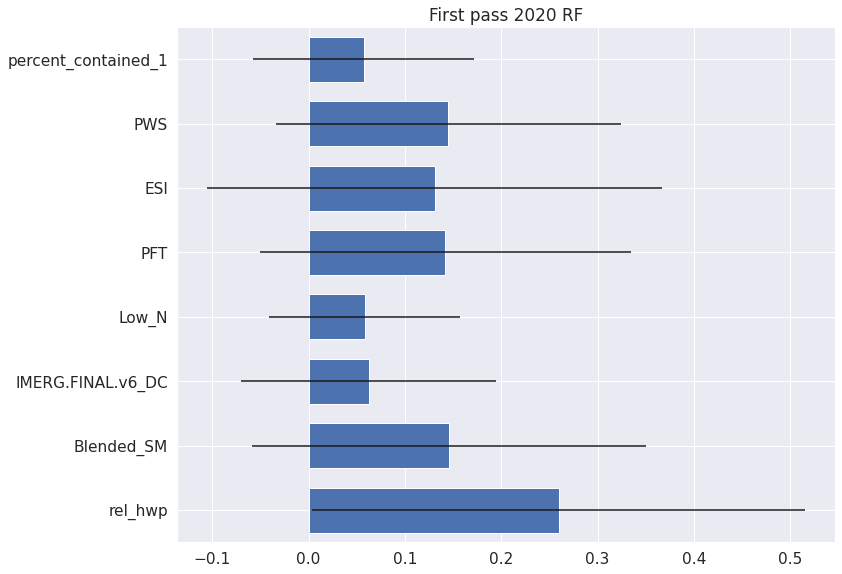

-0.019839232589099254


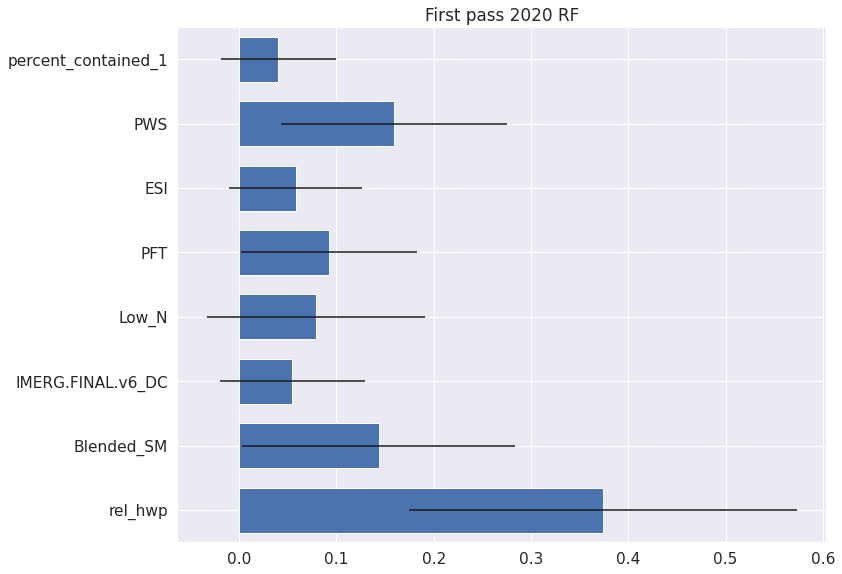

0.023384287737195253


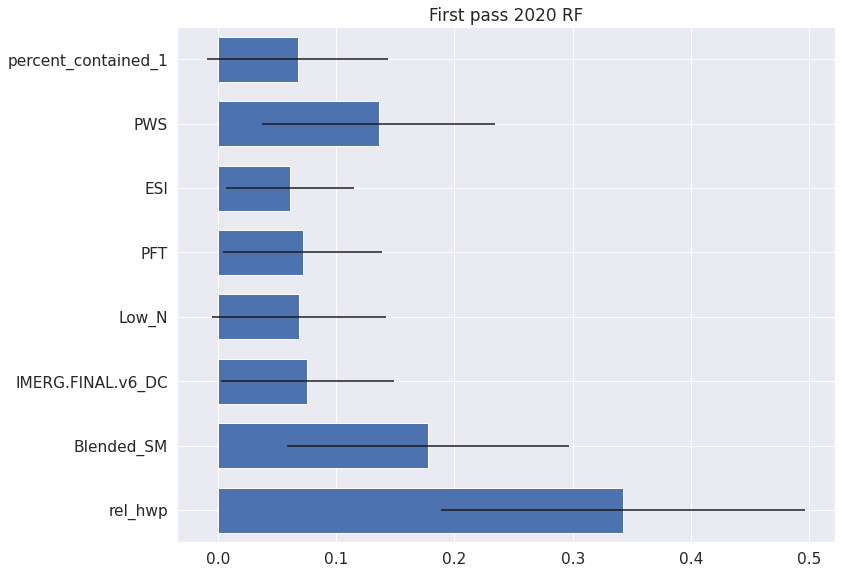

0.045934964761818464


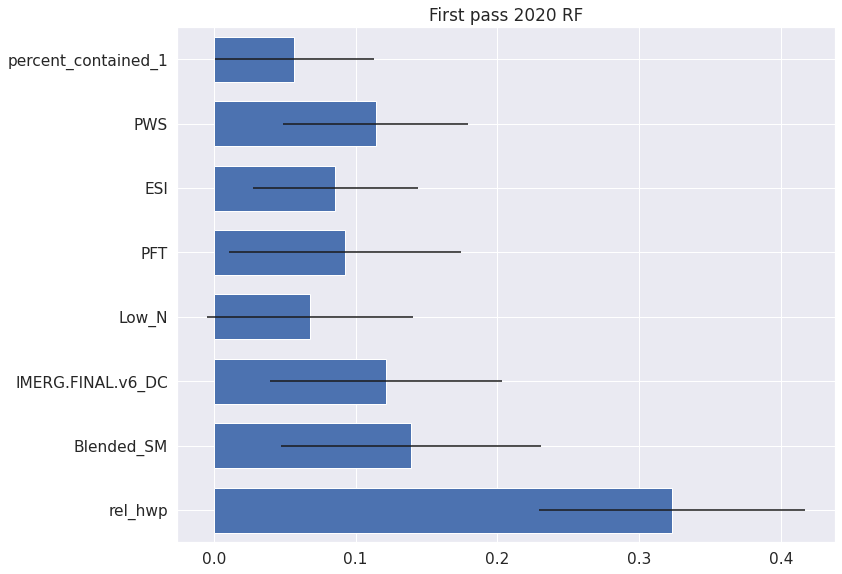

0.057977860564686234


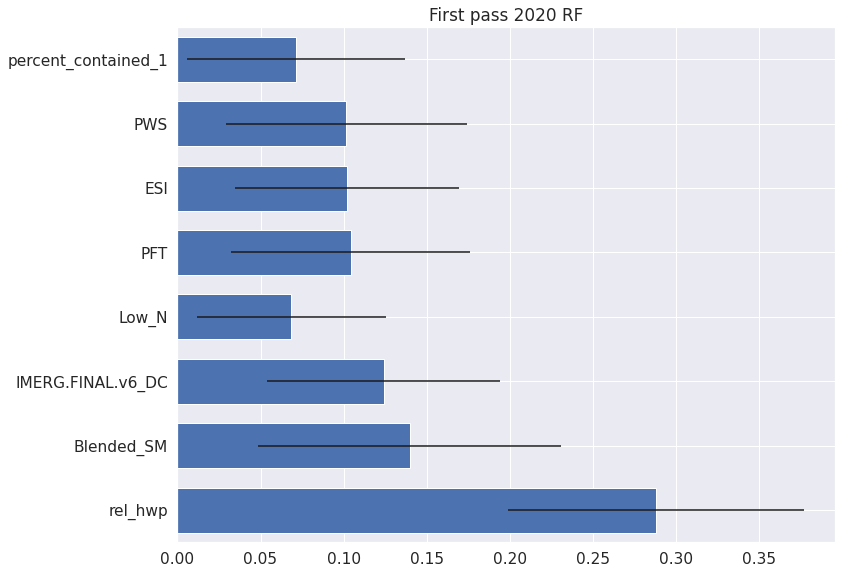

0.020008312553827512


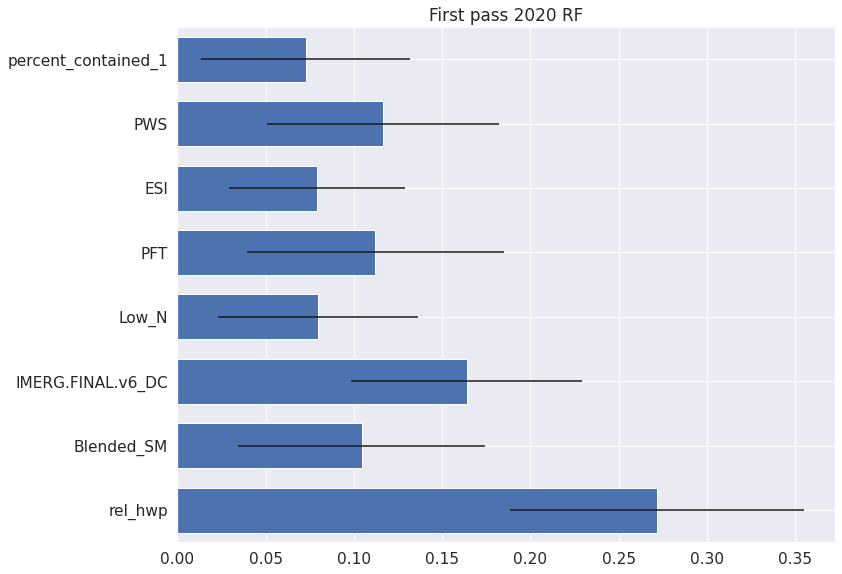

In [206]:
#time series cross validation, is this better?
data_train_sorted = data_train.sort_values(by='datetime').reset_index(drop=True)
tscv = TimeSeriesSplit(n_splits=6)
print(tscv)
for train, test in tscv.split(data_train_sorted):
    #print("%s %s" % (train, test))
    
    df_train = data_train_sorted.iloc[train]
    df_test = data_train_sorted.iloc[test]
    
    rf_sf = RandomForestRegressor(oob_score=True,min_samples_leaf=5, random_state=42) #scaling is not necessary!
    rf_sf.fit(df_train.loc[:, training_variables], df_train.loc[:, ['Scaling_Factor']])
    print(rf_sf.oob_score_)
    
    rf_sf_pred = rf_sf.predict(df_test.loc[:,training_variables])

    plot_importances(rf_sf, training_variables,'First pass 2020 RF')
    


In [25]:
training_variables=['rel_hwp', 'Blended_SM',
                    'IMERG.FINAL.v6_DC',  'Low_N',
                    'PFT', 'ESI', 'PWS', 'percent_contained_1']
data_train_sorted = data_train.sort_values(by='datetime').reset_index(drop=True)
tscv = TimeSeriesSplit(n_splits=5)

parameters = {'n_estimators':[50, 150, 250], 'max_depth':[2,4,6,8], 'min_samples_leaf': [2,4,6],
             'max_features': ['sqrt', 'log2', None]}
rf = RandomForestRegressor(oob_score=True,random_state=42) #scaling is not necessary!

search = GridSearchCV(rf, param_grid= parameters, cv=tscv,
                         scoring=('neg_mean_squared_log_error'),
                         return_train_score=True, verbose=3)

search.fit(data_train_sorted.loc[:, training_variables], data_train_sorted.loc[:, ['Scaling_Factor']])

Fitting 5 folds for each of 108 candidates, totalling 540 fits
[CV 1/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=50;, score=(train=-0.659, test=-0.811) total time=   0.1s
[CV 2/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=50;, score=(train=-0.585, test=-0.521) total time=   0.1s
[CV 3/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=50;, score=(train=-0.559, test=-0.443) total time=   0.1s
[CV 4/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=50;, score=(train=-0.491, test=-0.552) total time=   0.1s
[CV 5/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=50;, score=(train=-0.511, test=-0.561) total time=   0.1s
[CV 1/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=150;, score=(train=-0.666, test=-0.852) total time=   0.2s
[CV 2/5] END max_depth=2, max_features=sqrt, min_samples_leaf=2, n_estimators=150;, score=(train=-0.591, test=-0.529) to

[CV 3/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=50;, score=(train=-0.548, test=-0.470) total time=   0.1s
[CV 4/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=50;, score=(train=-0.479, test=-0.542) total time=   0.1s
[CV 5/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=50;, score=(train=-0.496, test=-0.551) total time=   0.1s
[CV 1/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=150;, score=(train=-0.658, test=-0.817) total time=   0.2s
[CV 2/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=150;, score=(train=-0.583, test=-0.537) total time=   0.2s
[CV 3/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=150;, score=(train=-0.548, test=-0.468) total time=   0.2s
[CV 4/5] END max_depth=2, max_features=log2, min_samples_leaf=4, n_estimators=150;, score=(train=-0.480, test=-0.547) total time=   0.2s
[CV 5/5] END max_depth=2, max_features=log2,

[CV 3/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=50;, score=(train=-0.515, test=-0.467) total time=   0.1s
[CV 4/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=50;, score=(train=-0.457, test=-0.544) total time=   0.1s
[CV 5/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=50;, score=(train=-0.473, test=-0.596) total time=   0.1s
[CV 1/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=150;, score=(train=-0.644, test=-0.783) total time=   0.2s
[CV 2/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=150;, score=(train=-0.544, test=-0.517) total time=   0.2s
[CV 3/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=150;, score=(train=-0.518, test=-0.460) total time=   0.2s
[CV 4/5] END max_depth=2, max_features=None, min_samples_leaf=6, n_estimators=150;, score=(train=-0.460, test=-0.547) total time=   0.3s
[CV 5/5] END max_depth=2, max_features=None,

[CV 3/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=50;, score=(train=-0.442, test=-0.476) total time=   0.1s
[CV 4/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=50;, score=(train=-0.395, test=-0.539) total time=   0.1s
[CV 5/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=50;, score=(train=-0.419, test=-0.599) total time=   0.1s
[CV 1/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=150;, score=(train=-0.475, test=-0.969) total time=   0.2s
[CV 2/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=150;, score=(train=-0.454, test=-0.563) total time=   0.2s
[CV 3/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=150;, score=(train=-0.447, test=-0.460) total time=   0.2s
[CV 4/5] END max_depth=4, max_features=log2, min_samples_leaf=2, n_estimators=150;, score=(train=-0.394, test=-0.542) total time=   0.2s
[CV 5/5] END max_depth=4, max_features=log2,

[CV 3/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=50;, score=(train=-0.421, test=-0.491) total time=   0.1s
[CV 4/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=50;, score=(train=-0.373, test=-0.560) total time=   0.1s
[CV 5/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=50;, score=(train=-0.402, test=-0.619) total time=   0.1s
[CV 1/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=150;, score=(train=-0.505, test=-0.882) total time=   0.2s
[CV 2/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=150;, score=(train=-0.441, test=-0.580) total time=   0.2s
[CV 3/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=150;, score=(train=-0.420, test=-0.475) total time=   0.3s
[CV 4/5] END max_depth=4, max_features=None, min_samples_leaf=4, n_estimators=150;, score=(train=-0.380, test=-0.550) total time=   0.3s
[CV 5/5] END max_depth=4, max_features=None,

[CV 3/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=50;, score=(train=-0.420, test=-0.450) total time=   0.1s
[CV 4/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=50;, score=(train=-0.364, test=-0.546) total time=   0.1s
[CV 5/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=50;, score=(train=-0.387, test=-0.587) total time=   0.1s
[CV 1/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=150;, score=(train=-0.570, test=-0.848) total time=   0.2s
[CV 2/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=150;, score=(train=-0.462, test=-0.546) total time=   0.2s
[CV 3/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=150;, score=(train=-0.421, test=-0.442) total time=   0.2s
[CV 4/5] END max_depth=6, max_features=sqrt, min_samples_leaf=6, n_estimators=150;, score=(train=-0.367, test=-0.550) total time=   0.2s
[CV 5/5] END max_depth=6, max_features=sqrt,

[CV 3/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=50;, score=(train=-0.320, test=-0.527) total time=   0.1s
[CV 4/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=50;, score=(train=-0.287, test=-0.583) total time=   0.1s
[CV 5/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=50;, score=(train=-0.320, test=-0.650) total time=   0.1s
[CV 1/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=150;, score=(train=-0.370, test=-1.014) total time=   0.2s
[CV 2/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=150;, score=(train=-0.316, test=-0.663) total time=   0.3s
[CV 3/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=150;, score=(train=-0.315, test=-0.508) total time=   0.3s
[CV 4/5] END max_depth=6, max_features=None, min_samples_leaf=2, n_estimators=150;, score=(train=-0.290, test=-0.571) total time=   0.4s
[CV 5/5] END max_depth=6, max_features=None,

[CV 3/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=50;, score=(train=-0.348, test=-0.451) total time=   0.1s
[CV 4/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=50;, score=(train=-0.307, test=-0.539) total time=   0.1s
[CV 5/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=50;, score=(train=-0.319, test=-0.620) total time=   0.1s
[CV 1/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=150;, score=(train=-0.488, test=-0.897) total time=   0.2s
[CV 2/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=150;, score=(train=-0.394, test=-0.566) total time=   0.2s
[CV 3/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=150;, score=(train=-0.351, test=-0.464) total time=   0.2s
[CV 4/5] END max_depth=8, max_features=sqrt, min_samples_leaf=4, n_estimators=150;, score=(train=-0.307, test=-0.545) total time=   0.3s
[CV 5/5] END max_depth=8, max_features=sqrt,

[CV 3/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=50;, score=(train=-0.371, test=-0.464) total time=   0.1s
[CV 4/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=50;, score=(train=-0.323, test=-0.547) total time=   0.1s
[CV 5/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=50;, score=(train=-0.344, test=-0.628) total time=   0.1s
[CV 1/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=150;, score=(train=-0.530, test=-0.851) total time=   0.2s
[CV 2/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=150;, score=(train=-0.421, test=-0.559) total time=   0.2s
[CV 3/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=150;, score=(train=-0.370, test=-0.457) total time=   0.2s
[CV 4/5] END max_depth=8, max_features=log2, min_samples_leaf=6, n_estimators=150;, score=(train=-0.325, test=-0.557) total time=   0.3s
[CV 5/5] END max_depth=8, max_features=log2,

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=5, test_size=None),
             estimator=RandomForestRegressor(oob_score=True, random_state=42),
             param_grid={'max_depth': [2, 4, 6, 8],
                         'max_features': ['sqrt', 'log2', None],
                         'min_samples_leaf': [2, 4, 6],
                         'n_estimators': [50, 150, 250]},
             return_train_score=True, scoring='neg_mean_squared_log_error',
             verbose=3)

In [30]:
print(search.best_params_)

{'max_depth': 2, 'max_features': 'sqrt', 'min_samples_leaf': 6, 'n_estimators': 50}


[2.36224415 1.72294622 1.72294622 1.92380223 2.41247342 1.77317549
 1.92252712 1.77317549 2.49665454 2.08613157 1.86510649 1.86510649
 2.15929657 2.23443715 1.77317549 1.77317549 2.49200899 2.19794172
 1.77317549 2.21386435 2.42839606 1.73511864 1.75007734 2.36224415
 1.71497964 1.88758589 1.71497964 1.71497964 1.72294622 1.72294622
 2.35427757 2.10110071 2.15988487 2.00170414 1.85235251 1.80691064
 2.61292111 1.87772695 1.71497964 1.86433126 2.13974587 1.73090227
 1.84297227 1.72294622 2.44642527 1.81487722 2.10906729 1.72294622
 1.72294622 2.40794399 1.97326755 3.01732601]


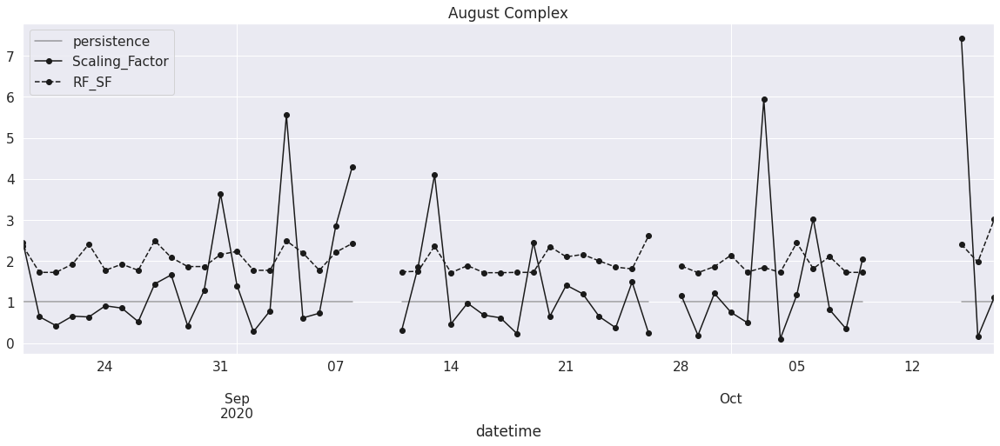

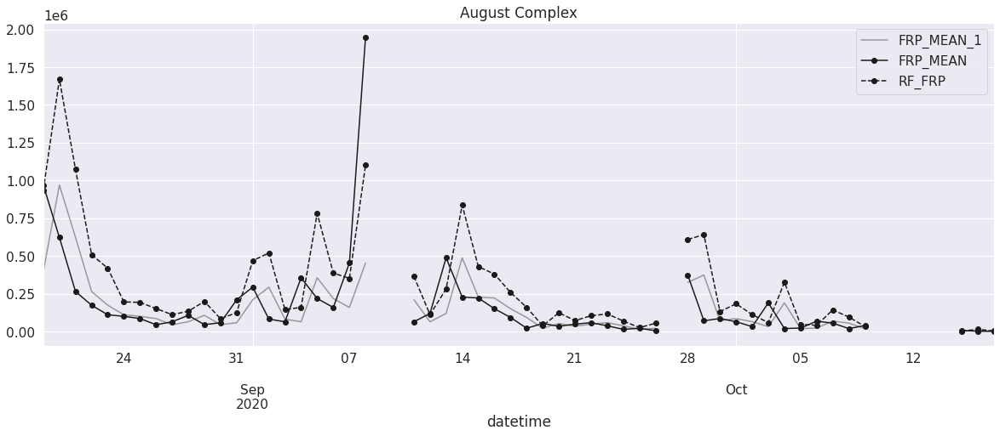

In [27]:
rf_sf = search.predict(data_test.loc[:,training_variables])
print(rf_sf)
data_test['RF_SF'] = rf_sf
data_test['RF_FRP'] = rf_sf*data_test['FRP_MEAN_1']
data_test_plot = data_test.set_index('datetime').resample('D').asfreq()

fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['Scaling_Factor', 'RF_SF'],style=['ko-', 'ko--'], ax=ax)
plt.title('August Complex')
plt.show()


fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['FRP_MEAN_1'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['FRP_MEAN', 'RF_FRP'],style=['ko-', 'ko--'], ax=ax)
plt.title('August Complex')
plt.show()

In [238]:
tscv = TimeSeriesSplit(n_splits=8)
data_train_sorted = data_train.sort_values(by='datetime').reset_index(drop=True)

rf = RandomForestRegressor(oob_score=True,n_estimators = 200, max_depth = 4, min_samples_leaf=5, random_state=42) #scaling is not necessary!

scores = cross_validate(rf, data_train_sorted.loc[:, training_variables], data_train_sorted.loc[:, ['Scaling_Factor']], cv=tscv,
                         scoring=('r2', 'neg_mean_squared_error', 'explained_variance', 'max_error', 'neg_mean_squared_log_error'),
                         return_train_score=True)

print(scores['test_neg_mean_squared_error'])v
print(scores['train_neg_mean_squared_error'])
print(scores['test_r2'])
print(scores['train_r2'])

#print(scores['test_explained_variance'])
#print(scores['test_max_error'])
#print(scores['test_neg_mean_squared_log_error'])

#print(cross_val_score(rf, data_train.loc[:, training_variables], data_train.loc[:, ['Scaling_Factor']], cv=tscv, scoring='r2'))
#print(cross_val_score(rf, data_train.loc[:, training_variables], data_train.loc[:, ['Scaling_Factor']], cv=tscv, scoring='neg_median_absolute_error'))


[-21.52715401 -13.45796496 -14.3550053   -6.9272443   -4.44772324
 -14.8889378  -15.31846379 -13.04613301]
[-14.40885646 -13.43317568 -11.26545053 -10.94011547  -9.98732707
  -8.96326476  -9.69927214 -10.08241138]
[-0.00566124 -0.20849459  0.09864172 -0.10274704 -0.23732812  0.07350254
 -0.02327038 -0.16055705]
[0.30540242 0.36463945 0.37451645 0.37493467 0.34727597 0.33329494
 0.29823529 0.27812397]


0.028937370738151502


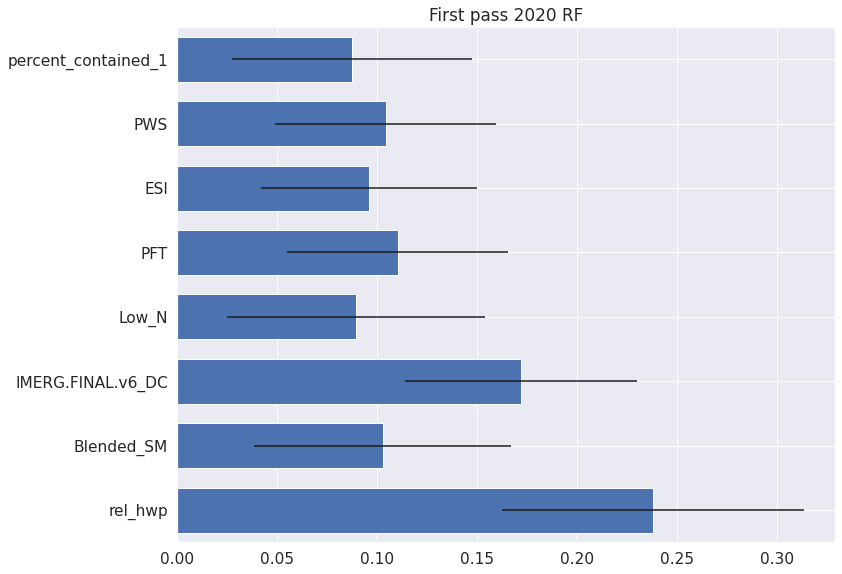

In [45]:
training_variables=['rel_hwp', 'Blended_SM',
                    'IMERG.FINAL.v6_DC',  'Low_N',
                    'PFT', 'ESI', 'PWS', 'percent_contained_1']

rf_log_sf = RandomForestRegressor(oob_score=True,min_samples_leaf=5, random_state=42) #scaling is not necessary!
#rf_log_sf.fit(data_train.loc[:, training_variables], data_train.loc[:, ['Log_Scaling_Factor']])
rf_log_sf.fit(data_train.loc[:, training_variables], data_train.loc[:, ['Scaling_Factor']])
print(rf_log_sf.oob_score_)
rf_sf = rf_log_sf.predict(data_test.loc[:,training_variables])

#data_test['Log_RF_SF'] = rf_sf
data_test['RF_SF'] = rf_sf
plot_importances(rf_log_sf, training_variables,'First pass 2020 RF')

In [51]:
np.log(2)

0.6931471805599453

[Text(0.5, 0, 'RF_SF_error')]

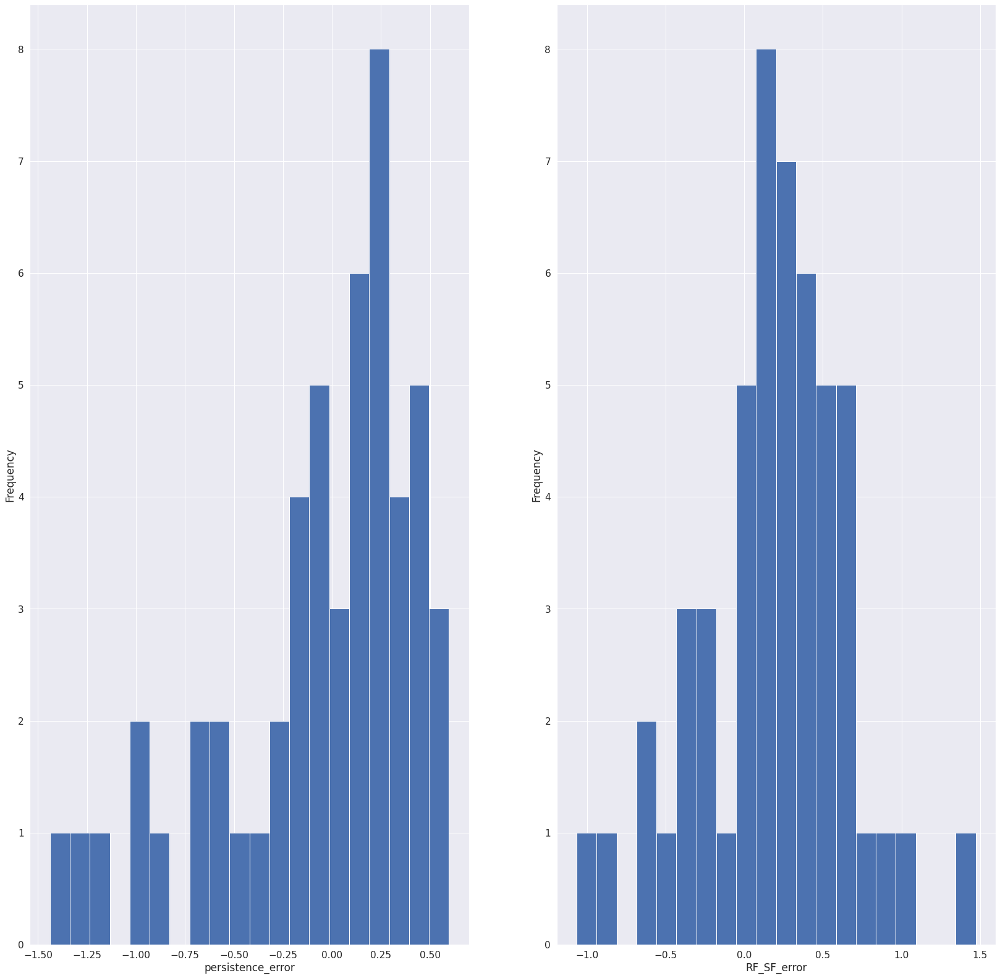

In [54]:
#hostogram of the error
data_test['persistence_error'] = np.log(data_test['persistence']+1)-np.log(data_test['Scaling_Factor']+1)
data_test['RF_SF_error'] = np.log(data_test['RF_SF']+1)-np.log(data_test['Scaling_Factor']+1)


fig, axs = plt.subplots(1,2, figsize=(28,28))

ax0 = data_test['persistence_error'].plot.hist(ax=axs[0], bins = 20)
ax0.set(xlabel='persistence_error')

ax1 = data_test['RF_SF_error'].plot.hist(ax=axs[1], bins = 20)
ax1.set(xlabel='RF_SF_error')

0.24267893956526482
0.25411444740450034
[3.84881196 0.44587814 0.64017455 2.19202212 2.2253738  0.95973394
 1.72983409 0.72813987 3.34695574 4.28158657 1.42416986 1.49472473
 2.72806289 1.87503981 0.5874209  1.16012562 2.46391381 1.61551837
 0.96078119 1.70155158 2.996311          nan        nan 0.91935656
 1.22387083 2.12639477 0.83482651 1.70659673 0.66093165 1.16356373
 0.79606014 0.77388824 3.38746091 1.2938871  1.7048116  2.05736377
 0.63672004 1.41307672 4.40841742        nan 1.31778796 0.59463988
 1.43134879 1.79728987 1.05690747 1.38920578 0.94519107 2.93792085
 1.67317994 1.85437678 1.06664973 0.9884968         nan        nan
        nan        nan        nan 2.51700445 1.66614978 3.50827462]


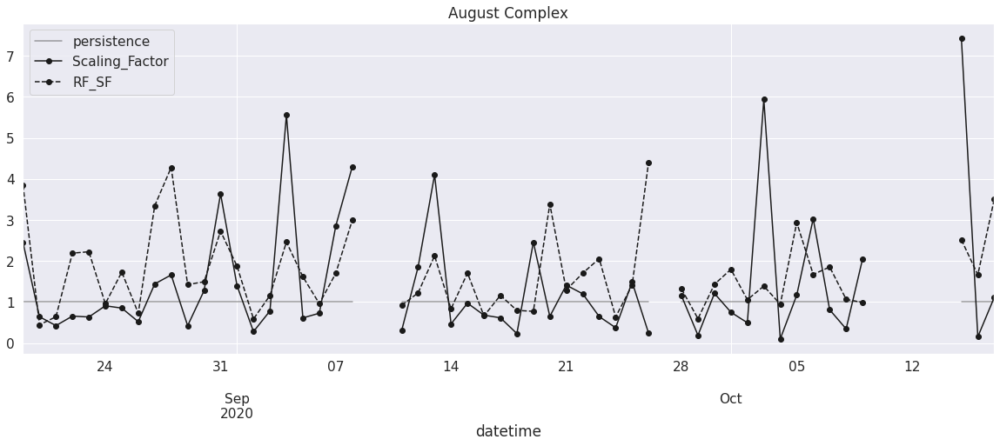

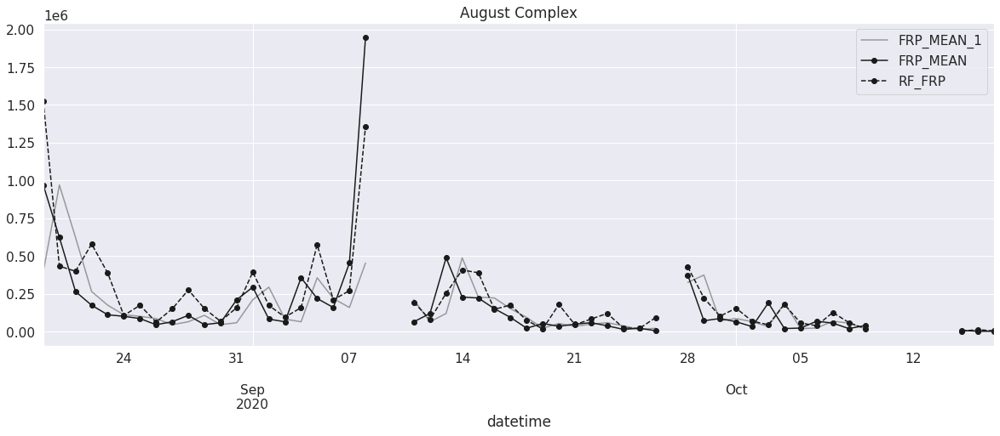

In [39]:
print(mean_squared_log_error(data_test['Scaling_Factor'], data_test['persistence']))
print(mean_squared_log_error(data_test['Scaling_Factor'], data_test['RF_SF']))



data_test_plot = data_test.set_index('datetime').resample('D').asfreq()
print(data_test_plot['RF_SF'].values)
data_test_plot['RF_FRP']= data_test_plot['RF_SF']*data_test_plot['FRP_MEAN_1']



#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['Scaling_Factor', 'RF_SF'],style=['ko-', 'ko--'], ax=ax)

plt.title('August Complex')
plt.show()

#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['FRP_MEAN_1'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['FRP_MEAN', 'RF_FRP'],style=['ko-', 'ko--'], ax=ax)
plt.title('August Complex')
plt.show()

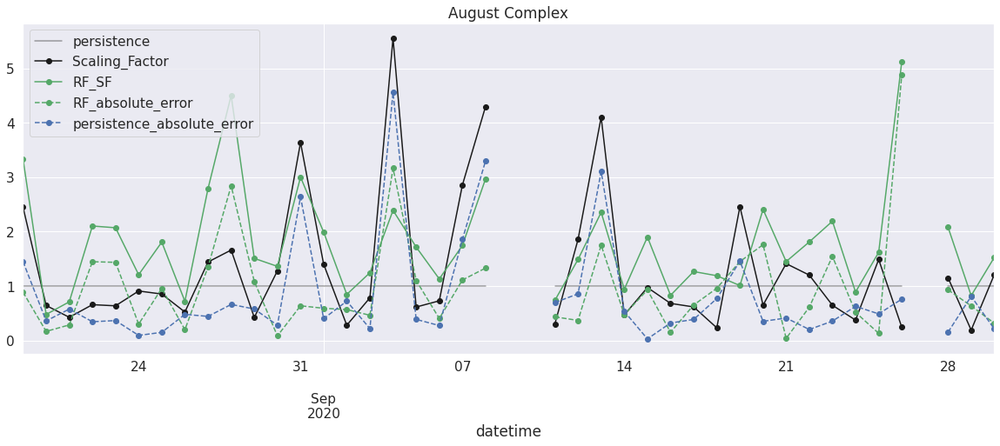

In [35]:
data_test['RF_absolute_error']=np.abs(data_test['RF_SF']-data_test['Scaling_Factor'])
data_test['persistence_absolute_error']= np.abs(data_test['persistence']-data_test['Scaling_Factor']).values

data_test_plot = data_test.set_index('datetime').resample('D').asfreq()

fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['Scaling_Factor', 'RF_SF'],style=['ko-', 'go-'], ax=ax)
data_test_plot.plot(y=['RF_absolute_error', 'persistence_absolute_error'],style=['go--', 'bo--'], ax=ax)

plt.title('August Complex')
plt.show()

In [190]:
def relative_root_mean_squared_error(true, pred): #from https://www.analyticsvidhya.com/blog/2021/10/evaluation-metric-for-regression-models/#h-pros-of-the-evaluation-metric
    num = np.mean(np.square(true - pred))
    den = np.sum(np.square(pred))
    squared_error = num/den
    rrmse_loss = np.sqrt(squared_error)
    return rrmse_loss

In [191]:
print(relative_root_mean_squared_error(data_test['RF_SF'], data_test['Scaling_Factor']))
print(relative_root_mean_squared_error(data_test['persistence'], data_test['Scaling_Factor']))

0.10411242541472714
0.10556789610760835


## Machine Learning, 2020 Only

In [41]:
#soil moisture (LEAVE OUT LIVING, NOT SURE WHAT TO DO!)
features_with_shifts['rel_Blended_SM'] = features_with_shifts['Blended_SM_1']/features_with_shifts['Blended_SM'] #flipped bc inverse relationship
features_with_shifts['rel_FMCG2D'] = features_with_shifts['FMCG2D_1']/features_with_shifts['FMCG2D'] #flipped bc inverse relationship
features_with_shifts['rel_DC'] = features_with_shifts['IMERG.FINAL.v6_DC']/features_with_shifts['IMERG.FINAL.v6_DC_1']
features_with_shifts['rel_DMC'] = features_with_shifts['IMERG.FINAL.v6_DMC']/features_with_shifts['IMERG.FINAL.v6_DMC_1']
features_with_shifts['rel_FFMC'] = features_with_shifts['IMERG.FINAL.v6_FFMC']/features_with_shifts['IMERG.FINAL.v6_FFMC_1']
features_with_shifts['rel_FMCGLH2D'] = features_with_shifts['FMCGLH2D']/features_with_shifts['FMCGLH2D_1']

#weather
features_with_shifts['rel_hwp'] = features_with_shifts['hwp']/features_with_shifts['hwp_1']
features_with_shifts['rel_hd0w0'] = features_with_shifts['hd0w0']/features_with_shifts['hd0w0_1']
features_with_shifts['rel_hd1w0'] = features_with_shifts['hd1w0']/features_with_shifts['hd1w0_1']
features_with_shifts['rel_hd2w0'] = features_with_shifts['hd2w0']/features_with_shifts['hd2w0_1']
features_with_shifts['rel_fwi'] = features_with_shifts['IMERG.FINAL.v6_FWI']/features_with_shifts['IMERG.FINAL.v6_FWI_1']

#fuel loading (flip because of negative correlation)
features_with_shifts['rel_Low_N'] = features_with_shifts['Low_N_1']/features_with_shifts['Low_N']
features_with_shifts['rel_Moderate_N'] = features_with_shifts['Moderate_N_1']/features_with_shifts['Moderate_N']
features_with_shifts['rel_High_N'] = features_with_shifts['High_N_1']/features_with_shifts['High_N']
features_with_shifts['rel_VeryHigh_N'] = features_with_shifts['VeryHigh_N_1']/features_with_shifts['VeryHigh_N']
features_with_shifts['rel_Extreme_N'] = features_with_shifts['Extreme_N_1']/features_with_shifts['Extreme_N']

#stability
features_with_shifts['rel_chi'] = features_with_shifts['chi']/features_with_shifts['chi_1']
features_with_shifts['rel_pft'] = features_with_shifts['PFT']/features_with_shifts['PFT_1']

#
features_with_shifts['rel_esi'] = features_with_shifts['ESI']/features_with_shifts['ESI_1']
features_with_shifts['rel_pws'] = features_with_shifts['PWS']/features_with_shifts['PWS_1']


In [42]:
#compare rel_* with Scaling_Factor, for the ones that ARE NOT OUTLIERS
features_with_shifts['persistence'] = np.ones(len(features_with_shifts))

methods_test = ['datetime', 'irwinID','persistence', 'rel_hwp', 'rel_hd0w0', 'rel_hd1w0','rel_hd2w0','rel_fwi',
                'rel_Blended_SM','rel_FMCG2D','rel_FMCGLH2D', 'rel_DC', 'rel_DMC', 'rel_FFMC',
                'rel_Low_N', 'rel_Moderate_N', 'rel_High_N', 'rel_VeryHigh_N','rel_Extreme_N',
                'rel_chi', 'rel_pft', 'rel_esi', 'rel_pws', 'percent_contained_1',
                'Scaling_Factor','FRP_MEAN', 'FRP_MEAN_1']
feat_validate = features_with_shifts[(~features_with_shifts['scaling_factor_is_outlier'])&
                                     (features_with_shifts['FRP_MEAN']>1000)].reset_index(drop=True) #drop the outliers and dead fires
feat_validate = feat_validate[methods_test].replace([np.inf, -np.inf], np.nan) #if scaling factor is infinity, GET RID
feat_validate= feat_validate.dropna(axis=0,how='any').reset_index(drop=True) #drop any because persistence will always be 0
feat_validate

,datetime,irwinID,persistence,rel_hwp,rel_hd0w0,rel_hd1w0,rel_hd2w0,rel_fwi,rel_Blended_SM,rel_FMCG2D,...,rel_VeryHigh_N,rel_Extreme_N,rel_chi,rel_pft,rel_esi,rel_pws,percent_contained_1,Scaling_Factor,FRP_MEAN,FRP_MEAN_1
0,2020-09-11,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,1.0,0.200852,0.600575,0.890380,1.137536,0.850910,1.111428,1.312757,...,1.037310,1.022818,0.805037,1.794887,1.425207,0.941437,0.0,0.183692,2706.065915,14731.512078
1,2020-09-12,00B3EDB2-87A4-4D0A-A834-4E1012BF9693,1.0,1.376032,0.881300,0.678199,0.865729,0.908600,1.104429,1.155124,...,0.987408,0.990905,1.041910,2.048905,1.099271,0.862781,10.0,0.498585,1349.205056,2706.065915
2,2020-08-26,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,0.887699,0.698707,0.794811,0.884147,0.975474,0.976846,0.983618,...,1.073089,1.075729,0.948460,0.304783,1.003647,0.958361,0.0,2.602551,6981.402969,2682.522659
3,2020-08-27,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,1.025795,1.548571,1.270577,1.419618,0.935564,0.998126,0.997138,...,1.798087,1.773448,0.971974,0.417942,1.017206,0.931493,0.0,0.627882,4383.497981,6981.402969
4,2020-08-28,013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2,1.0,1.351475,1.013856,1.048834,0.937868,0.946554,1.030301,1.016330,...,1.040011,1.040027,1.022262,33.570131,0.953451,1.041762,0.0,1.290980,5659.009813,4383.497981
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,2020-08-22,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,1.468930,0.914343,1.089611,0.966209,0.977291,0.892713,1.002203,...,1.106527,1.124388,0.995829,1.559838,0.955255,0.460892,50.0,1.494593,19220.669037,12860.137185
942,2020-08-23,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,0.640643,1.001714,0.867918,1.031399,1.103934,1.014151,0.979406,...,0.923173,0.886620,1.018846,1.307069,-0.965745,3.784856,60.0,0.117635,2261.014709,19220.669037
943,2020-08-24,FEF1C45E-C557-4934-87CC-06B12392FFFA,1.0,0.534733,1.001822,1.206874,1.048477,1.052613,1.087179,0.986400,...,0.912636,0.895006,0.877010,1.164952,0.834332,1.312618,70.0,0.619178,1399.971207,2261.014709
944,2020-07-14,FF0731C1-EC45-43FB-B0A7-9CDAECB282CD,1.0,0.634535,0.599699,0.600878,0.637360,0.762615,1.027366,1.069497,...,0.789436,0.786250,1.075911,1.023362,1.030101,0.956883,0.0,0.363427,1272.865791,3502.395985


In [43]:
data_test = feat_validate[feat_validate['irwinID']==ac['irwinID'].values[0][2:38]].reset_index(drop=True)
data_train = feat_validate[~(feat_validate['irwinID']==ac['irwinID'].values[0][2:38])].reset_index(drop=True)
print(data_train.columns)

Index(['datetime', 'irwinID', 'persistence', 'rel_hwp', 'rel_hd0w0',
       'rel_hd1w0', 'rel_hd2w0', 'rel_fwi', 'rel_Blended_SM', 'rel_FMCG2D',
       'rel_FMCGLH2D', 'rel_DC', 'rel_DMC', 'rel_FFMC', 'rel_Low_N',
       'rel_Moderate_N', 'rel_High_N', 'rel_VeryHigh_N', 'rel_Extreme_N',
       'rel_chi', 'rel_pft', 'rel_esi', 'rel_pws', 'percent_contained_1',
       'Scaling_Factor', 'FRP_MEAN', 'FRP_MEAN_1'],
      dtype='object')


0.06431855524886743


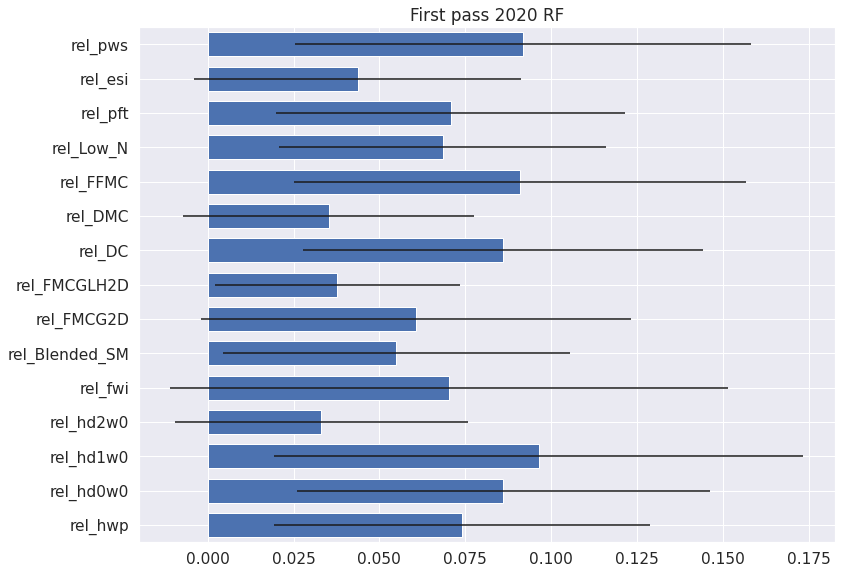

In [57]:
training_variables=['rel_hwp', 'rel_hd0w0',
                    'rel_hd1w0', 'rel_hd2w0', 'rel_fwi', 'rel_Blended_SM', 'rel_FMCG2D',
                    'rel_FMCGLH2D', 'rel_DC', 'rel_DMC', 'rel_FFMC', 'rel_Low_N',
                    'rel_pft', 'rel_esi', 'rel_pws']

rf = RandomForestRegressor(oob_score=True,min_samples_leaf=5, random_state=42) #scaling is not necessary!
rf.fit(data_train.loc[:, training_variables], data_train.loc[:, ['Scaling_Factor']])
print(rf.oob_score_)
rf_sf = rf.predict(data_test.loc[:,training_variables])

data_test['RF_SF'] = rf_sf

plot_importances(rf, training_variables,'First pass 2020 RF')

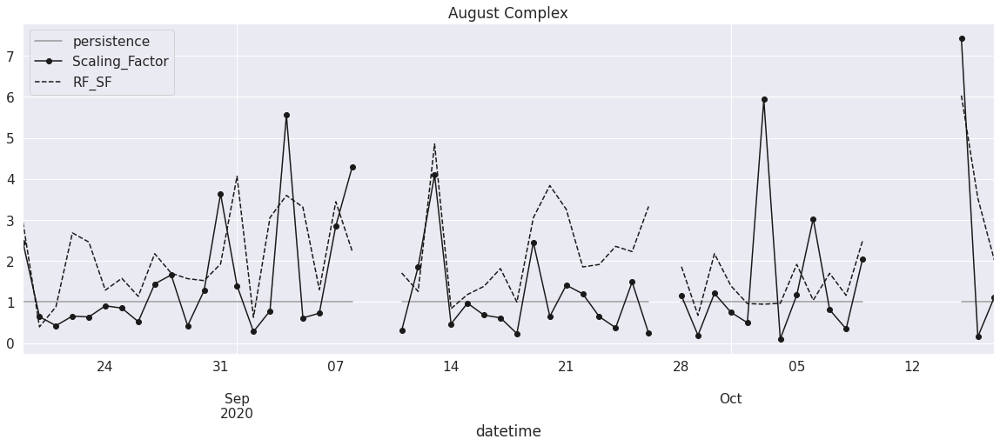

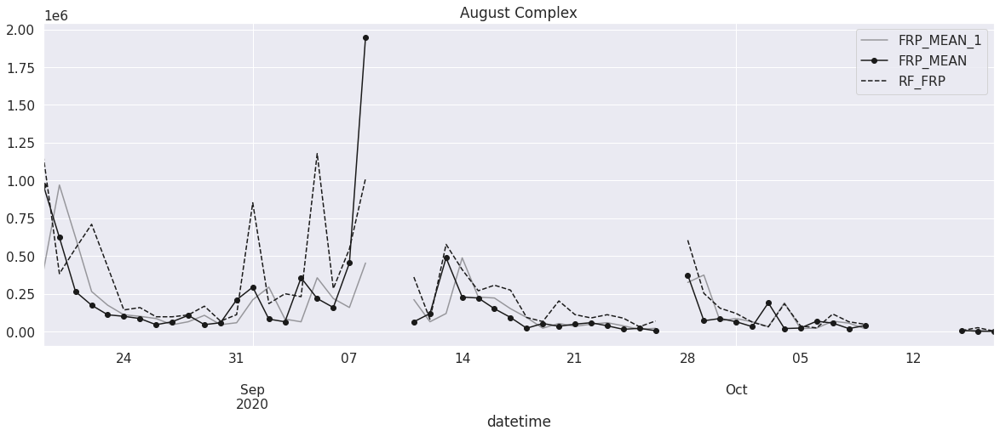

In [58]:
data_test_plot = data_test.set_index('datetime').resample('D').asfreq()
data_test_plot['RF_FRP'] = data_test_plot['RF_SF']*data_test_plot['FRP_MEAN_1']

#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['persistence'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['Scaling_Factor', 'RF_SF'],style=['ko-', 'k--'], ax=ax)
plt.title('August Complex')
plt.show()

#plot the scaling factors
fig, ax = plt.subplots(figsize=(20, 7))
data_test_plot.plot(y=['FRP_MEAN_1'],style=['k-'], alpha=0.4, ax=ax)
data_test_plot.plot(y=['FRP_MEAN', 'RF_FRP'],style=['ko-', 'k--'], ax=ax)
plt.title('August Complex')
plt.show()

In [59]:
methods_test=['persistence','RF_SF', 'Scaling_Factor']
#error metrics
print('AUC: ')
for name in methods_test: 
    print(name+': '+ str(AUC(REC(data_test[name], data_test['Scaling_Factor'])[1])))#/AUC(REC(feat_validate['Scaling_Factor'], feat_validate['Scaling_Factor'])[1])))


    
print()
print('MeAD: ')
for name in methods_test:
    print(name+': '+ str(MeAD(data_test[name], data_test['Scaling_Factor'])))
    
print()
print('median_percent_error: ')
for name in methods_test:
    print(name+': '+ str(median_percent_error(data_test[name], data_test['Scaling_Factor'])))
    
print()
print('mdrae: ')
for name in methods_test:
    print(name+': '+ str(mdrae(data_test['Scaling_Factor'], data_test[name], data_test['persistence'])))
    
    

AUC: 
persistence: 1897.5
RF_SF: 1874.6153846153848
Scaling_Factor: 2000.0

MeAD: 
persistence: 0.49612254086893015
RF_SF: 0.7595120149880484
Scaling_Factor: 0.0

median_percent_error: 
persistence: 58.26485343123136
RF_SF: 84.62066664523982
Scaling_Factor: 0.0

mdrae: 
persistence: 1.0
RF_SF: 1.8276601605119347
Scaling_Factor: 0.0


## Working with AC and WF Separately

In [ ]:
incidents_all = pd.read_csv('unique_fires_with_area_and_irwin_192021.csv')
ac = incidents_all[incidents_all['Fire Name']=='AUGUST COMPLEX']
print(ac)

wf = incidents_all[incidents_all['Fire Name']=='Williams Flats']
print(wf)

In [ ]:
features_to_shift = features.columns.values
features_shifted = []

for ii in range(len(features_to_shift)):
    features_shifted.append(features_to_shift[ii]+'_1')
    
features_ac = features.loc[ac['irwinID'].values[0][2:38]].reset_index()
features_ac = shift_ndays(features_ac, 1, features_to_shift, features_shifted, 'day') 

features_wf = features.loc[wf['irwinID'].values[0][2:38]].reset_index()
features_wf = shift_ndays(features_wf, 1, features_to_shift, features_shifted, 'day')


In [ ]:
#select the fires for AC and WF, get the relative stuff
features_to_shift = ['FRP_MEAN', 'hwp', 'hd0w0', 'hd1w0', 'hd2w0', 'hd3w0',
                     'PWS', 'ESI', 'chi', 'Blended_SM', 'FMCG2D', 'FMCGLH2D']
features_shifted = ['FRP_MEAN_1', 'hwp_1', 'hd0w0_1', 'hd1w0_1', 'hd2w0_1', 'hd3w0_1',
                     'PWS_1', 'ESI_1', 'chi_1', 'Blended_SM_1', 'FMCG2D_1', 'FMCGLH2D_1']

features_ac = features.loc[ac['irwinID'].values[0][2:38]].reset_index()
features_ac = shift_ndays(features_ac, 1, features_to_shift, features_shifted, 'day') 

features_wf = features.loc[wf['irwinID'].values[0][2:38]].reset_index()
features_wf = shift_ndays(features_wf, 1, features_to_shift, features_shifted, 'day')

In [ ]:
#get the relative stuff
features_wf['Scaling_Factor'] = features_wf['FRP_MEAN']/features_wf['FRP_MEAN_1']

#weather
features_wf['rel_hwp'] = features_wf['hwp']/features_wf['hwp_1']
features_wf['rel_hd1w0'] = features_wf['hd1w0']/features_wf['hd1w0_1']
features_wf['rel_fwi'] = features_wf['IMERG.FINAL.v6_FWI']/features_wf['IMERG.FINAL.v6_FWI_1']
fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],ax=ax)
features_wf.plot(y=['Scaling_Factor','rel_hwp', 'rel_hd1w0', 'rel_fwi'],style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats Weather')
plt.show()

#moisture
features_wf['rel_dmc'] = features_wf['IMERG.FINAL.v6_DMC']/features_wf['IMERG.FINAL.v6_DMC_1']
features_wf['rel_ffmc'] = features_wf['IMERG.FINAL.v6_FFMC']/features_wf['IMERG.FINAL.v6_FFMC_1']
fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],ax=ax)
features_wf.plot(y=['Scaling_Factor','rel_dmc', 'rel_ffmc'],style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats Weather')
plt.show()

#containment
features_wf['rel_cont'] = features_wf['percent_contained_1']/features_wf['percent_contained']
fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],ax=ax)
features_wf.plot(y=['Scaling_Factor','rel_cont'],style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats Weather')
plt.show()

#put it together
features_wf['rel_hwp_dmc'] = features_wf['rel_hwp']*features_wf['rel_ffmc']
fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],ax=ax)
features_wf.plot(y=['Scaling_Factor','rel_hwp_dmc'],style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats Weather')
plt.show()


In [ ]:
#the components of the scaling factor

"""fig, ax = plt.subplots(figsize=(15, 7))
features_ac.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(y=features_plot,style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()"""

fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],ax=ax)
features_wf.plot(y=['Scaling_Factor'], style=['m*-'], ax=ax, secondary_y=True)
features_wf.plot(y=relative_features,style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats')
plt.show()

In [ ]:
#the combined scaling factor
fig, ax = plt.subplots(figsize=(15, 7))
features_ac.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'], alpha=0.4, ax=ax)
features_ac.plot(y=['Scaling_Factor', 'rel_hwp_SM', 'rel_hd0w0_SM', 'rel_hwp_hd0w0_SM'],style='o-',ax=ax, secondary_y=True)
plt.title('August Complex')
plt.show()

fig, ax = plt.subplots(figsize=(15, 7))
features_wf.plot(y=['FRP_MEAN', 'FRP_MEAN_1'],style=['ko-', 'k--'],alpha=0.4,ax=ax)
features_wf.plot(y=['Scaling_Factor', 'rel_hwp_SM', 'rel_hd0w0_SM', 'rel_hwp_hd0w0_SM', 'rel_hwp_hd0w0_SM_PWS'],style='o-',ax=ax, secondary_y=True)
plt.title('Williams Flats')
plt.show()

# What does ncar moisture correlate with?
for 5/1 update

In [15]:
#check met variables, other moisture indices, weighted for now
smops_2020 = pd.read_csv('./fire_features_3/ClippedFires2020_Daily_SMOPS_Weighted_12Z_day_start.csv')
hdw_2020 = pd.read_csv('./fire_features_3/ClippedFires2020_Daily_HDW_Weighted_12Z_day_start.csv')
hwp_2020 = pd.read_csv('./fire_features_3/ClippedFires2020_Daily_HWP_Weighted_12Z_day_start.csv')
imerg_2020 = pd.read_csv('./fire_features_3/ClippedFires2020_Daily_IMERG_FWI_Weighted_12Z_day_start.csv')
print(len(smops_2020), len(hdw_2020), len(hwp_2020), len(imerg_2020))

ncar_2020 = pd.DataFrame()
esi_2020 = pd.DataFrame()

for i_d in np.unique(smops_2020['irwinID'].values):
    ncar_filename = './fire_features_ncar/'+i_d+'2020_Daily_ESI_Weighted_12Z_day_start.csv' #these say ESI but are ncar 
    esi_filename = './fire_features_esi/'+i_d+'2020_Daily_ESI_Weighted_12Z_day_start.csv' #these say ESI but are ncar 

    print(ncar_filename)
    ncar = pd.read_csv(ncar_filename)
    ncar_2020 = pd.concat([ncar_2020, ncar], axis=0).reset_index(drop=True)
    esi = pd.read_csv(esi_filename)
    esi_2020 = pd.concat([esi_2020, esi], axis=0).reset_index(drop=True)
    
print(ncar_2020)

2716 2716 2716 2716
./fire_features_ncar/00B3EDB2-87A4-4D0A-A834-4E1012BF96932020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E22020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/024CFE3D-2AA3-4BEC-BF99-7508B3B14C242020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/04156FA2-01E3-4146-97C3-28EB819CB0A82020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/07A2F787-CF35-46AB-92FB-EEA413392BE32020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/08906405-D2A2-478D-A367-32198983F7CC2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/0896AFFE-7839-40D4-BA6D-407F47E4CAA62020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/08BCEF87-391E-4AC7-941D-EF63D9D3A6C32020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/09509DA4-590D-43E2-A28B-035FC42DC19F2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/0A2BB376-060F-4A68-959A-25B146A7C1BD2020_Daily_ESI_Weighted_12Z_day_

./fire_features_ncar/69ED3328-E330-444C-BF8F-8C9331DEB64C2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6AC2092A-7E47-498A-84B6-616E1EB512D12020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6C390675-D0F6-4024-864A-28396E6084922020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6C72B1FE-3B0C-490D-9E6B-08B6490644D32020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6CB38B09-11A5-477A-9C23-7C5E98E649D72020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6D747835-0359-44A0-A49B-3B496C8D05C52020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6DF7C2F4-2246-4F81-BF7C-C5431EF0B6C02020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6E503FE1-3983-428E-A16F-79D4357763E72020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6EFE9623-9C43-46D4-9C88-07592BF24FE42020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/6F0ECD19-02D6-4987-A2A4-FEEDA94B35BD2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_fea

./fire_features_ncar/C99607D1-B1D4-4FE3-9B28-36C315AC43062020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/CBE91860-F520-4CF4-85C6-1B4D1AA9729B2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/CD8D2F6A-BA50-43CF-A62F-894091D839CC2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/CE5ECF50-12B5-4E25-BE41-A887EEF8DAC52020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D0D17250-64E5-4961-A1DC-42986547C3FF2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D0EDA9DD-DBD8-4918-A713-415F43630ADC2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D1A5A79C-0354-4C70-83EA-9A0F374888502020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D29D288D-F7E6-476D-934A-2BAEDCEBE17D2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D3F5D9A5-75C8-4650-87CD-9C3E1051802D2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_features_ncar/D3F77FA8-4D3C-4531-B63F-BC5A8C078C7F2020_Daily_ESI_Weighted_12Z_day_start.csv
./fire_fea

In [ ]:
#merge SM and ncar on day and irwinid
smops_2020_multiindex = smops_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
ncar_2020_multiindex = ncar_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
hdw_2020_multiindex = hdw_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
hwp_2020_multiindex = hwp_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
imerg_2020_multiindex = imerg_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
esi_2020_multiindex = esi_2020.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')

features_2020 = pd.merge(smops_2020_multiindex, ncar_2020_multiindex, how='inner', on=['irwinID', 'day'])
features_2020 = pd.merge(features_2020, hdw_2020_multiindex, how='inner', on=['irwinID', 'day'])
features_2020 = pd.merge(features_2020, hwp_2020_multiindex, how='inner', on=['irwinID', 'day'])
features_2020 = pd.merge(features_2020, imerg_2020_multiindex, how='inner', on=['irwinID', 'day'])
features_2020 = pd.merge(features_2020, esi_2020_multiindex, how='inner', on=['irwinID', 'day'])

print(features_2020)

In [ ]:
#plot them to see the correlation
plot_correlations(features_2020, '2020 All Fires pearson','pearson')
plot_correlations(features_2020, '2020 All Fires spearman','spearman')
plot_correlations(features_2020, '2020 All Fires kendall','kendall')


scatter_plot(features_2020,'hd0w0','FMCG2D',None, None, None, None,'plot_title')


                                                 Blended_SM    FMCG2D  \
irwinID                              day                                
026F0FC5-D38C-4F7B-928A-59F37BE81BAA 2019-08-01     0.22740  0.059780   
                                     2019-08-02     0.20560  0.056038   
                                     2019-08-03     0.24140  0.061420   
                                     2019-08-04     0.23560  0.076953   
                                     2019-08-05     0.22670  0.080751   
...                                                     ...       ...   
FF65A04D-419D-4791-BAA4-FBBAB29AA03F 2020-11-05     0.20638  0.075635   
                                     2020-11-06     0.18240  0.068559   
FFCB89F5-98FB-4C3A-9554-3D1554181A63 2020-09-16     0.09940  0.041455   
                                     2020-09-17     0.15460  0.049294   
                                     2020-09-18     0.14030  0.049588   

                                                 F

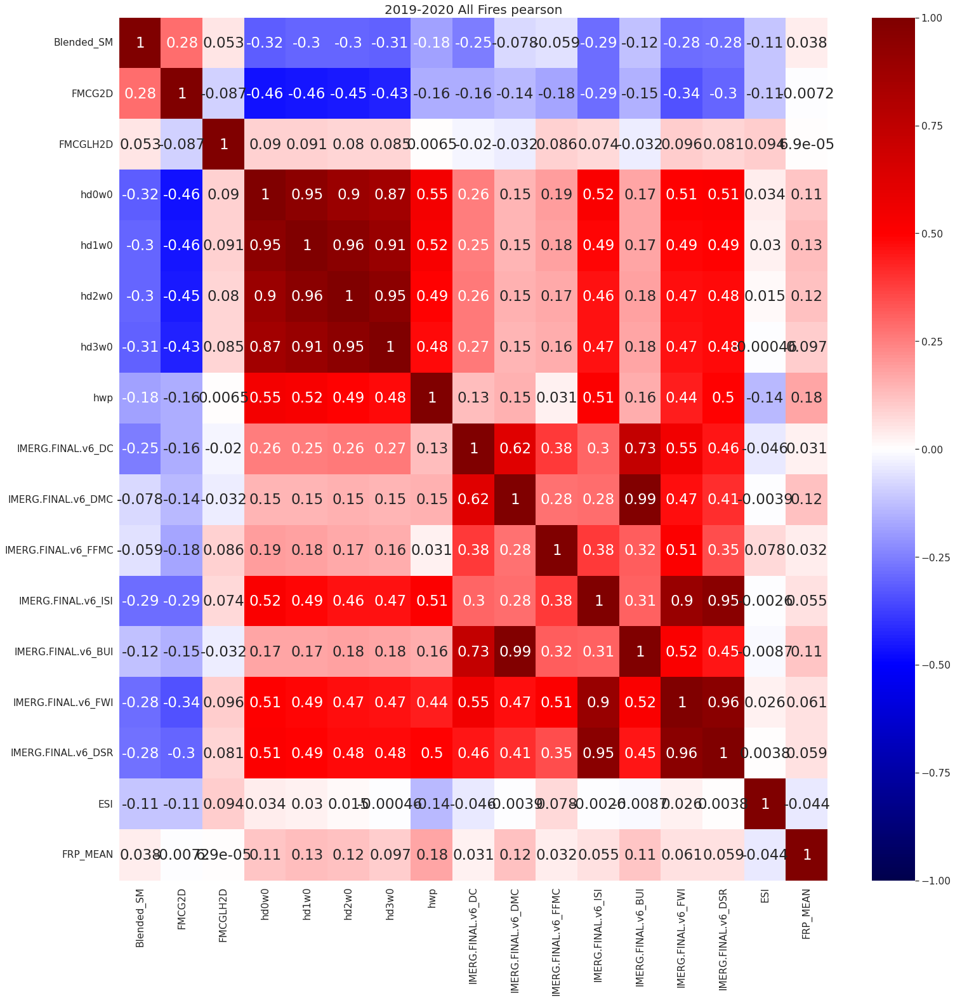

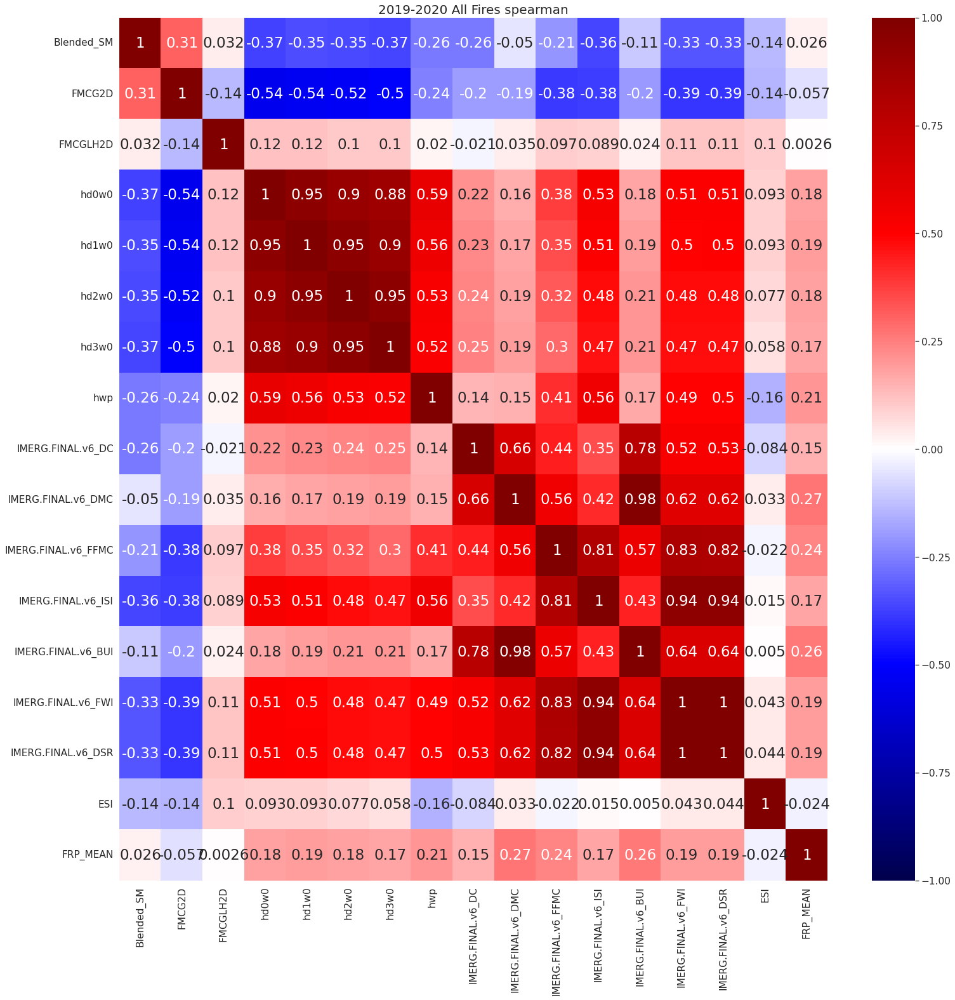

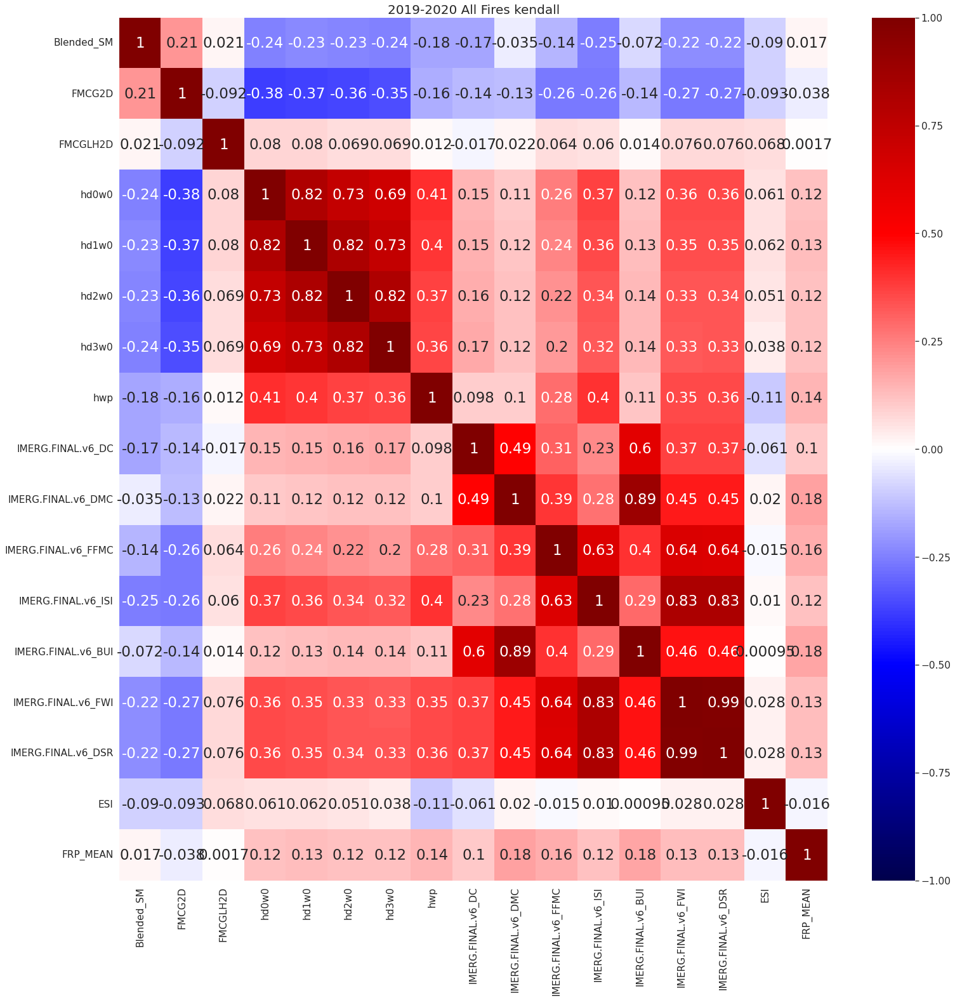

In [19]:
#check met variables, other moisture indices, weighted for now
smops = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_SMOPS_Weighted_12Z_day_start.csv', [2019, 2020])
hdw = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HDW_Weighted_12Z_day_start.csv', [2019, 2020])
hwp =combine_years('./fire_features_3/ClippedFiresYYYY_Daily_HWP_Weighted_12Z_day_start.csv', [2019, 2020])
imerg = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_IMERG_FWI_Weighted_12Z_day_start.csv', [2019, 2020])
rave = combine_years('./fire_features_3/ClippedFiresYYYY_Daily_RAVE_Unweighted_12Z_day_start.csv', [2019, 2020])

ncar = combine_per_fire_csv(np.unique(smops['irwinID'].values),   
                            './fire_features_ncar/','Weighted')

esi = combine_per_fire_csv(np.unique(smops['irwinID'].values), 
                            './fire_features_esi/', 'Weighted')

#merge SM and ncar on day and irwinid
smops_multiindex = smops.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
ncar_multiindex = ncar.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
hdw_multiindex = hdw.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
hwp_multiindex = hwp.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
imerg_multiindex = imerg.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
esi_multiindex = esi.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')
rave_multiindex = rave.set_index(['irwinID', 'day']).drop(columns='Unnamed: 0')

features = pd.merge(smops_multiindex, ncar_multiindex, how='inner', on=['irwinID', 'day'])
features = pd.merge(features, hdw_multiindex, how='inner', on=['irwinID', 'day'])
features = pd.merge(features, hwp_multiindex, how='inner', on=['irwinID', 'day'])
features = pd.merge(features, imerg_multiindex, how='inner', on=['irwinID', 'day'])
features = pd.merge(features, esi_multiindex, how='inner', on=['irwinID', 'day'])
features = pd.merge(features, rave_multiindex, how='inner', on=['irwinID', 'day'])

print(features)

#plot them to see the correlation
plot_correlations(features, '2019-2020 All Fires pearson','pearson')
plot_correlations(features, '2019-2020 All Fires spearman','spearman')
plot_correlations(features, '2019-2020 All Fires kendall','kendall')


#scatter_plot(features,'hd0w0','FMCG2D',None, None, None, None,'plot_title')


# What does the distribution of daily total FRP look like for the two years we have?
This was shown 4/17/2023 update

In [ ]:
#combine the two years of training RAVE that we have
rave_2019 = pd.read_csv('./fire_features_3/ClippedFires2019_Daily_RAVE_Unweighted_12Z_day_start.csv')
rave_2020 = pd.read_csv('./fire_features_3/ClippedFires2020_Daily_RAVE_Unweighted_12Z_day_start.csv')

rave= pd.concat([rave_2019, rave_2020], axis=0).reset_index(drop=True)
print(np.max(rave['FRP_MEAN'].values))

print(len(np.unique(rave['irwinID'])), len(np.unique(rave_2019['irwinID'])), len(np.unique(rave_2020['irwinID'])))

ids = np.unique(rave['irwinID'])

#get the yesterday FRPs
rave_all = pd.DataFrame()
for i_d in ids:
    rave_fire = rave[rave['irwinID']==i_d]
    rave_fire_shifted = shift_ndays(rave_fire,1, ['FRP_MEAN'], ['Yesterday_FRP'],'day') #this is daily, contains nans
    #print(rave_fire_shifted[['FRP_MEAN', 'Yesterday_FRP']])
    #rave_fire_shifted = rave_fire_shifted[~rave_fire_shifted['FRP_MEAN'].isna()]
    rave_fire_shifted['day of fire from 0'] = np.arange((len(rave_fire_shifted)))

    rave_all = pd.concat([rave_all, rave_fire_shifted], axis=0).reset_index(drop=True)

#some other options for trget variables
rave_all['SCALING_FACTOR'] = rave_all['FRP_MEAN']/rave_all['Yesterday_FRP']
rave_all['LOG_FRP_MEAN'] = np.log10(rave_all['FRP_MEAN'])
rave_all['LOG_SCALING_FACTOR'] = np.log10(rave_all['SCALING_FACTOR'])


#replace infs with nans
rave_all.replace([np.inf, -np.inf], np.nan, inplace=True)

print(rave_all.head())
print(len(rave_all))

In [ ]:
#this was used to check if there was an issue with the original RAVE calc for all polygons.
# we found that we were doing weighting, oops!
#clipped_polys= gpd.read_file('./fire_polygons/ClippedFires2020_VIIRS_daily_12Z_Day_Start.geojson')
#print(clipped_polys[clipped_polys['Fire Name']=='AUGUST COMPLEX'])

ac = rave[rave['irwinID']=='EE343B88-0ADB-4C25-B744-6B4CE9DCC6DA']
print(ac)
ac.plot(x='day',y='FRP_MEAN')

In [ ]:
fig, axs = plt.subplots(2,2, figsize=(28,28))

ax0 = rave_all['FRP_MEAN'].plot.hist(ax=axs[0,0], bins = 20)
ax0.set(xlabel='FRP_MEAN')

ax1 = rave_all['LOG_FRP_MEAN'].plot.hist(ax=axs[0,1], bins = 20)
ax1.set(xlabel='LOG_FRP_MEAN')

ax2 = rave_all['SCALING_FACTOR'].plot.hist(ax=axs[1,0], bins = 20)
ax2.set(xlabel='SCALING_FACTOR')

ax3 = rave_all['LOG_SCALING_FACTOR'].plot.hist(ax=axs[1,1], bins = 20)
ax3.set(xlabel='LOG_SCALING_FACTOR')

plt.show()

# Which scaling factors do we want to keep

In [ ]:
print(rave_all[rave_all['SCALING_FACTOR']==np.max(rave_all['SCALING_FACTOR'])])
print(np.mean(rave_all['FRP_MEAN']), np.median(rave_all['FRP_MEAN']))

scatter_plot(rave_all,'Yesterday_FRP','FRP_MEAN','SCALING_FACTOR', None, 'SCALING_FACTOR', (50,250),'Which Scaling Factors to Cut?')


rave_all.iloc[3990:3995]

In [ ]:
print(rave_all[rave_all['irwinID']=='1AA854A7-3969-4969-9413-950CF0C2DFB6'])

In [ ]:
#get rid of that outlier

rave_all_filtered = rave_all[rave_all['SCALING_FACTOR']<15000].reset_index(drop=True)
print(rave_all_filtered[rave_all_filtered['SCALING_FACTOR']==np.max(rave_all_filtered['SCALING_FACTOR'])])
print(np.mean(rave_all_filtered['FRP_MEAN']), np.median(rave_all_filtered['FRP_MEAN']))

scatter_plot(rave_all_filtered,'Yesterday_FRP','FRP_MEAN','SCALING_FACTOR', None, 'SCALING_FACTOR', (50,250),'Which Scaling Factors to Cut?')


rave_all_filtered[rave_all_filtered['SCALING_FACTOR']>100]

#rave_all_filtered.loc[143:149]

In [ ]:
#get the IQR and outliers
rave_all.head()

quantiles = rave_all['LOG_SCALING_FACTOR'].quantile(q=[.25, .5, .75])
print(quantiles)
iqr = quantiles[0.75]-quantiles[0.25]
print('IQR: ' + str(iqr))

lower_fence = quantiles[0.50]-(1.5*iqr)
upper_fence = quantiles[0.50]+(1.5*iqr)
print('Lower and upper fences are: '+ str(lower_fence) + ', '+ str(upper_fence))

outliers = rave_all[(rave_all['LOG_SCALING_FACTOR']<=lower_fence)| (rave_all['LOG_SCALING_FACTOR']>=upper_fence)]
kept_points = rave_all[(rave_all['LOG_SCALING_FACTOR']>=lower_fence)&(rave_all['LOG_SCALING_FACTOR']<=upper_fence)]




In [ ]:
fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =outliers, x='Yesterday_FRP',y='FRP_MEAN',hue='LOG_SCALING_FACTOR',
                    style=None,sizes=(50,250),ax=ax, palette='vlag')

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('outliers')
plt.show()

fig,ax=plt.subplots(figsize=(10,10))
sns.scatterplot(data =kept_points, x='Yesterday_FRP',y='FRP_MEAN',hue='LOG_SCALING_FACTOR',
                    style=None,sizes=(50,250),ax=ax, palette='vlag')

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Keep')
plt.show()

# Make a  few plots

In [ ]:
fire_incidents = ['204 COW', 'GRANITE GULCH', 'SHADY', 'WILLIAMS FLATS', 'PEDRO MOUNTAIN', 'WALKER',
                  'AUGUST COMPLEX', 'BOBCAT', 'CAMERON PEAK', 'CREEK', 'DOLAN', 'EAST TROUBLESOME',
                  'HOLIDAY FARM', 'LAKE','RIVERSIDE', 'PINE GULCH', 'CZU', 'SCU']
#fire_incidents=['PEDRO MOUNTAIN']
feat = combine_fires(fire_incidents) #this has some nans in it, based on how I resampled to daily
print(feat)
feat_noinf = feat.iloc[np.where(feat['rel_FRP'].values<100)]
#print(feat_nonan)

In [ ]:
#distributions of possible target variables
fig, axs = plt.subplots(nrows=1, ncols=3,figsize=(21,7))
feat_noinf['FRP_MEAN'].plot.hist(bins=20, ax=axs[0])
axs[0].set_title('Daily Total FRP')

feat_noinf['FRP_log'].plot.hist(bins=20, ax=axs[1])
axs[1].set_title('Log of Daily Total FRP')

feat_noinf['rel_FRP'].plot.hist(bins=20, ax=axs[2])
axs[2].set_title('Daily Relative Change in FRP')

plt.show()

In [ ]:
#line plots
for ii in range(len(fire_incidents)):
    fire_plot = resample_daily(feat[feat['name']==fire_incidents[ii]], 'datetime')
    fig, ax = plt.subplots(figsize=(20,15)) 
    fire_plot.plot(x='datetime',y=['rel_FRP'],
                            figsize=(20,6),style='o-',ax=ax)
    fire_plot.plot(x='datetime',y=['Yesterday_FRP'],
                            figsize=(20,6),style='k--',ax=ax, secondary_y=True)
    fire_plot.plot(x='datetime',y=['FRP_MEAN'],
                            figsize=(20,6),style='ko-',ax=ax, secondary_y=True)
    plt.title(fire_incidents[ii])

In [ ]:
#correlation
plot_correlations(feat[['hd0w0','hd1w0','hd2w0','hd3w0', 'hwp', 'IMERG.FINAL.v6_FWI', 'FRP_MEAN']], 
                  'All Fires 19/20 Weather','pearson')

plot_correlations(feat[['Blended_SM', 'IMERG.FINAL.v6_FFMC', 'IMERG.FINAL.v6_DMC', 'IMERG.FINAL.v6_DC', 'FRP_MEAN']], 
                  'All Fires 19/20 Soil Moisture','pearson')

plot_correlations(feat[['Extreme_N', 'VeryHigh_N', 'High_N', 'Moderate_N','Low_N', 'FRP_MEAN']], 
                  'All Fires 19/20 Fuel Loading','pearson')

plot_correlations(feat[['PWS', 'ESI', 'FRP_MEAN']], 
                  'All Fires 19/20 Fuel Moisture Sensitivity','pearson')

plot_correlations(feat[['PFT', 'chi','FRP_MEAN']], 
                  'All Fires 19/20 Stability','pearson')

# Test Shifting by one day with the full dataset

In [ ]:
rave = pd.read_csv('./fire_features_3/ClippedFires2019_Daily_RAVE_Unweighted_12Z_day_start.csv')
print(rave.head())

rave_daily = shift_ndays(rave,1, ['FRP_MEAN'], ['Yesterday_FRP'],'day')